<a href="https://colab.research.google.com/github/fabiopernisi/HypoxiaClassification/blob/main/AILAB_final_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AILAB final notebook GROUP 2

Matteo Nulli, Lorenzo Tarricone, Yaraslau Ivashynka, Karim Ahmed Abdel Sadek, Fabio Pernisi, Joel Kim

#Heuristic and setting of our experiment

**Why cancer and genome?**

Studying the correlation between cancer and human genome is a difficult thing because the gene expression of cancer cells has an high variability among people and among the cells of the single person. Moreover, there can be many mutations developing over the time. If we want to understand and cure cancer cells it is crucial to study interactions between them and their neighbors (to see how cancer cells are escaping the T-cells, for example). Because of that we can't limit ourselfs to the study of the DNA, but we need to study the RNA since it is the "instruction list" that guides the cell behaviour/methabolism.

**Why is it important to study hypoxia?** 

Cancer cells are excessively grown up cells that refuse to die committing a "controlled suicide" (*apoptosis*) and instead continue to grow in your body. To do that they'll need more oxigen than the normal cells and in the regions with large metastasis the blood vassels will not be able to keep up whith the cancer cells request of oxigen. The result is that cancer cells, about to die "against their will", will end up expressing abnormal genes (to encode a metabolic reaction to survive these extreme coditions) that eventually will lead them to become much more aggressive and difficult to treat.
Our question now is: can we identify apoxic cells? If we could understand how they react we could better treat cancer!

**How is the experiment designed?**

In our experiemnt we grow some cells in two different environments, one whith normal levels of oxigen (21%) and others with reduced levels of oxigen (1%) of oxigen. We then sequenced every single cell (Single-Cell RNA sequencing using the Smart-Seq and the Drop-Seq methods). Our target is starting from data to build a good predictor that given the gene expression of a celll will tell if this last was living in an hypoxic or normal environment. Both these two sequecing techniques were applied to two different cell lines, called HCC1086 and MCF7. The first one is a type of liver cancer and the second one is breast cancer.

**How are the data structured?**

The data provided to us were given in the format of .csv table. Every column represents a single cell sequenced (so an observetion), identified with a precise name containig informations about which of the two treatment conditions it grew up in (hypoxia or normoxia) and in case of Smarseq also its position on the plate of colture. Every row represents a single gene (so a feature), identified with its official gene symbol. Each entry of the table represents the gene expression count in case of SmartSeq sequenced cells and the Unique Molecular Identifier count (UMI) in case of DropSeq sequenced cells.

**How will we proceed with these data?**
We will analyse all the four tables given to us using a pretty standard Differential Gene Expression study pipeline that will include the following:

- Exploratory data analysis and Data cleaning
- Quality Control and Nomralization
- Feature selection and Higly Variable Genes study
- Dimensionality Reduction and Clustering 
- Supervised learning: Tree based methods and Deep Neural Networks
- BONUS: Heuristics on Enrichment Analysis and Ontology Analysis

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Python libraries

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
%matplotlib inline

## Defining functions

In [ ]:
def get_condition_list(X, condition):
  names = X.columns.values
  l_condition = []
  for i in range(len(names)):
      if condition in names[i]:
          l_condition.append(i)
      else:
          continue
  return l_condition

In [ ]:
def plot_data(X):
    plt.plot(X[:, 0], X[:, 1], 'k.', markersize=2)

def plot_centroids(centroids, weights=None, circle_color='w', cross_color='k'):
    if weights is not None:
        centroids = centroids[weights > weights.max() / 10]
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='o', s=35, linewidths=8,
                color=circle_color, zorder=10, alpha=0.9)
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='x', s=2, linewidths=12,
                color=cross_color, zorder=11, alpha=1)

def plot_decision_boundaries(clusterer, X, resolution=1000, show_centroids=True,
                             show_xlabels=True, show_ylabels=True):
    mins = X.min(axis=0) - 0.1
    maxs = X.max(axis=0) + 0.1
    xx, yy = np.meshgrid(np.linspace(mins[0], maxs[0], resolution),
                         np.linspace(mins[1], maxs[1], resolution))
    Z = clusterer.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    plt.contourf(Z, extent=(mins[0], maxs[0], mins[1], maxs[1]),
                cmap="Pastel2")
    plt.contour(Z, extent=(mins[0], maxs[0], mins[1], maxs[1]),
                linewidths=1, colors='k')
    plot_data(X)
    #if clusterer == GaussianMixture:
    if show_centroids:
        plot_centroids(clusterer.cluster_centers_)

    if show_xlabels:
        plt.xlabel("$x_1$", fontsize=14)
    else:
        plt.tick_params(labelbottom=False)
    if show_ylabels:
        plt.ylabel("$x_2$", fontsize=14, rotation=0)
    else:
        plt.tick_params(labelleft=False)

In [ ]:
from matplotlib.colors import LogNorm

def plot_gaussian_mixture(clusterer, X, resolution=1000, show_ylabels=True):
    mins = X.min(axis=0) - 0.1
    maxs = X.max(axis=0) + 0.1
    xx, yy = np.meshgrid(np.linspace(mins[0], maxs[0], resolution),
                         np.linspace(mins[1], maxs[1], resolution))
    Z = -clusterer.score_samples(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    plt.contourf(xx, yy, Z,
                 norm=LogNorm(vmin=1.0, vmax=30.0),
                 levels=np.logspace(0, 2, 12))
    plt.contour(xx, yy, Z,
                norm=LogNorm(vmin=1.0, vmax=30.0),
                levels=np.logspace(0, 2, 12),
                linewidths=1, colors='k')

    Z = clusterer.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    plt.contour(xx, yy, Z,
                linewidths=2, colors='r', linestyles='dashed')
    
    plt.plot(X[:, 0], X[:, 1], 'k.', markersize=2)
    plot_centroids(clusterer.means_, clusterer.weights_)

    plt.xlabel("$x_1$", fontsize=14)
    if show_ylabels:
        plt.ylabel("$x_2$", fontsize=14, rotation=0)
    else:
        plt.tick_params(labelleft=False)

In [ ]:
from scipy.cluster.hierarchy import dendrogram

def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

# **SmartSeq**

## MCF7

### Exploratory data analysis and Data cleaning 


We start by loading the necessary libraries and load the first two datasets from our drive. Please notice that you'll need to change it, in order to match it with the path to the file on your local machine.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns
import random

In [ ]:
unfilt = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_Unfiltered_Data.txt', delimiter = " ", index_col = 0)
meta = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_MetaData.tsv', delimiter = "\t", index_col = 0)

We now see how the data is stored in these tables, looking at the first entries:

The first showed is the meta file, containing useful informations about the experiment, in particular the column `Condition` indicates the condition in which the cell grew up.



In [ ]:
meta

,Cell Line,Lane,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A10,Hypo,72,S28,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A11,Hypo,72,S29,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A12,Hypo,72,S30,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A1,Norm,72,S1,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A2,Norm,72,S2,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
...,...,...,...,...,...,...,...,...
output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H5,Norm,72,S359,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H6,Norm,72,S360,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.4,H7,Hypo,72,S379,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


The second is the actual table containig the read counts as described above

In [ ]:
print("The dimension of this dataset is:", unfilt.shape,"\n")
unfilt

The dimension of this dataset is: (22934, 383) 



,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_A7_Hypo_S25_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H2_Norm_S356_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1
MIR6859-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WASH9P,1,0,0,0,0,1,10,1,0,0,...,1,1,0,0,0,0,1,1,4,5
OR4F29,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
MTND1P23,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,4,0,0,0,3,3,0,0,14,1,...,0,4,12,4,0,1,6,0,7,4
MT-CYB,270,1,76,66,727,2717,9326,3253,7949,30,...,239,3795,12761,2263,1368,570,3477,349,2184,1149
MT-TT,0,0,0,0,0,1,1,1,4,0,...,0,7,4,2,0,0,3,0,2,2
MT-TP,5,0,0,1,0,1,1,4,2,0,...,0,14,56,11,2,0,7,2,28,11


We can first check if the data type is always the same across the features in the dataframe

In [ ]:
assert [unfilt.T.dtypes[i] == 'int64' for i in range(len(unfilt.dtypes))]
#And this is the case

First of all we want to see if there'are some missing value in the dataset. This is a standard operation that we want to do on a dataset, because if there are some missing entries we will have to deal with them somehow

In [ ]:
unfilt.isnull().sum(axis = 1).sum(axis = 0)
#Luckly enough there are not :)

0

Another standard procedure is the one to look for duplicate values among the features in our table. As pointed out in the suggestion notebook this could be due to many reasons: redundancy in gene annotation, overlapping of gene annotation on the same region, etc...

In [ ]:
dup_rows_unfilt = unfilt[unfilt.duplicated(keep=False)]
print("The number of duplicate rows is", dup_rows_unfilt.shape[0])

The number of duplicate rows is 56


Yes, we have duplicate rows. Our task now will be first to understand which line is equal to which other line(s) in the data. To do that we can simply start by building a correlation matrix of these duplicate genes. 

In [ ]:
dup_rows_corr = dup_rows_unfilt.T.corr()
dup_rows_corr

,SHISAL2A,IL12RB2,S1PR1,CD84,GNLY,FAR2P3,KLF2P3,PABPC1P2,UGT1A8,UGT1A9,...,BCL6B,CCL3L3,CCL3L1,OTOP3,RNA5SP450,PSG1,MIR3190,MIR3191,SEZ6L,ADAMTS5
SHISAL2A,1.000000,0.630630,0.654887,0.312826,0.497375,-0.008333,-0.008333,0.497375,-0.009322,-0.009322,...,0.497375,-0.007615,-0.007615,0.134926,-0.005249,0.497375,-0.005249,-0.005249,0.112487,0.630630
IL12RB2,0.630630,1.000000,0.829681,0.799056,0.630630,-0.007903,-0.007903,0.948434,-0.008841,-0.008841,...,0.630630,-0.007222,-0.007222,0.612365,-0.004979,0.630630,-0.004979,-0.004979,0.586533,0.799056
S1PR1,0.654887,0.829681,1.000000,0.412553,0.654887,-0.007656,-0.007656,0.654887,-0.008565,-0.008565,...,0.654887,-0.006996,-0.006996,0.178813,-0.004823,0.654887,-0.004823,-0.004823,0.149322,0.829681
CD84,0.312826,0.799056,0.412553,1.000000,0.312826,-0.007903,-0.007903,0.948434,-0.008841,-0.008841,...,0.312826,-0.007222,-0.007222,0.964653,-0.004979,0.312826,-0.004979,-0.004979,0.955646,0.397167
GNLY,0.497375,0.630630,0.654887,0.312826,1.000000,-0.008333,-0.008333,0.497375,-0.009322,-0.009322,...,1.000000,0.021357,0.021357,0.134926,-0.005249,0.497375,-0.005249,-0.005249,0.112487,0.948434
FAR2P3,-0.008333,-0.007903,-0.007656,-0.007903,-0.008333,1.000000,1.000000,-0.008333,-0.014798,-0.014798,...,-0.008333,-0.012088,-0.012088,-0.006928,-0.008333,-0.008333,-0.008333,-0.008333,-0.006775,-0.007903
KLF2P3,-0.008333,-0.007903,-0.007656,-0.007903,-0.008333,1.000000,1.000000,-0.008333,-0.014798,-0.014798,...,-0.008333,-0.012088,-0.012088,-0.006928,-0.008333,-0.008333,-0.008333,-0.008333,-0.006775,-0.007903
PABPC1P2,0.497375,0.948434,0.654887,0.948434,0.497375,-0.008333,-0.008333,1.000000,-0.009322,-0.009322,...,0.497375,-0.007615,-0.007615,0.831379,-0.005249,0.497375,-0.005249,-0.005249,0.813013,0.630630
UGT1A8,-0.009322,-0.008841,-0.008565,-0.008841,-0.009322,-0.014798,-0.014798,-0.009322,1.000000,1.000000,...,-0.009322,-0.013523,-0.013523,-0.007750,-0.009322,-0.009322,-0.009322,-0.009322,-0.007579,-0.008841
UGT1A9,-0.009322,-0.008841,-0.008565,-0.008841,-0.009322,-0.014798,-0.014798,-0.009322,1.000000,1.000000,...,-0.009322,-0.013523,-0.013523,-0.007750,-0.009322,-0.009322,-0.009322,-0.009322,-0.007579,-0.008841


Now we save a dict with a key for every gene and with value a list containig all the other genes with which it is identically expressed. This is needed since we need to keep track of this when deleting duplicate genes to avoid baias in the analysis.

We will build this dictionary starting from the table above and scanning through each column checking if there's a 1 that is not representing the correlation of a gene with itself. If it's the case, we will add the gene to the corresponding list

In [ ]:
dup_dict = {}

for col in dup_rows_corr.columns:
  for row in dup_rows_corr.index:
    if (dup_rows_corr.loc[row, col] == 1 and row != col):
      if row not in dup_dict:
        dup_dict[row] = []
      dup_dict[row].append(col)

dup_dict

{'ADAMTS5': ['LINC02183'],
 'ASPA': ['MT1M'],
 'BCL6B': ['GNLY', 'KCNS2'],
 'CACYBPP1': ['MTCO2P11'],
 'CCL3L1': ['CCL3L3'],
 'CCL3L3': ['CCL3L1'],
 'CD84': ['WDR95P'],
 'CLCN3P1': ['OTOP3'],
 'COQ10BP2': ['SHISAL2A'],
 'CSMD1': ['SEZ6L'],
 'FAR2P3': ['KLF2P3'],
 'GALNT17': ['IL12RB2', 'PON1'],
 'GNLY': ['KCNS2', 'BCL6B'],
 'HTR5A': ['RNU6-539P'],
 'IL12RB2': ['GALNT17', 'PON1'],
 'KCNS2': ['GNLY', 'BCL6B'],
 'KLF2P3': ['FAR2P3'],
 'KNOP1P1': ['LINC00477'],
 'LAP3P2': ['PANDAR'],
 'LINC00477': ['KNOP1P1'],
 'LINC00595': ['LINC00856'],
 'LINC00856': ['LINC00595'],
 'LINC02183': ['ADAMTS5'],
 'MIR19B1': ['MIR20A'],
 'MIR20A': ['MIR19B1'],
 'MIR3190': ['MIR3191'],
 'MIR3191': ['MIR3190'],
 'MIR548AA1': ['MIR548D1'],
 'MIR548D1': ['MIR548AA1'],
 'MIR664B': ['SNORA36A'],
 'MT1M': ['ASPA'],
 'MTCO2P11': ['CACYBPP1'],
 'MUC6': ['S1PR1'],
 'OTOP3': ['CLCN3P1'],
 'PABPC1P2': ['SLC22A14'],
 'PANDAR': ['LAP3P2'],
 'PON1': ['IL12RB2', 'GALNT17'],
 'PSG1': ['VSTM4'],
 'RBFOX1': ['RPL21P5'],
 'RNA5S

In [ ]:
#Here we drop the diplicate genes that we recorded
unfilt = unfilt.copy().drop_duplicates()

---
Now we turn our attention to the study of the correlation between cells. In principle, given the fact that every gene expression in the table is coming from the same cell line we expect overall an high correlation among them.

Average correlation between cells:  0.49898217617448165
Minimum correlation between cells:  -0.002035647651036618 



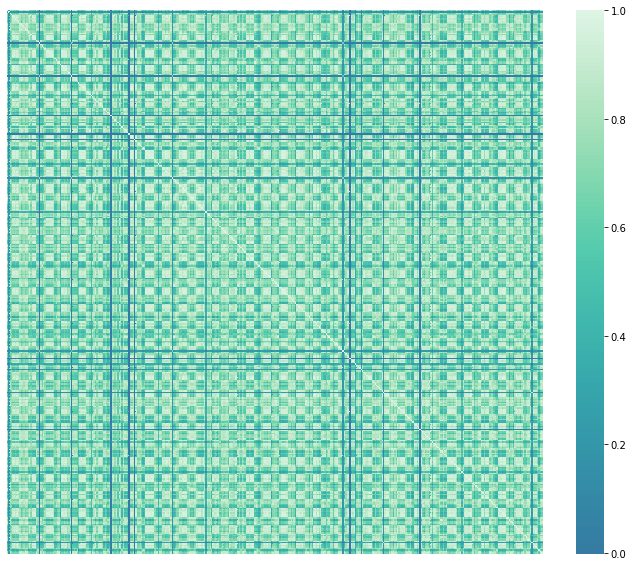

In [ ]:
plt.figure(figsize=(12,10))

corr = unfilt.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()

sns.heatmap(corr,cmap="mako", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

We can see from the minimum value obtained that there are some cells that are completely uncorrelated from the others and we want to see why:

Text(0, 0.5, 'Frequency')

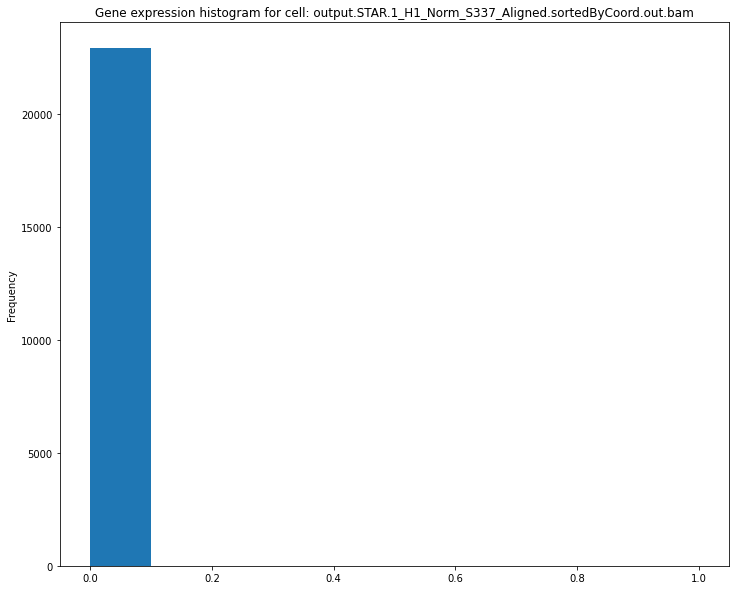

In [ ]:
plt.figure(figsize=(12,10))
#Given the symmetry of the table i look for low correlated cells in the first column, but
#that's completely arbirary
min  = np.argmin(list(corr['output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam']))
plt.hist(unfilt.iloc[:,min])
plt.title(f"Gene expression histogram for cell: {unfilt.columns.values[min]}")
plt.ylabel("Frequency")

Here we can clearly see why. These cells have zero count for every gene. These cells are abnormal and therefore will need to be removed. We will treat this issue in full details in the part concerning filtering

We now want to analyse the structure among the covariates. Notice that here due to computational power issues we display the correlation just of the first 10% of the genes.

Average correlation between cells:  0.3475550350017191
Minimum correlation between cells:  -0.3048899299965619 



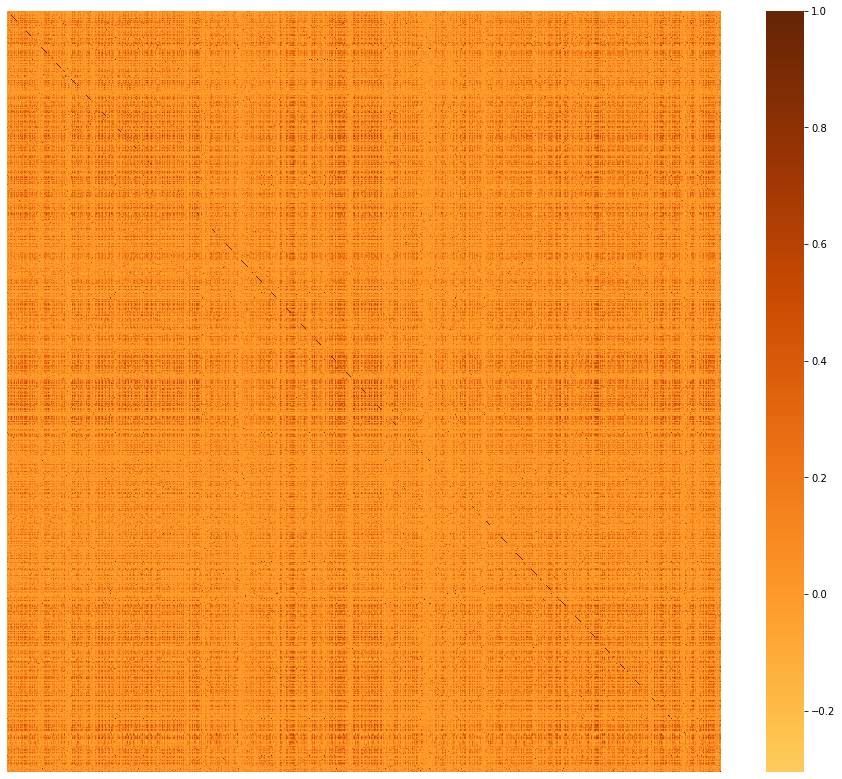

In [ ]:
plt.figure(figsize=(16,14))
#df_small = df.iloc[:, :50]
#c= df_small.corr()
corr = unfilt.iloc[:3000,:].T.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()
#sns.heatmap(c,cmap='coolwarm',annot=True, center=midpoint )
sns.heatmap(corr,cmap="YlOrBr", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

Even if we are dealing with just the 10% of the data we can clearly see how there's not a well defined structure among the genes. This can be paroblem if we consider the dimension of the dataset, some more structure for sure would have helped us in dimensionality reduction, for example, or in the task to find the so called "meta-genes".


---

Given what we've seen in the table `unfilt` we suspect that our dataset will be probably very sparsed, so we want to quantify that sparsity in some way. The first and more intutive one is to calculate the average sparsity and to plot the table in some way



In [ ]:
#Avarage density of zeros in the data

print(f"The average sparsity of the table is: {(unfilt == 0).sum().sum() / (unfilt.shape[0] * unfilt.shape[1]) * 100}%")

The average sparsity of the table is: 60.16711094696393%


This is a pretty high value! our dataset is definitely sparsed.

In the following plot we color with blue the points in the table that are different from zero. This can give us an idea of how this high sparsity is distributed across the dataset

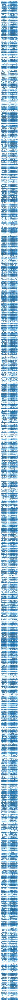

In [ ]:
plt.figure(figsize=(25, 600))
plt.spy(unfilt.iloc[:, :], markersize=1)

This very big graph is already telling us some interesting things about the data. 

We can clearily see that some cells have a low overall number of genes expessed and this may be due to problems of measure, health of the single cell, lab mistakes, ecc...

At the same time we observe how some genes are constantly not expressed among almost all the cells, meaning that there is no need of producing that specific protein / activating that methabolic pathway / regulating that specific gene expression that the gene is encodning for . 

Gene expression is thus inducing non homogeneity of the sparsity. This is actually a good thing! This sparsity is "well structured and it brings a biological meaning"! (clearily veasible some horizontal white lines). Our aim will be therefore to study this structure and drive our own conclusions from that.

The great limitation of this plot is that we don't have a differentiation among values of the expression (but we will have a more complete picture with an heatmap leater), to have an idea of that we use the function `describe()` on our dataset and we plot an histogram of the expression for some randomly choosen cells

In [ ]:
unfilt.describe()

,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_A7_Hypo_S25_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H2_Norm_S356_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
count,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,...,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000,22905.000000
mean,40.869330,0.012268,86.549356,1.025933,14.549749,56.284741,75.492556,62.847195,67.482078,2.243571,...,17.384545,42.133508,34.736302,32.775682,22.020563,17.461209,49.305086,61.623226,68.375769,62.930976
std,466.002411,0.207857,1037.224285,6.101112,123.877800,503.913891,430.735604,520.491980,459.973686,25.465612,...,193.275011,256.933843,680.390121,300.478924,153.536760,198.304138,359.560626,541.185241,637.290526,786.164389
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,17.000000,0.000000,5.000000,0.000000,7.000000,23.000000,39.000000,35.000000,38.000000,1.000000,...,9.000000,30.000000,0.000000,17.000000,12.000000,9.000000,27.000000,30.000000,38.000000,33.000000
max,46744.000000,14.000000,82047.000000,289.000000,10582.000000,46856.000000,29534.000000,50972.000000,36236.000000,1707.000000,...,17800.000000,23355.000000,81952.000000,29540.000000,12149.000000,19285.000000,28021.000000,40708.000000,46261.000000,68790.000000


Text(0, 0.5, 'Frequency')

<Figure size 1440x1224 with 0 Axes>

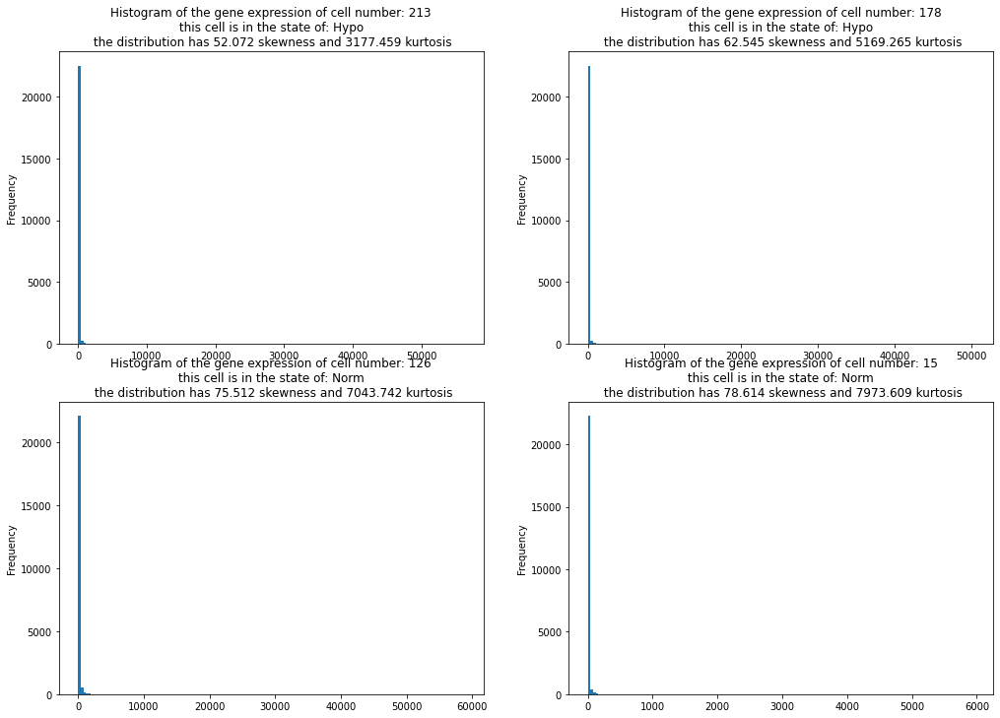

In [ ]:
from scipy.stats import kurtosis, skew

plt.figure(figsize=(20, 17))

first_cell = random.randrange(unfilt.shape[1])
second_cell = random.randrange(unfilt.shape[1])
third_cell = random.randrange(unfilt.shape[1])
fourth_cell = random.randrange(unfilt.shape[1])

plt.figure(figsize=(17, 12))

plt.subplot(2, 2, 1)
plt.hist(unfilt.iloc[:,first_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {first_cell}\n this cell is in the state of: {meta.iloc[first_cell, 3]} \n the distribution has {round(skew(unfilt.iloc[:,first_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,first_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 2)
plt.hist(unfilt.iloc[:,second_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {second_cell}\n this cell is in the state of: {meta.iloc[second_cell, 3]} \n the distribution has {round(skew(unfilt.iloc[:,second_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,second_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 3)
plt.hist(unfilt.iloc[:,third_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {third_cell}\n this cell is in the state of: {meta.iloc[third_cell, 3]} \n the distribution has {round(skew(unfilt.iloc[:,third_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,third_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 4)
plt.hist(unfilt.iloc[:,fourth_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {fourth_cell}\n this cell is in the state of: {meta.iloc[fourth_cell, 3]} \n the distribution has {round(skew(unfilt.iloc[:,fourth_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,fourth_cell]), 3)} kurtosis")
plt.ylabel("Frequency")



The result is as expected by choosing at random four cells in our sample. The histogram is showing how for these cells the big majority of genes have zero reads, but those who are not can count up to almost 45000 reads (seen from the table above). Moreover, from the values of kurtosis and skewness we see that the distributions are highly non normal

We leaen an important thing about this dataset, **the interesting datapoints are the outliers**! This means that we cannot procede with the elimination of the outliers as you would normally do, because it would leave us with no information at all 

---

Now that we assessed that there are a lot of zeros in our dataset, we want to see for some genes how is the distributions on non-zero values, maybe there are some sort of clusters that we can identify (at least that's what we would expect: if the gene is expressed we will record a certain gene expression (more or less) and if it's not expressed we recover almost all zeros. Mathematically we would expect the histogram to show a binomodal behaviour with one of the peaks around zero.

Text(0, 0.5, 'Frequency (possibly scaled)')

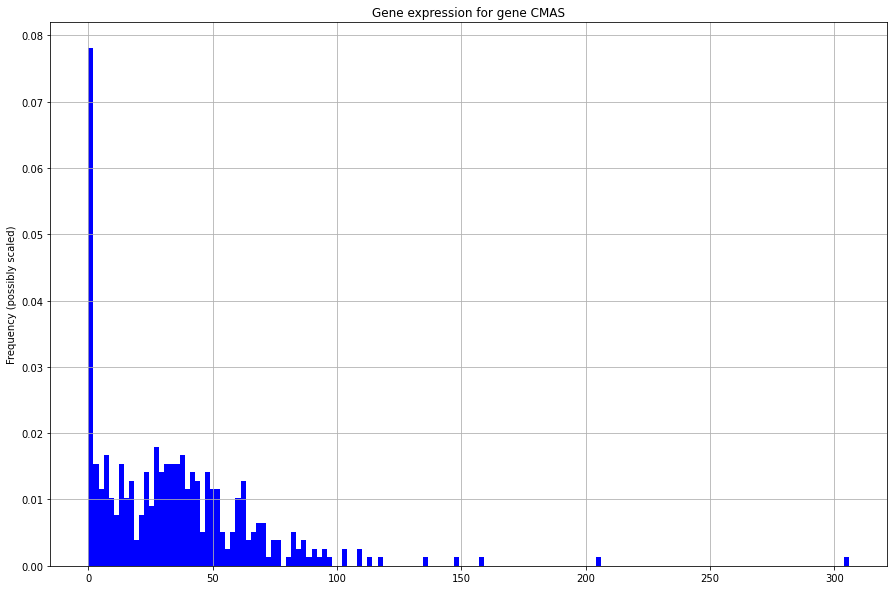

In [ ]:
rdn_gene = random.randrange(unfilt.shape[0])

plt.figure(figsize=(15, 10))
unfilt.iloc[rdn_gene, :].plot.hist(grid=True,
                                      density = True, 
                                      bins=150,
                                      color='blue')

plt.title(f"Gene expression for gene {unfilt.index[rdn_gene]}")
plt.ylabel("Frequency (possibly scaled)")

But we see that this is not the case!  All the other genes will display a similar distribution and we point out three important common characteristics:
- A low number of counts associated with a large proportion of genes 
- A long right tail due to the lack of any upper limit for expression
- A large dynamic range

The distribution seems therefor to follow a Poisson/Negative binomial distribution. (where in the first case we assume the mean to be equal to the variance and in the second case we don't). The intuition of why is that the case is the following:

**With RNA-Seq data, a very large number of RNAs are represented and the probability of pulling out a particular transcript is very small**

Under this light, this really resables the canonical examples of "customers entering the shop in a fixed interval of time" or "Number of accidents in a day an insurance company will have to pay for" that are typically used to explain the Poisson Distribution.

--- 
Given what stated above, we further investigate the ralation between mean and variance of the gene expression among cells to see if we would prefer adopting a Negative Binomial ditribution:

Text(0, 0.5, 'Variance')

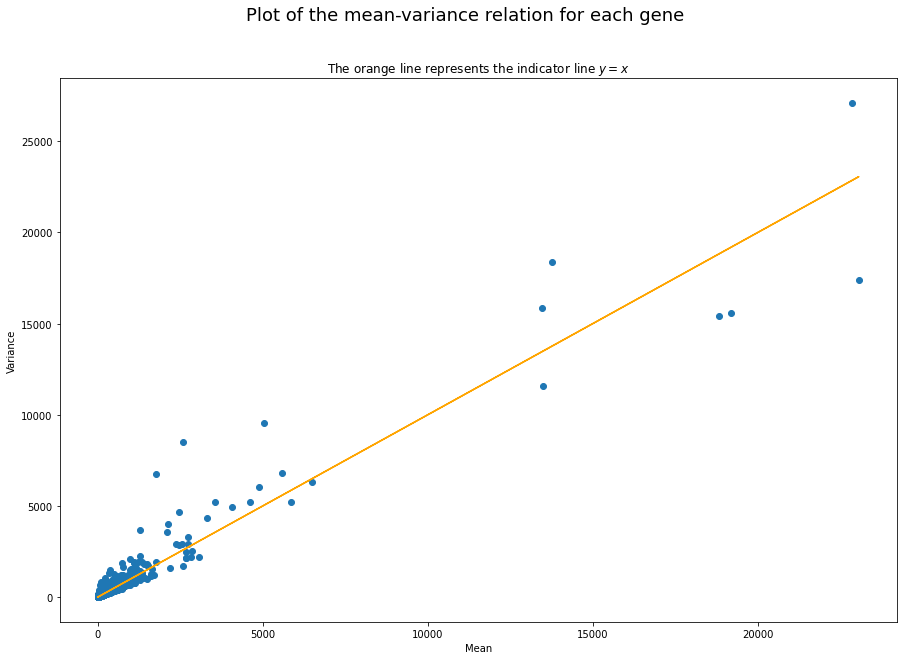

In [ ]:
##################### THIS PLOT COULD TAKE SOME TIME ########################
mean_vector = unfilt.T.describe().iloc[1,:]
var_vector = unfilt.T.describe().iloc[2,:]

plt.figure(figsize=(15, 10))
plt.scatter(mean_vector, var_vector)
plt.plot(mean_vector, mean_vector, color = "orange")
plt.title("The orange line represents the indicator line $y=x$", fontsize = 12)
plt.suptitle("Plot of the mean-variance relation for each gene", fontsize = 18)
plt.xlabel("Mean")
plt.ylabel("Variance")


Clearly we see that there's a sort of linear 1:1 relation between mean and variance, we can try to use the Poisson distribution to model the gene expression and use it to identify **HVG** (Highly Variable Genes). Those will be the genes we want to keep when filtering (See the next part)

### Filtering and Normalization

#### Cells filtering

We now check if the total reads among cells follow a normal distribution, meaning that the difference in total read counts it's just a measurement error. This is reasonable given that we expect the same cell-line grown in just two different states to show more or less the same total gene expression. 

Moreover, we remind that in the experiment two other kind of normalizations are applyed to reduce possible problems in the total read count: 
- We extract the same amount of Rna (In the LAB)
- We adjust the runs to get similar number of counts for each sample (in the sequencing facilities)

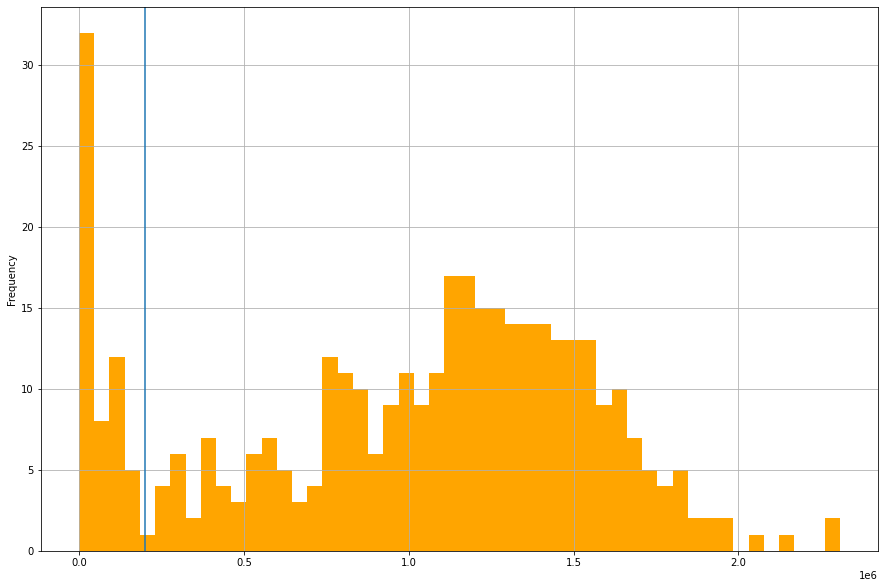

In [ ]:
totsums = unfilt.sum(axis = 0)

plt.figure(figsize=(15, 10))
plt.axvline(x=0.20e6) #Where do we want to do the cut in our filtering 
totsums.plot.hist(grid = True, bins = 50, color= "orange")

Now we want to plot an istogram of the number of genes different from zero for each cell, also this should follow a normal distribution (this is a stadard step in each analysis)

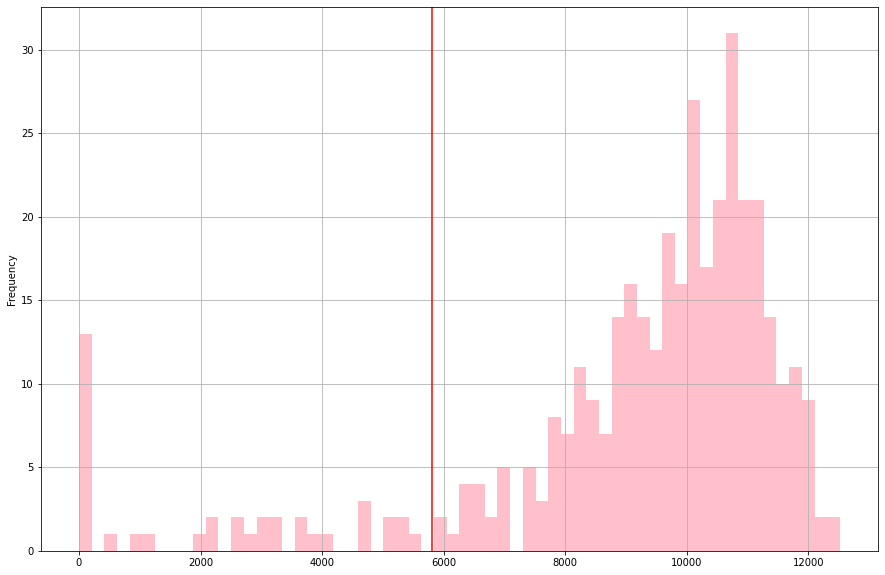

In [ ]:
#Create a copy dataframe where all the positive entries will become equal to one 
copy = unfilt.copy()
copy[copy != 0] = 1
totcopysums = copy.sum(axis = 0)

plt.figure(figsize=(15, 10))
plt.axvline(x=5800, color = "red") #Where do we want to do the cut in our filtering 
totcopysums.plot.hist(grid = True, bins = 60, color= "pink")

The plots are suggesting that indeed there's a measuement error following a normal distribution and therefore we would like to cut those cells that do not follow this curve, because their gene expression may be corrupted by human mistakes in extracting the data or by the health status of the cell itself

The blue vertical line in the first plot and the red one in the second indicate where (by eye) the plot finishes to be a nice bell-shaped histogram and thus where we want to cut in the filtering.


---

Here we proceed with the above described filtering

In [ ]:
filtered  = unfilt.loc[:, (totsums >= .20e6) & (copy.sum(axis = 0) >= 5800)]
perc_cell_lost = (unfilt.shape[1] - filtered.shape[1]) / unfilt.shape[1] * 100
print(f" We passed from haveing {unfilt.shape[1]} cells to have {filtered.shape[1]} cells\n This results in a lost of the {perc_cell_lost}% of the cells") 

 We passed from haveing 383 cells to have 320 cells
 This results in a lost of the 16.449086161879894% of the cells


In [ ]:
filtered

,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam,output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam,output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,1,0,0,1,0,0,0,1,0,1
MIR6859-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WASH9P,1,0,0,1,10,1,0,5,4,1,...,2,1,1,0,0,0,1,1,4,5
OR4F29,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
MTND1P23,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,4,0,3,3,0,0,14,9,3,0,...,1,0,4,4,0,1,6,0,7,4
MT-CYB,270,76,727,2717,9326,3253,7949,2853,570,215,...,140,239,3795,2263,1368,570,3477,349,2184,1149
MT-TT,0,0,0,1,1,1,4,2,4,0,...,0,0,7,2,0,0,3,0,2,2
MT-TP,5,0,0,1,1,4,2,5,7,2,...,1,0,14,11,2,0,7,2,28,11


We now want to study the percentage of mitochondrial RNA and cut those cells at a rate that is too high (above 4%/5% is the rule of thumb that we adopt here, but in general this trashold is study-specific and there's active discussion inside the community about how to decide it). The idea behind this filtering is that when a cell is lysed during the process of Rna extraction or the cell membrane is disrupted, the cytoplasmatic transcript is released while mitochondrial RNA is more protected because of a double membrane around mitochondria. Therefore the high percentage of mtRNA would indicate poor quality of the cell condition 

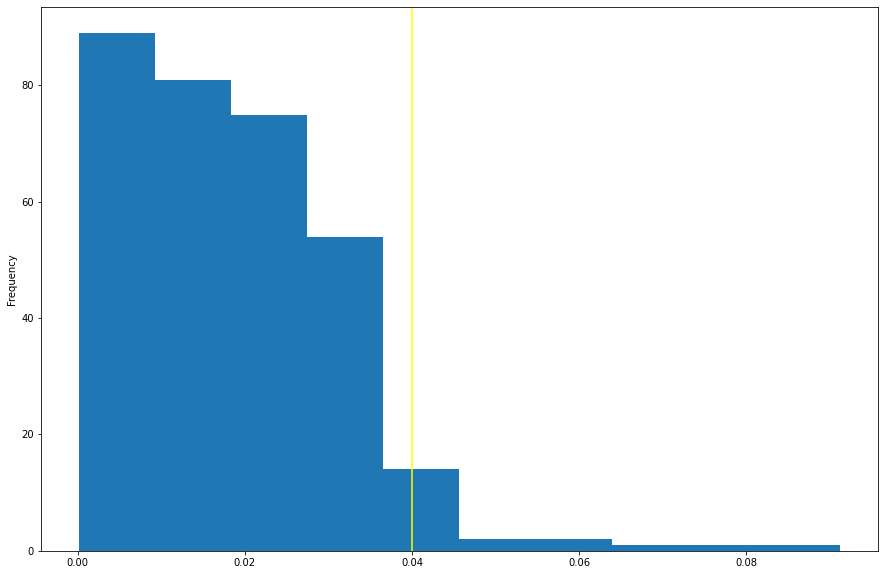

In [ ]:
total_mitocondrial = filtered[filtered.index.str.startswith('MT-')].sum(axis = 0)
total_express = filtered.sum(axis = 0)
assert len(total_mitocondrial) == len(total_express)

mito_ratio = total_mitocondrial / total_express

plt.figure(figsize=(15, 10))
plt.axvline(x=0.04, color = "yellow") #Where do we want to do the cut in our filtering
mito_ratio.plot.hist()

We filter cells with too much mitocondrial RNA

In [ ]:
filtered_cells = filtered.loc[:, mito_ratio <= 0.04]
filtered_cells

,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam,output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam,output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,1,0,0,1,0,0,0,1,0,1
MIR6859-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WASH9P,1,0,0,1,10,1,0,5,4,1,...,2,1,1,0,0,0,1,1,4,5
OR4F29,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
MTND1P23,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,4,0,3,3,0,0,14,9,3,0,...,1,0,4,4,0,1,6,0,7,4
MT-CYB,270,76,727,2717,9326,3253,7949,2853,570,215,...,140,239,3795,2263,1368,570,3477,349,2184,1149
MT-TT,0,0,0,1,1,1,4,2,4,0,...,0,0,7,2,0,0,3,0,2,2
MT-TP,5,0,0,1,1,4,2,5,7,2,...,1,0,14,11,2,0,7,2,28,11


And this is the end for us of the filtering of the cells.

---

#### Normalization

We first recall what is the distribution of a randomly choosen gene, this time within the cells that passed the filtering section

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Gene expression for gene MIR6790')

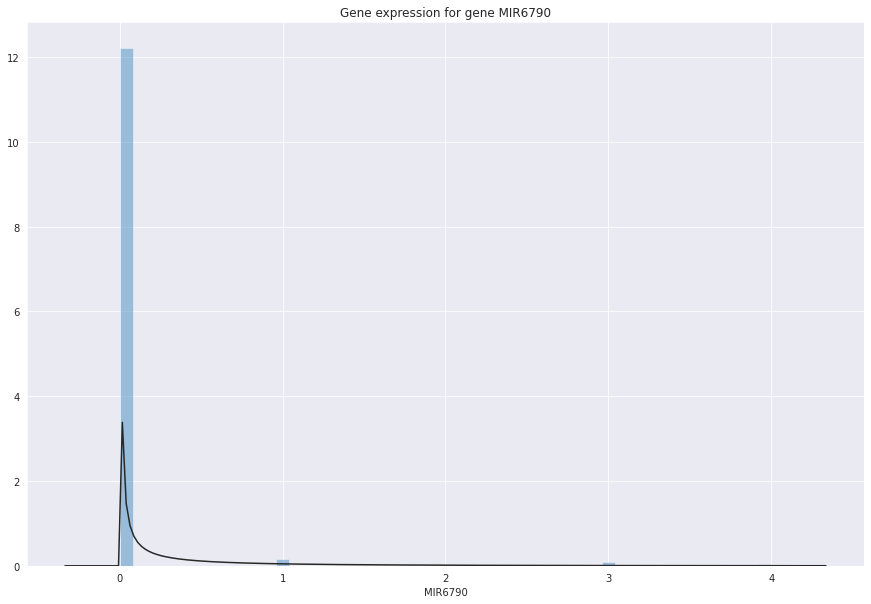

In [ ]:
rdn_gene = random.randrange(filtered_cells.shape[0])
plt.figure(figsize=(15, 10))
sns.set_style('darkgrid')
sns.distplot(filtered_cells.iloc[rdn_gene, :], fit=stats.gamma, 
                                          kde=False, 
                                          bins = 50)
plt.title(f"Gene expression for gene {unfilt.index[rdn_gene]}")


Here you see an histogram with a gamma distribution fitted. Why a gamma distribution? This is because we want a smooth and contiuos verion of the Poisson distribution (that would be an Exponential), but with a bit more of freedom so we fitted a Gamma (Sum of Exponentials)

We now want to check that normalizing for total reads across cells will change the distribution for our single gene. This is a normalization in Cell dimension and reading depth, if we want to perform comparisons within cells we need them to be indeed comparable. This kind of normalization is commonly known as **Library Size Normalization**. 

In [ ]:
unfilt_CPM = filtered_cells.copy()

#CPM normalization 
for i in range(unfilt_CPM.shape[1]):
  unfilt_CPM.iloc[:,i] = unfilt_CPM.iloc[:,i]/(sum(unfilt_CPM.iloc[:,i])/10e6)


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


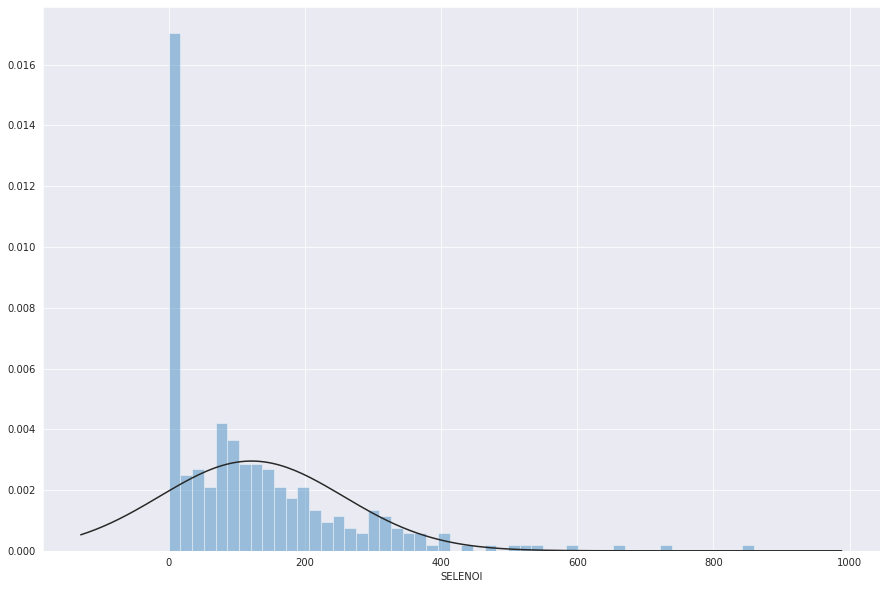

In [ ]:
rdn_gene = random.randrange(filtered_cells.shape[0])

plt.figure(figsize=(15, 10))
sns.set_style('darkgrid')
sns.distplot(unfilt_CPM.iloc[rdn_gene, :], fit=stats.norm, 
                                          kde=False, 
                                          bins = 50)

We have the concern that this:
- artificially increases variance for genes espressed around zero 
- Inflation on gene counts for cell types with low transcript numbers
- topological distorsion in the cell neightborhood structure, affecting clustering distance matrix

These are a major concern when you want to compare the gene expression. To better understand that consider the following example: you have two cells where a single gene $X$ is upregulated in cell $A$ compared to cell $B$. What happens is that when $X$ is assigned more reads or UMIs, the library size factor is increasing and is yielding smaller normalized expression values for all non-DE genes . In such a case, the net effect is that non-DE genes in $A$ will incorrectly appear to be downregulated compared to $B$. This baias get worse and worse the more gene $X$ is upregulated in cell $A$ compared to cell $B$

In CPM normalization is assumed that the only difference between samples is total counts and this is of course a very strict and quite naive assumption. What is usually done is to use some normalization teqniques that try to calculate a normalization factor that keeps into account not only the total count on the cell, but also the distribution of the genes. Investigating this issue is a bit behond the scope of this project so we will limit ourself to a CPM normalization. 

Notice that given the fact that we are not using UMI counts for this specific datset, but just normal counts we would also need to normalize for the gene lenght. The idea here is that longer genes will recive more reads than sorter ones, but this for us will not be a problem as long as we just make relative comparisons for the same gene among the different samples (that is exactly what we will do soon trying to find out the Highly expressed genes)

In [ ]:
#Log + 1 transfomration
Normal = np.log(unfilt_CPM.copy() + 1)
Normal

,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam,output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam,output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
WASH7P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.365236,0.000000,0.000000,2.661687,0.000000,0.000000,0.000000,2.089981,0.000000,2.071603
MIR6859-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
WASH9P,2.458090,0.000000,0.000000,2.169823,4.074680,2.072767,0.000000,3.129438,3.248437,2.453432,...,3.010281,3.262451,2.430271,0.000000,0.000000,0.000000,2.287957,2.089981,3.278668,3.574806
OR4F29,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.999464,0.000000
MTND1P23,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,3.778033,0.000000,4.511071,3.189250,0.000000,0.000000,4.517160,3.697592,2.973617,0.000000,...,2.365236,0.000000,3.748276,3.994187,0.000000,3.258219,3.991365,0.000000,3.822004,3.358643
MT-CYB,7.967374,5.951609,9.990384,9.955893,10.895531,10.025656,10.847944,9.431479,8.168453,7.734585,...,7.208983,8.700034,10.579607,10.313778,10.208150,9.564710,10.334916,7.813423,9.542952,8.983719
MT-TT,0.000000,0.000000,0.000000,2.169823,1.914444,2.072767,3.291331,2.276698,3.248437,0.000000,...,0.000000,0.000000,4.297744,3.319294,0.000000,0.000000,3.316523,0.000000,2.622506,2.699687
MT-TP,3.996592,0.000000,0.000000,2.169823,1.914444,3.359929,2.634713,3.129438,3.791269,3.102629,...,2.365236,0.000000,4.984069,4.993995,3.705062,0.000000,4.142873,2.719288,5.191749,4.347861


We now look at the effect of this normalization on the distribution of a random gene. 

N.B: you can run this cell multiple times to see different genes choosen. As you can see it's not difficult to find genes with almost all zero reads (we will take care of this issue soon)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


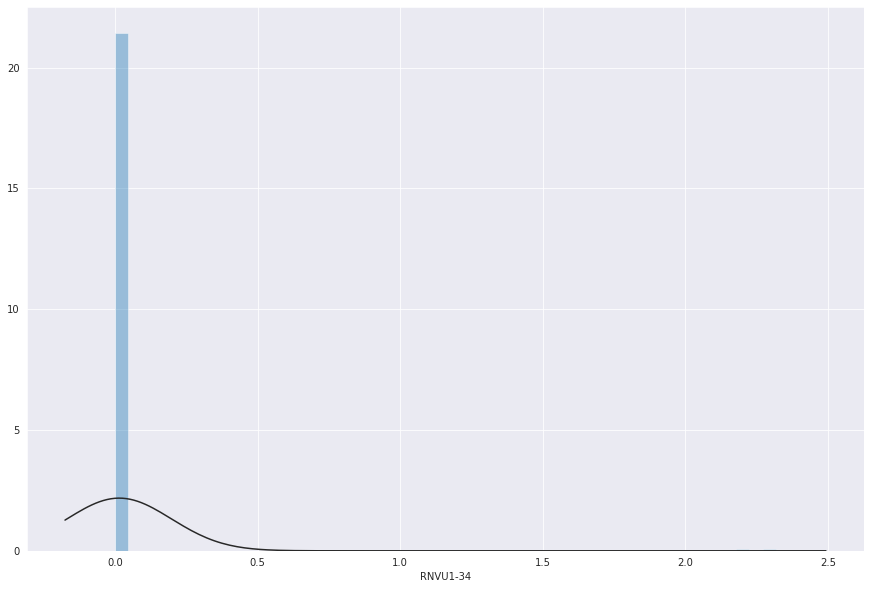

In [ ]:
rdn_gene = random.randrange(filtered_cells.shape[0])

plt.figure(figsize=(15, 10))
sns.set_style('darkgrid')
sns.distplot(Normal.iloc[rdn_gene, :], fit=stats.norm, 
                                          kde=False, 
                                          bins = 50)

In [ ]:
Normal

,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam,output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam,output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
WASH7P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.365236,0.000000,0.000000,2.661687,0.000000,0.000000,0.000000,2.089981,0.000000,2.071603
MIR6859-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
WASH9P,2.458090,0.000000,0.000000,2.169823,4.074680,2.072767,0.000000,3.129438,3.248437,2.453432,...,3.010281,3.262451,2.430271,0.000000,0.000000,0.000000,2.287957,2.089981,3.278668,3.574806
OR4F29,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.999464,0.000000
MTND1P23,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,3.778033,0.000000,4.511071,3.189250,0.000000,0.000000,4.517160,3.697592,2.973617,0.000000,...,2.365236,0.000000,3.748276,3.994187,0.000000,3.258219,3.991365,0.000000,3.822004,3.358643
MT-CYB,7.967374,5.951609,9.990384,9.955893,10.895531,10.025656,10.847944,9.431479,8.168453,7.734585,...,7.208983,8.700034,10.579607,10.313778,10.208150,9.564710,10.334916,7.813423,9.542952,8.983719
MT-TT,0.000000,0.000000,0.000000,2.169823,1.914444,2.072767,3.291331,2.276698,3.248437,0.000000,...,0.000000,0.000000,4.297744,3.319294,0.000000,0.000000,3.316523,0.000000,2.622506,2.699687
MT-TP,3.996592,0.000000,0.000000,2.169823,1.914444,3.359929,2.634713,3.129438,3.791269,3.102629,...,2.365236,0.000000,4.984069,4.993995,3.705062,0.000000,4.142873,2.719288,5.191749,4.347861


---

### Data filtering


#### Assuming normality of the transformed data

In this section we try to find the Higly Variable genes and keep them, discarding all the others. In this first version of the filtering we use the data $log( x + 1)$ transformed.

First of all we divide our normalized and filtered with respect to cells dataframe `Normal` into two smaller dataframes: one containing the cells that grew up under Hypoxia `meta["Condition"] == "Hypo"` and one containing the cells that grew up under Normoxia `meta["Condition"] == "Norm"`

In [ ]:
t_norm = Normal.T.copy()

#We divide the dataset in two subdatasets containing the hypoxic and the normal cells
hypo = t_norm[meta["Condition"] == "Hypo"].T
norm = t_norm[meta["Condition"] == "Norm"].T

hypo.columns = hypo.columns.str.replace("output.STAR.", "")
hypo.columns = hypo.columns.str.replace("_Aligned.sortedByCoord.out.bam", "")

norm.columns = norm.columns.str.replace("output.STAR.", "")
norm.columns = norm.columns.str.replace("_Aligned.sortedByCoord.out.bam", "")


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning: The default value of regex will change from True to False in a future version.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: FutureWarning: The default value of regex will change from True to False in a future version.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: FutureWarning: The default value of regex will change from True to False in a future version.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning: The default value of regex will change from True 

Now we have a look to the result for the new dataframe `hypo` and we check if the dimensions of the two dataframes are similar 

In [ ]:
print(f"The dataframe hypo has dimension: {hypo.shape} \nThe dataframe norm has dimension: {norm.shape}")
hypo

The dataframe hypo has dimension: (22905, 158) 
The dataframe norm has dimension: (22905, 146)


,1_A10_Hypo_S28,1_A12_Hypo_S30,1_B10_Hypo_S76,1_B11_Hypo_S77,1_B12_Hypo_S78,1_B7_Hypo_S73,1_B8_Hypo_S74,1_C10_Hypo_S124,1_C11_Hypo_S125,1_C12_Hypo_S126,...,4_G11_Hypo_S335,4_G12_Hypo_S336,4_G7_Hypo_S331,4_G8_Hypo_S332,4_G9_Hypo_S333,4_H10_Hypo_S382,4_H14_Hypo_S383,4_H7_Hypo_S379,4_H8_Hypo_S380,4_H9_Hypo_S381
WASH7P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,2.365236,0.000000,2.089981,0.000000,2.071603
MIR6859-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
WASH9P,2.458090,0.000000,3.129438,3.248437,2.453432,3.960486,3.335930,3.286287,0.000000,2.641720,...,2.974692,3.324409,0.000000,0.000000,2.479201,3.010281,3.262451,2.089981,3.278668,3.574806
OR4F29,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.999464,0.000000
MTND1P23,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,3.778033,0.000000,3.697592,2.973617,0.000000,0.000000,0.000000,0.000000,0.000000,4.088796,...,2.974692,0.000000,4.201741,3.448069,2.479201,2.365236,0.000000,0.000000,3.822004,3.358643
MT-CYB,7.967374,5.951609,9.431479,8.168453,7.734585,7.343093,5.202339,7.511404,7.739817,9.019987,...,8.655795,7.674401,8.732240,8.359999,8.555176,7.208983,8.700034,7.813423,9.542952,8.983719
MT-TT,0.000000,0.000000,2.276698,3.248437,0.000000,0.000000,0.000000,3.679209,0.000000,2.017389,...,0.000000,0.000000,2.650457,0.000000,4.019237,0.000000,0.000000,0.000000,2.622506,2.699687
MT-TP,3.996592,0.000000,3.129438,3.791269,3.102629,0.000000,0.000000,2.629850,3.367738,3.023153,...,2.974692,2.295311,3.307656,3.946090,3.520318,2.365236,0.000000,2.719288,5.191749,4.347861


##GROUP 2 GENE SELECTION

We want to identify those genes for which we can see a statistically significant difference in the ditribution of the genes expression among all the cells. Those will be the genes that we want to keep for our furure studies. 

We start by applying a t-test to obtain some raw p-values that identify statistically significant genes. Here is where we naively assume normality of the data, leveraging on the central limit theorem given that the two sample sizes are respectively 158 and 146)

In [ ]:
#We create a dict to store the inial un adjusted p-values
p_val_row = {}
for i in range(Normal.shape[0]):  
  p_val_row[i] = stats.ttest_ind(hypo.iloc[i,:], norm.iloc[i,:], equal_var=False).pvalue

We plot the result on an histogram that is as would expect: A lot of genes seems statistically significant and then you have an "under layer" of uniform distribution coming from the non significant expressed genes.

Text(0.5, 1.0, 'p-value histogram')

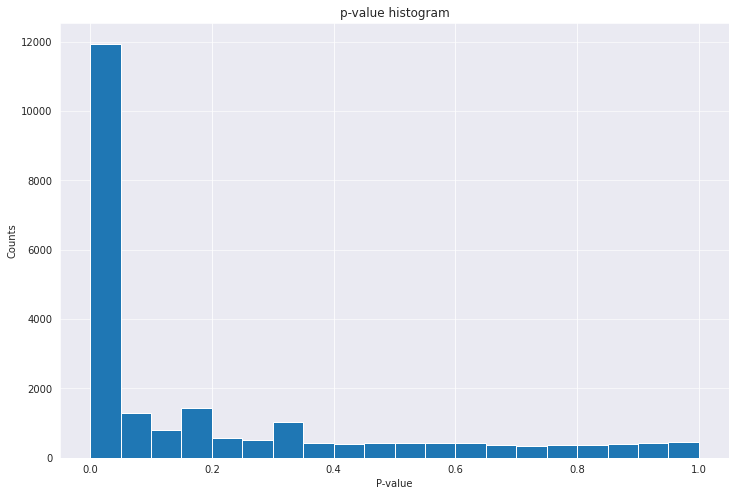

In [ ]:
plt.figure(figsize=(12,8))
plt.hist(p_val_row.values(),
         bins = 20)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('P-value')
plt.ylabel('Counts')
plt.title('p-value histogram')

Of course, when having to deal with so many tests we will incur in the so called "Multiple Testing Problem" and one way to deal with it is to change the p-values into q-values using the Benjamini-Hochberg correction. These values are also known as FDRs (False Discovery Rates) and we write down a function called `q-value` that computes them. 

Sometimes, however, the Benjamini-Hochberg correction is very good ad eliminating False positives, but sometimes it shriks too much the number of true positive, when adjusting the p-values. This eccesive shrinking behaviour can lead to a significant loss of important genes and we have to account for that. 

This is exactly what we do in the next part: 
- We try different CPM trashold (see the description of the function)
- We calculate the ajusted p-values on the genes that come out of this procedure 



In [ ]:
def filter_CPM(treshold):
  '''
  This function takes as input a CPM trashold and then it looks for each gene if there are
  at least two cells with the CPM that is over the given trashold. It then stores the indices
  of the genes that did NOT pass this barrier test.
  '''
  to_filter_list = []
  for i in range(Normal.shape[0]):
    mask = [element for element in Normal.iloc[i,:] if element >= treshold]
    if len(mask) <= 2:
      to_filter_list.append(i) 
  return to_filter_list

And here we apply this test with a trashold of `CPM = 1`

In [ ]:
len(filter_CPM(5))

8759

In [ ]:
def q_value (p_val_dict):
  sorted_list = [[key, value] for (key, value) in sorted(p_val_dict.items(), key=lambda x: x[1])]
  rank = 1
  for p in sorted_list:
    p[1] = p[1] * len(p_val_dict)/rank
    rank += 1
  q_val_dict = dict(sorted_list)
  q_val_dict = (sorted(q_val_dict.items()))
  return q_val_dict

In [ ]:
def graph_data_due(p_val_pre):
  y_axis = []
  for treshold in np.arange(0, 20, 1):
    aux_dictt = p_val_pre.copy()
    indices = filter_CPM(treshold)
    print("how many genes will be ignored in this iteration", len(indices))
    for ind in indices:
      del aux_dictt[ind]
    count = len([value for value in q_value(aux_dictt) if value[1] <= 0.05])
    print("Relevant number of genes for this treshold", count)
    y_axis.append(count)
    aux_dictt = p_val_pre.copy()
  return y_axis


In [ ]:
#Calculating this values will take some time, it has to go 20 iterations 
y = graph_data_due(p_val_row)

how many genes will be ignored in this iteration 0
Relevant number of genes for this treshold 10726
how many genes will be ignored in this iteration 1997
Relevant number of genes for this treshold 11124
how many genes will be ignored in this iteration 2261
Relevant number of genes for this treshold 11135
how many genes will be ignored in this iteration 4567
Relevant number of genes for this treshold 11075
how many genes will be ignored in this iteration 6584
Relevant number of genes for this treshold 10678
how many genes will be ignored in this iteration 8759
Relevant number of genes for this treshold 9859
how many genes will be ignored in this iteration 11813
Relevant number of genes for this treshold 8223
how many genes will be ignored in this iteration 16026
Relevant number of genes for this treshold 5383
how many genes will be ignored in this iteration 20235
Relevant number of genes for this treshold 2236
how many genes will be ignored in this iteration 22222
Relevant number of gen

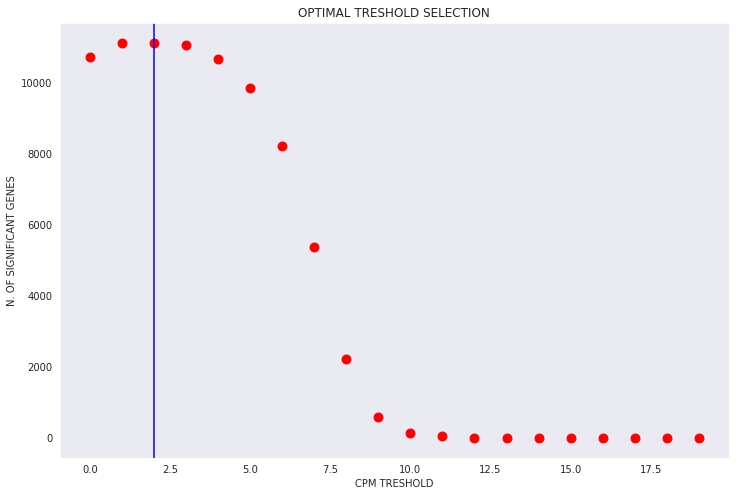

In [ ]:
x = np.arange(0, 20, 1)
plt.figure(figsize=(12,8))
plt.scatter(x, y,
            s = 80,
            color = "r")
plt.grid()
plt.xlabel('CPM TRESHOLD')
plt.ylabel('N. OF SIGNIFICANT GENES')
plt.title('OPTIMAL TRESHOLD SELECTION')
plt.axvline(x=2, color = "blue")
plt.show()

Given that we want to preserve as many significant genes as possible when adjusting the p-values, we choose a CMP cut of 3

In [ ]:
#We calculate the optimal set of genes
indices = filter_CPM(3)
final_dictt = p_val_row.copy()

for ind in indices:
  del final_dictt[ind]

#Notice that the sensitivity setted is very very small: 0.001%
final_indices = [value[0] for value in q_value(final_dictt) if (value[1] <= 0.00001)]

We apply this to the dataset we had to finally obtain the final filtered version

In [ ]:
filt_lollo_1 = Normal.copy().iloc[final_indices]
filt_lollo_1

,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam,output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam,output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
MTND2P28,3.107496,1.799125,0.000000,2.169823,2.909602,3.753747,4.649326,4.198455,2.973617,0.000000,...,0.000000,0.000000,3.748276,3.319294,3.036216,0.000000,2.929035,3.923820,5.226648,3.574806
MTCO1P12,3.107496,1.799125,0.000000,3.189250,4.074680,3.576100,3.507006,1.681242,3.463783,3.102629,...,0.000000,3.262451,4.297744,3.994187,0.000000,3.258219,3.812731,0.000000,3.278668,3.082488
MTCO2P12,0.000000,1.799125,0.000000,0.000000,1.914444,2.700929,2.010849,0.000000,0.000000,0.000000,...,0.000000,0.000000,2.430271,2.661687,0.000000,0.000000,3.812731,0.000000,0.000000,0.000000
MTATP6P1,5.739124,4.119562,7.621409,7.362403,8.293341,7.266854,8.508507,7.278081,5.654682,5.662825,...,5.489614,7.136223,8.022050,7.955625,7.862591,7.111640,8.094766,5.458722,7.283999,6.201655
MTCO3P12,0.000000,0.000000,0.000000,0.000000,2.531021,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,3.036216,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-ND5,8.593349,1.799125,8.869612,8.844412,8.908920,8.470823,9.740780,8.700192,8.654661,8.602018,...,8.180384,9.052466,9.588136,9.821363,9.100802,9.051003,9.566259,6.087355,9.421393,9.128485
MT-TE,3.778033,0.000000,4.511071,3.189250,0.000000,0.000000,4.517160,3.697592,2.973617,0.000000,...,2.365236,0.000000,3.748276,3.994187,0.000000,3.258219,3.991365,0.000000,3.822004,3.358643
MT-CYB,7.967374,5.951609,9.990384,9.955893,10.895531,10.025656,10.847944,9.431479,8.168453,7.734585,...,7.208983,8.700034,10.579607,10.313778,10.208150,9.564710,10.334916,7.813423,9.542952,8.983719
MT-TT,0.000000,0.000000,0.000000,2.169823,1.914444,2.072767,3.291331,2.276698,3.248437,0.000000,...,0.000000,0.000000,4.297744,3.319294,0.000000,0.000000,3.316523,0.000000,2.622506,2.699687


Last, we try to implement a function that returns the name of the n most significant genes, based on the adjusted p_values calculated before

In [ ]:
def top_genes (n):
  sorted_list = [[key, value] for (key, value) in sorted(p_val_row.items(), key=lambda x: x[1])]
  rank = 1
  for p in sorted_list:
    p[1] = p[1] * len(p_val_row)/rank
    rank += 1

  indices = []
  for couple in sorted_list[:n]:
    indices.append(couple[0])
  
  for index in indices:
    print(Normal.index.values[index])
  

In [ ]:
top_genes(20)

ENO1
C4orf3
NDRG1
GAPDHP1
ELOVL2
PARK7
HK2P1
HNRNPA2B1
AURKAIP1
ELOVL6
PGK1
HMGN2
NECAB1
MTATP6P1
SLC2A1
RIMKLA
PFKFB4
GAPDHP65
TAF9B
FKBP5


Luckly enough at position #3 (NDRG1) and #11 (PGK1) we find two genes that we know are directly involved in the cell reaction to hypoxia (According to [DAVID Database](https://david.ncifcrf.gov/)). This little naive and baiased filtering gave us some nice results at the end and that's why we wanted to include it in the discussion

- **NDRG1**: This gene is a member of the N-myc downregulated gene family which belongs to the alpha/beta hydrolase superfamily. The protein encoded by this gene is a cytoplasmic protein involved in stress responses, hormone responses, cell growth, and differentiation. The encoded protein is necessary for p53-mediated caspase activation and apoptosis. Mutations in this gene are a cause of Charcot-Marie-Tooth disease type 4D, and expression of this gene may be a prognostic indicator for several types of cancer.

- **PGK1**:	The protein encoded by this gene is a glycolytic enzyme that catalyzes the conversion of 1,3-diphosphoglycerate to 3-phosphoglycerate. The encoded protein may also act as a cofactor for polymerase alpha. Additionally, this protein is secreted by tumor cells where it participates in angiogenesis by functioning to reduce disulfide bonds in the serine protease, plasmin, which consequently leads to the release of the tumor blood vessel inhibitor angiostatin.

In [ ]:
proffilt = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt', delimiter = " ", index_col = 0)

In [ ]:
counter = 0
for gene in proffilt.index.values:
  if gene in filt_lollo_1.index.values:
    counter +=1

print(f"Sovrapposition between our dataframe and the provided dataframe: {counter/3000 *100}%")

Sovrapposition between our dataframe and the provided dataframe: 33.46666666666667%


---

---
#### Nonparametric estimate 

The idea here is to use not normalized data for filtering out genes, given that normalization as described above does not correct for library composition bias. Here the idea is to take the data as they are and perform the filtering in a similar way than before 

To avoid numerical problem when applying the test and to stabilize the result we decide to cut all those genes with a CPM  

This also makes sense heuristically, because we dont want to calssify as significantly DE gene one that passes from mean count $0.2$ to mean count $0.8$ (The mean expression is four times higher, but given the low range of values this could be misleading)  

In [ ]:
def filter_CPM_keep_np(treshold):
  '''
  This function takes as input a CPM trashold and then it looks for each gene if there are
  at least two cells with the CPM that is over the given trashold. It then stores the indices
  of the genes that did NOT pass this barrier test.
  '''
  to_keep_list = []
  for i in range(filtered_cells.shape[0]):
    mask = [element for element in filtered_cells.iloc[i,:] if element >= treshold]
    if len(mask) >= 2:
      to_keep_list.append(i) 
  return to_keep_list

np_to_keep_ind = filter_CPM_keep_np(1)
np_filt_1 = filtered_cells.copy().iloc[np_to_keep_ind]

In [ ]:
np_filt_1

,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam,output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam,output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,1,0,0,1,0,0,0,1,0,1
MIR6859-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WASH9P,1,0,0,1,10,1,0,5,4,1,...,2,1,1,0,0,0,1,1,4,5
OR4F29,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
MTND1P23,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,4,0,3,3,0,0,14,9,3,0,...,1,0,4,4,0,1,6,0,7,4
MT-CYB,270,76,727,2717,9326,3253,7949,2853,570,215,...,140,239,3795,2263,1368,570,3477,349,2184,1149
MT-TT,0,0,0,1,1,1,4,2,4,0,...,0,0,7,2,0,0,3,0,2,2
MT-TP,5,0,0,1,1,4,2,5,7,2,...,1,0,14,11,2,0,7,2,28,11


In [ ]:
t_np_filt_1 = np_filt_1.T.copy()

#We divide the dataset in two subdatasets containing the hypoxic and the normal cells
hypo_np = t_np_filt_1[meta["Condition"] == "Hypo"].T
norm_np = t_np_filt_1[meta["Condition"] == "Norm"].T

hypo_np.columns = hypo_np.columns.str.replace("output.STAR.", "")
hypo_np.columns = hypo_np.columns.str.replace("_Aligned.sortedByCoord.out.bam", "")

norm_np.columns = norm_np.columns.str.replace("output.STAR.", "")
norm_np.columns = norm_np.columns.str.replace("_Aligned.sortedByCoord.out.bam", "")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning: The default value of regex will change from True to False in a future version.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: FutureWarning: The default value of regex will change from True to False in a future version.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: FutureWarning: The default value of regex will change from True to False in a future version.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning: The default value of regex will change from True 

As described above the non normalize data for the genes have an histogram that follows a poisson distribution, here below we show again this selecting at random four genes and plotting their boxplots. It's pretty clear that we cannot adopt the assumption of normality 

{'boxes': [<matplotlib.lines.Line2D at 0x7f664a9051d0>,
 'caps': [<matplotlib.lines.Line2D at 0x7f664a90f250>,
 'fliers': [<matplotlib.lines.Line2D at 0x7f664a92f290>,
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x7f664a90fd10>,
 'whiskers': [<matplotlib.lines.Line2D at 0x7f664a905790>,
  <matplotlib.lines.Line2D at 0x7f664a933d90>]}

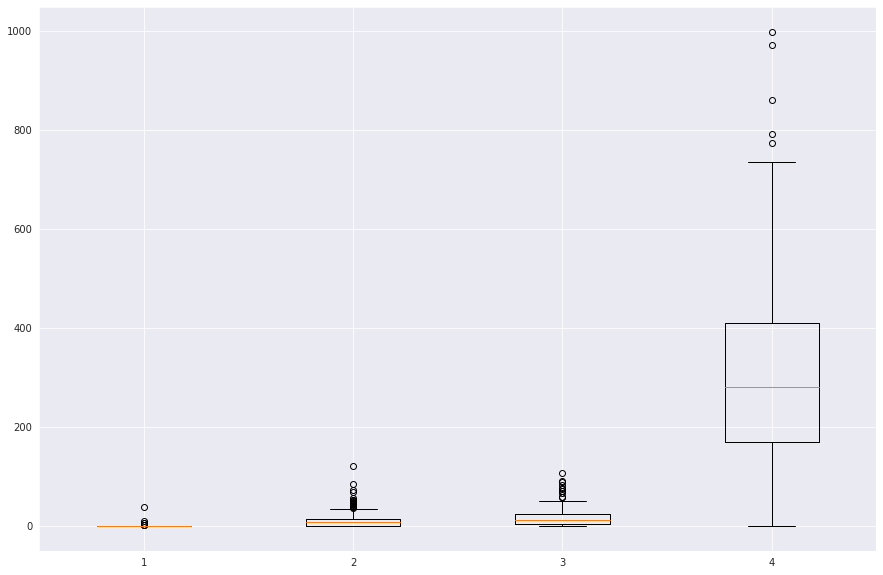

In [ ]:
rdn_gene_1 = random.randrange(filtered_cells.shape[0])
rdn_gene_2 = random.randrange(filtered_cells.shape[0])
rdn_gene_3 = random.randrange(filtered_cells.shape[0])
rdn_gene_4 = random.randrange(filtered_cells.shape[0])

plt.figure(figsize=(15, 10))
plt.boxplot(x = [filtered_cells.iloc[rdn_gene_1, :], 
                 filtered_cells.iloc[rdn_gene_2, :],
                 filtered_cells.iloc[rdn_gene_3, :],
                 filtered_cells.iloc[rdn_gene_4, :]
                ])

This is why we proceed in a way that is analogus to the one proposed above but we use a non-parametric test to obrain the p-values, that is the **Wilcoxon-Mann-Whitney test** (alson known as the **Mann-Whitney U test**)

In [ ]:
p_val_row_np = {}
for i in range(np_filt_1.shape[0]):  
  p_val_row_np[i] = stats.mannwhitneyu(x=hypo_np.iloc[i,:], y=norm_np.iloc[i,:], alternative = 'two-sided').pvalue


We now proceed following the same structure as what we did before, just adapting the function used above.

Text(0.5, 1.0, 'p-value histogram')

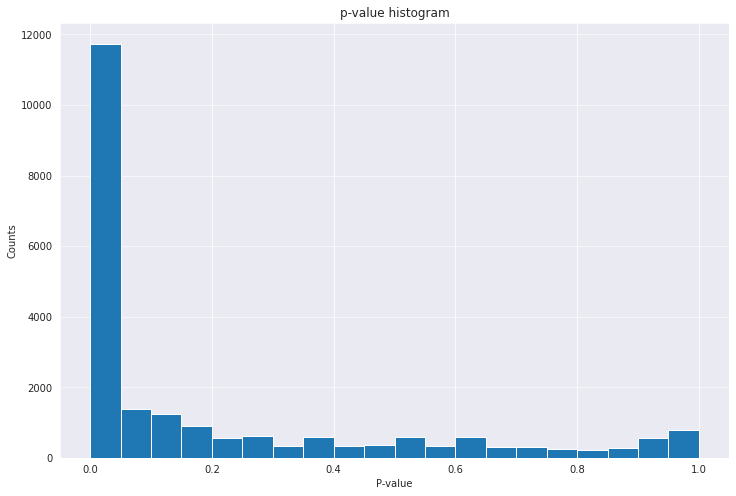

In [ ]:
plt.figure(figsize=(12,8))
plt.hist(p_val_row_np.values(),
         bins = 20)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('P-value')
plt.ylabel('Counts')
plt.title('p-value histogram')

In [ ]:
def filter_CPM_np(treshold):
  '''
  This function takes as input a CPM trashold and then it looks for each gene if there are
  at least two cells with the CPM that is over the given trashold. It then stores the indices
  of the genes that did NOT pass this barrier test.
  '''
  to_filter_list = []
  for i in range(np_filt_1.shape[0]):
    mask = [element for element in np_filt_1.iloc[i,:] if element >= treshold]
    if len(mask) <= 2:
      to_filter_list.append(i) 
  return to_filter_list

In [ ]:
def graph_data_due_np(p_val_pre):
  y_axis = []
  for treshold in np.arange(0, 20, 1):
    aux_dictt = p_val_pre.copy()
    indices = filter_CPM_np(treshold)
    print("how many genes will be ignored in this iteration", len(indices))
    for ind in indices:
      del aux_dictt[ind]
    count = len([value for value in q_value(aux_dictt) if value[1] <= 0.05])
    print("Relevant number of genes for this treshold", count)
    y_axis.append(count)
    aux_dictt = p_val_pre.copy()
  return y_axis

In [ ]:
y = graph_data_due_np(p_val_row_np)

how many genes will be ignored in this iteration 0
Relevant number of genes for this treshold 10757
how many genes will be ignored in this iteration 1375
Relevant number of genes for this treshold 10856
how many genes will be ignored in this iteration 3457
Relevant number of genes for this treshold 10843
how many genes will be ignored in this iteration 4346
Relevant number of genes for this treshold 10733
how many genes will be ignored in this iteration 4942
Relevant number of genes for this treshold 10633
how many genes will be ignored in this iteration 5383
Relevant number of genes for this treshold 10550
how many genes will be ignored in this iteration 5800
Relevant number of genes for this treshold 10438
how many genes will be ignored in this iteration 6098
Relevant number of genes for this treshold 10351
how many genes will be ignored in this iteration 6365
Relevant number of genes for this treshold 10260
how many genes will be ignored in this iteration 6608
Relevant number of gen

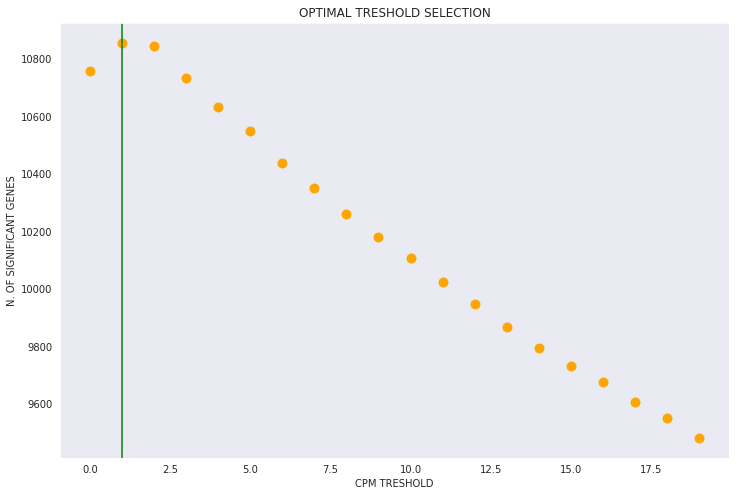

In [ ]:
x = np.arange(0, 20, 1)
plt.figure(figsize=(12,8))
plt.scatter(x, y,
            s = 80,
            color = "orange")
plt.grid()
plt.xlabel('CPM TRESHOLD')
plt.ylabel('N. OF SIGNIFICANT GENES')
plt.title('OPTIMAL TRESHOLD SELECTION')
plt.axvline(x=1, color = "green")
plt.show()

In [ ]:
#We calculate the optimal set of genes
indices_np = filter_CPM_np(2)
final_dictt_np = p_val_row_np.copy()

for ind in indices_np:
  del final_dictt_np[ind]

#Notice that the sensitivity setted is very very small: 0.001%
final_indices_np = [value[0] for value in q_value(final_dictt_np) if (value[1] <= 0.00001)]

In [ ]:
filt_lollo_2 = filtered_cells.copy().iloc[final_indices_np]
filt_lollo_2

,output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,output.STAR.1_A3_Norm_S3_Aligned.sortedByCoord.out.bam,output.STAR.1_A4_Norm_S4_Aligned.sortedByCoord.out.bam,output.STAR.1_A5_Norm_S5_Aligned.sortedByCoord.out.bam,output.STAR.1_A6_Norm_S6_Aligned.sortedByCoord.out.bam,output.STAR.1_B10_Hypo_S76_Aligned.sortedByCoord.out.bam,output.STAR.1_B11_Hypo_S77_Aligned.sortedByCoord.out.bam,output.STAR.1_B12_Hypo_S78_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
MTND2P28,2,1,0,1,3,6,16,15,3,0,...,0,0,4,2,1,0,2,7,29,5
MTCO1P12,2,1,0,3,10,5,5,1,5,2,...,0,1,7,4,0,1,5,0,4,3
MTCO2P12,0,1,0,0,1,2,1,0,0,0,...,0,0,1,1,0,0,5,0,0,0
MTATP6P1,29,12,68,203,691,206,766,331,46,27,...,25,50,294,214,131,49,370,33,228,71
MTCO3P12,0,0,0,0,2,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZMAT5,30,0,15,75,24,19,59,0,19,20,...,0,13,32,42,31,20,0,44,22,92
UQCR10,68,256,167,386,549,323,251,376,238,114,...,259,60,208,420,181,166,354,115,113,201
HORMAD2-AS1,0,12,0,2,0,3,0,7,4,0,...,0,0,3,1,0,0,0,3,7,5
CNN2P1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
counter = 0
for gene in proffilt.index.values:
  if gene in filt_lollo_2.index.values:
    counter +=1

print(f"Sovrapposition between our dataframe and provided dataframe: {counter/3000 *100}%")

Sovrapposition between our dataframe and provided dataframe: 23.799999999999997%


We see hat now the allignment with the provided dataframe is worse than before (this is expected as the data now are not normalized as before)

---


Loading the data of meta and MCF7 filtered and normalised

In [ ]:
meta = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_MetaData.tsv', delimiter = "\t", index_col = 0)
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt', delimiter = " ", index_col = 0)
print("data frame dimensions :", np.shape(df))
meta.head()

data frame dimensions : (3000, 250)


,Cell Line,Lane,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A10,Hypo,72,S28,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A11,Hypo,72,S29,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A12,Hypo,72,S30,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A1,Norm,72,S1,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A2,Norm,72,S2,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


In [ ]:
# t_meta = meta.T
# print(t_meta.shape)
# hypo_ind = (meta["Condition"] == "Hypo")
# hypo_ind = hypo_ind.to_numpy()
# norm_ind = (~(hypo_ind))
# norm_ind.sum()
# hypo_ind

### Dimensionality Reduction

> Throughout this section, we will be applying a Principal Components Analysis for the purpose of analyzing data and dimensionality reduction, as well as other dimensionality reduction techniques and discuss their outcomes.

We start by converting our Pandas DataFrame into a NumPy array.

In [ ]:
data = df.to_numpy()

Then, we extract the indices of hypoxic and normoxic cells and build two lists out of them

In [ ]:
l_hypoxia = get_condition_list(df, "Hypo")
l_normoxia = get_condition_list(df, "Norm")
print(len(l_normoxia))
l_hypoxia[:10], l_normoxia[:10]

126


([4, 5, 6, 7, 14, 15, 16, 17, 18, 23], [0, 1, 2, 3, 8, 9, 10, 11, 12, 13])

#### PCA

As we import the PCA function from the SKLearn library, we proceed to apply it to our dataset, requesting a 95% variance expression on the reduced outcome.

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pca = PCA(n_components = 0.95)
data_red = pca.fit_transform(data.T)
pca.n_components_

20

We can notice that we need 20 principal components, in order to express 95% of the variance.

In [ ]:
data_red.shape

(250, 20)

In [ ]:
pca.explained_variance_ratio_[:3]

array([0.6344835 , 0.09107496, 0.06270155])

We now plot the results, starting from a 2D scatter plot on the two main principal components.

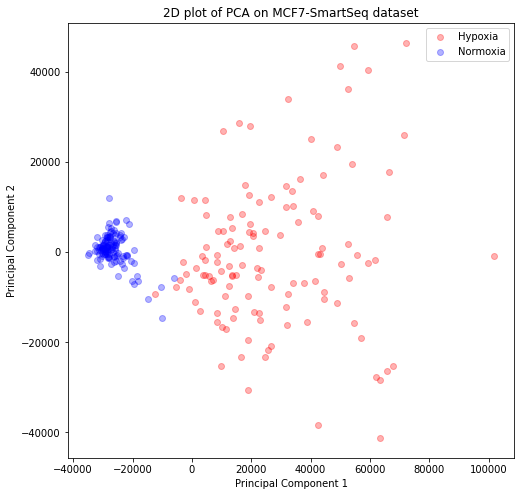

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_title('2D plot of PCA on MCF7-SmartSeq dataset')

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3, label="Normoxia")
ax.legend()
plt.show()

Next, we can again build a scatter plot, 3D this time, as we take into account the third principal component as well.

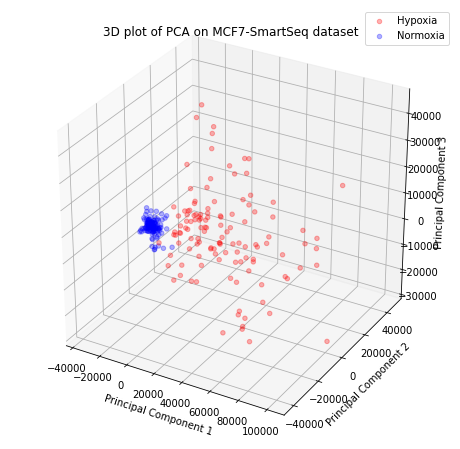

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D plot of PCA on MCF7-SmartSeq dataset')

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], data_red[l_hypoxia,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], data_red[l_normoxia,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

#### Interactive 3D version
> Might take a few minutes to run

Notice. The following implementation is quite time-consuming when executed on large-sized datasets (since a simpler static version of the 3D plot has been implemented above, we provide the code cell below commented).

In [ ]:
plot_df = pd.DataFrame(data_red[:, 0:3])
plot_df.columns = ["PC1","PC2","PC3"]

aux_lst = []
for name in df.columns.values:
  if 'Hypo' in name:
    aux_lst.append(1)
  elif 'Norm' in name:
    aux_lst.append(0)

plot_df["Color"] = aux_lst
plot_df

,x,y,z,Color
0,-26874.672396,766.013957,-880.248212,0
1,-26354.743000,5039.849020,-5372.826809,0
2,-29351.253485,2414.726753,-3076.254097,0
3,-24813.833293,-75.979072,-3934.877133,0
4,4454.732179,-1836.273354,-1595.912696,1
...,...,...,...,...
245,-18394.340467,-5274.416642,649.525614,0
246,-10023.164045,-14507.616731,-1941.969647,0
247,603.697715,11492.308191,43230.690452,1
248,17016.931253,8398.335833,4439.884803,1


In [ ]:
# !pip install jupyter-dash

import plotly.graph_objects as go
import plotly.express as px
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

fig = px.scatter_3d(
    data_frame = plot_df,
    x = "PC1",
    y = "PC2",
    z = "PC3",
    color = "Color",
    title = "Interactive PCA plot with supervised labels",
)

# build jupyter dash app 
app = JupyterDash(__name__)
# add html components and figure to app
app.layout = html.Div([dcc.Graph(figure=fig)])
# run app inline
app.run_server(mode='inline')

<IPython.core.display.Javascript object>

#### t-SNE


We first import TSNE from the SKLearn library

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

Now, PCA is carried out on the dataframe, and all the data is mapped into a 50-dimensional space.
PCA is performed as a sort of pre-processing stage because t-SNE does not work properly on datasets having too many features (in this case the initial dataset has 3000 features), so we need to reduce the dimensionality to about 50 (a number of features with which t-SNE produces good results).

In [ ]:
pca50 = PCA(n_components=50)
data_fifty = pca50.fit_transform(data.T)
data_fifty.shape

(250, 50)

In [ ]:
pca50.explained_variance_ratio_[0:4]

array([0.6344835 , 0.09107496, 0.06270155, 0.04033215])

We now apply t-SNE on the output of PCA (i.e. the data_fifty reduced dataset).

In [ ]:
embedded = TSNE(n_components=2, learning_rate='auto', init='random').fit_transform(data_fifty)

In [ ]:
embedded.shape

(250, 2)

We now plot the results.

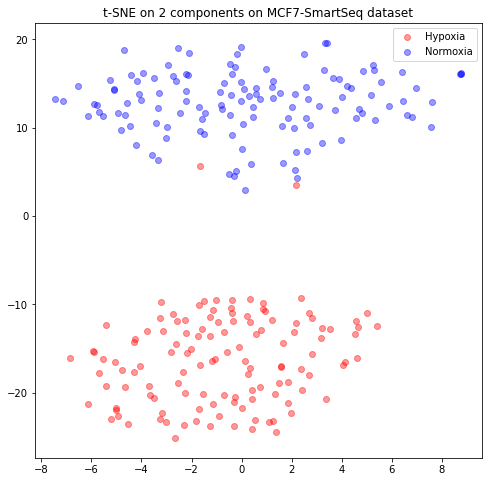

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.scatter(embedded[l_hypoxia,0], embedded[l_hypoxia,1], c="r",alpha = 0.4, label="Hypoxia")
ax.scatter(embedded[l_normoxia,0], embedded[l_normoxia,1], c="b",alpha = 0.4, label="Normoxia")
ax.set_title('t-SNE on 2 components on MCF7-SmartSeq dataset')
ax.legend()

plt.show()

We now try to visualize how the t-SNE plot changes as we introduce ‘pca’ as init. We would expect to get a scatterplot which is very close to the one described by the PCA function.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


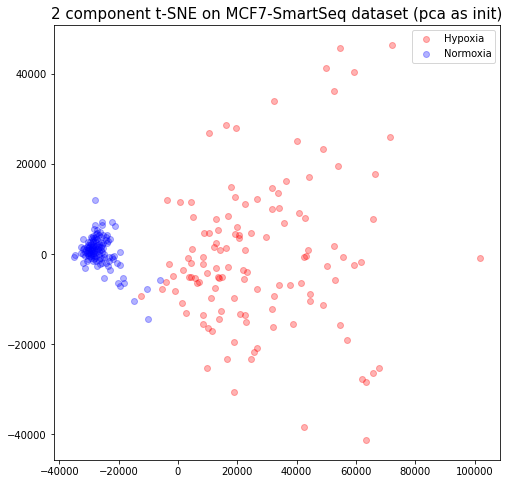

In [ ]:
embedded2 = TSNE(n_components=2, learning_rate='auto', init='pca').fit_transform(data_fifty)

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.set_title('2 component t-SNE on MCF7-SmartSeq dataset (pca as init)', fontsize = 15)

ax.scatter(embedded2[l_hypoxia,0], embedded2[l_hypoxia,1], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(embedded2[l_normoxia,0], embedded2[l_normoxia,1], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

Indeed, we can observe that this new plot displays a practically perfect match of the PCA plot.

#### UMAP

For a matter of completeness, we now try to implement Uniform Manifold Approximation and Projection. The idea behind this method is similar to t-SNE’s; the significant difference with t-SNE is scalability, it can be applied directly to sparse matrices thereby eliminating the need to applying any Dimensionality reduction such as PCA as a prior pre-processing step.

Let's first install the umap library

In [ ]:
!pip install umap-learn

     |████████████████████████████████| 88 kB 3.0 MB/s 
     |████████████████████████████████| 1.1 MB 40.7 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=ce75bd95b80eaa7196e8381fc04923b2f808201bc2b92e7c2a20cc713b4ff08c
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.7-py3-none-any.whl size=54286 sha256=f7e687ffcf649d46a44e5827938b3ddca0a60de035d4c051298bef1995aec004
  Stored in directory: /root/.cache/pip/wheels/7f/2a/f8/7bd5dcec71bd5c669f6f574db3113513696b98f3f9b51f496c
Successfully built umap-learn pynndescent


In [ ]:
from umap import UMAP

In [ ]:
reducer = UMAP()

embedding_data = reducer.fit_transform(data.T)
embedding_data.shape

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


(250, 2)

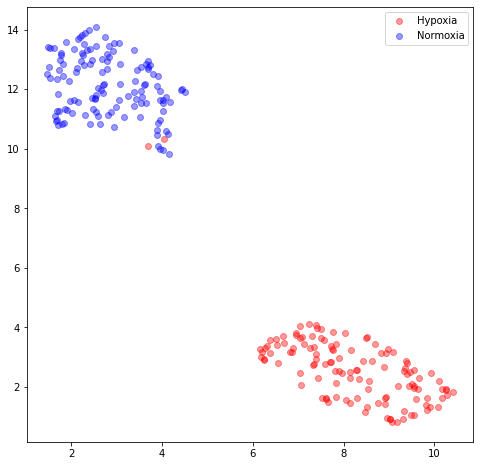

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.scatter(embedding_data[l_hypoxia, 1], embedding_data[l_hypoxia,0], c="r",alpha = 0.4, label="Hypoxia")
ax.scatter(embedding_data[l_normoxia, 1], embedding_data[l_normoxia,0], c="b",alpha = 0.4, label="Normoxia")
ax.legend()
plt.show()

### Clustering methods

For this first dataframe, we will implement the clustering techniques on the entire dataset, given its reasonably small size.

#### K-means

In this Section we will use the K-Means Algorithm in order to cluster our data. 

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans = KMeans(n_clusters=2, random_state=42)
pred_clus = kmeans.fit_predict(data.T)

In [ ]:
hypo = (pred_clus == 1)
norm = (pred_clus == 0)

We will now plot data using our original labeling againts the labeling obtained through K-Means

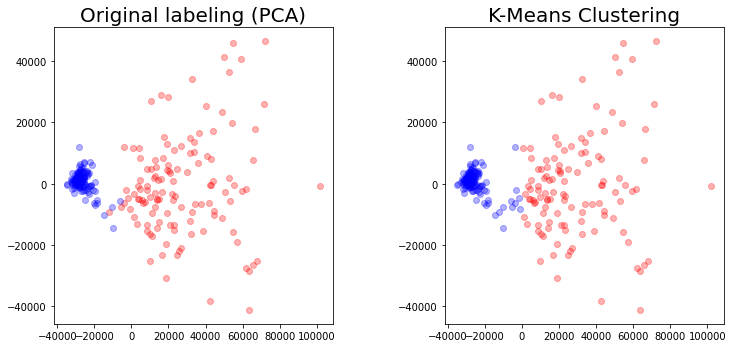

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(data_red[hypo,0],data_red[hypo,1], c="r",alpha = 0.3)
ax1.scatter(data_red[norm,0],data_red[norm,1], c="b",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

Here follow some visualization plots of clustering in both 3D and using decision boundaries with centroids

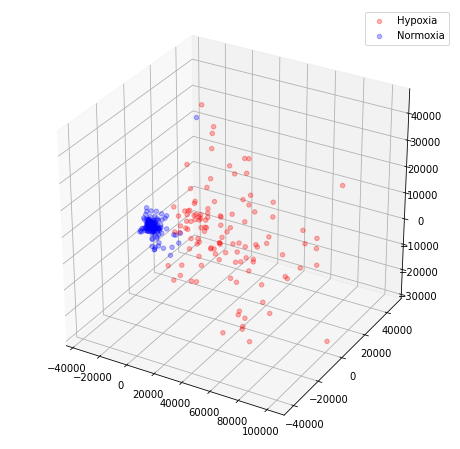

In [ ]:
fig = plt.figure(figsize=(8,8))

ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo,0],data_red[hypo,1], data_red[hypo,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm,0],data_red[norm,1], data_red[norm,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

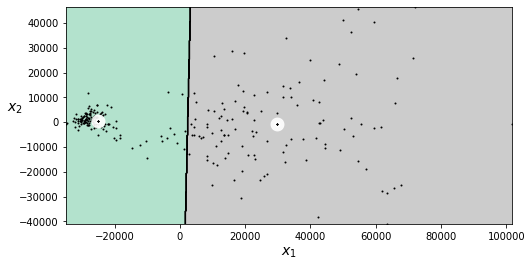

In [ ]:
kmeans.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 4))
plot_decision_boundaries(kmeans, data_red[:, 0:2])
plt.show()

The prediction seems quite comparable with the actual labeling.

#### Gaussian mixture

In this part we try to cluster our data using a different technique, namely Gaussian Mixture Method.

In [ ]:
from sklearn.mixture import GaussianMixture

gm = GaussianMixture(n_components=2, random_state=42,
                     covariance_type = "diag")

In [ ]:
pred_mix = gm.fit_predict(data.T)

In [ ]:
hypo_mix = (pred_mix == 1)
norm_mix = (pred_mix == 0)

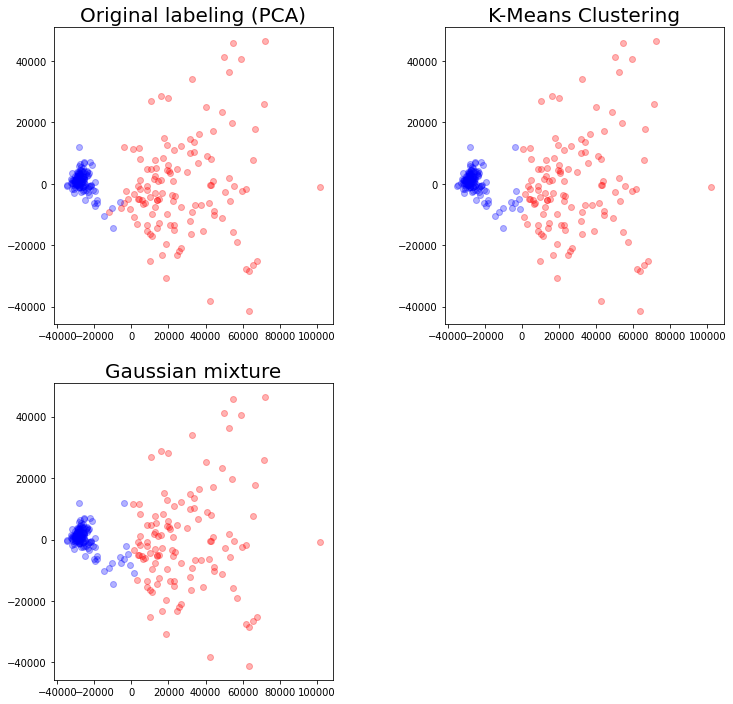

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax2 = fig.add_subplot(2,2,3)
ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(data_red[hypo,0],data_red[hypo,1], c="r",alpha = 0.3)
ax1.scatter(data_red[norm,0],data_red[norm,1], c="b",alpha = 0.3)

ax2.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(data_red[norm_mix,0],data_red[norm_mix,1], c="b",alpha = 0.3)


plt.subplots_adjust(wspace=0.4)

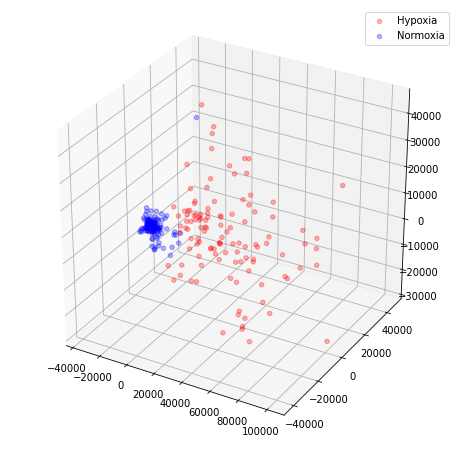

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], data_red[hypo_mix,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm_mix,0],data_red[norm_mix,1], data_red[norm_mix,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

In the following cell we plot the decision boundaries of Gaussian Mixture Clustering, which we notice (the red dotted line) being slightly accurate then kmeans.

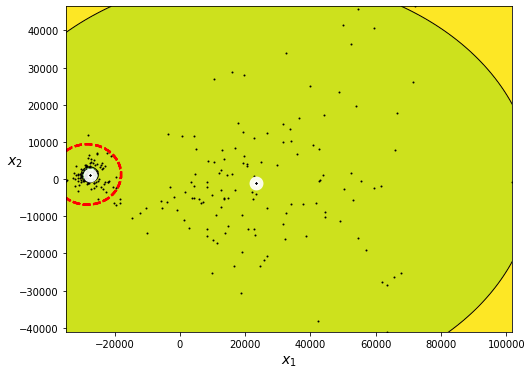

In [ ]:
gm.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 6))
plot_gaussian_mixture(gm, data_red[:, 0:2])
plt.show()

#### Bayesian Gaussian Mixture


Here we try to implement a different yet similar method to Gaussian Mixture. 

The Bayesian Gaussian Mixture is a method which allows you to not know the exact number of clusters in your data, in a sense it is better because by using a prior it understands how many clusters there should be.

In [ ]:
from sklearn.mixture import BayesianGaussianMixture

In [ ]:
bgm = BayesianGaussianMixture(n_components = 2, random_state = 42)
pred_bgm = bgm.fit_predict(data.T)

In [ ]:
hypo_bgm = (pred_bgm == 1)
norm_bgm = (pred_bgm == 0)

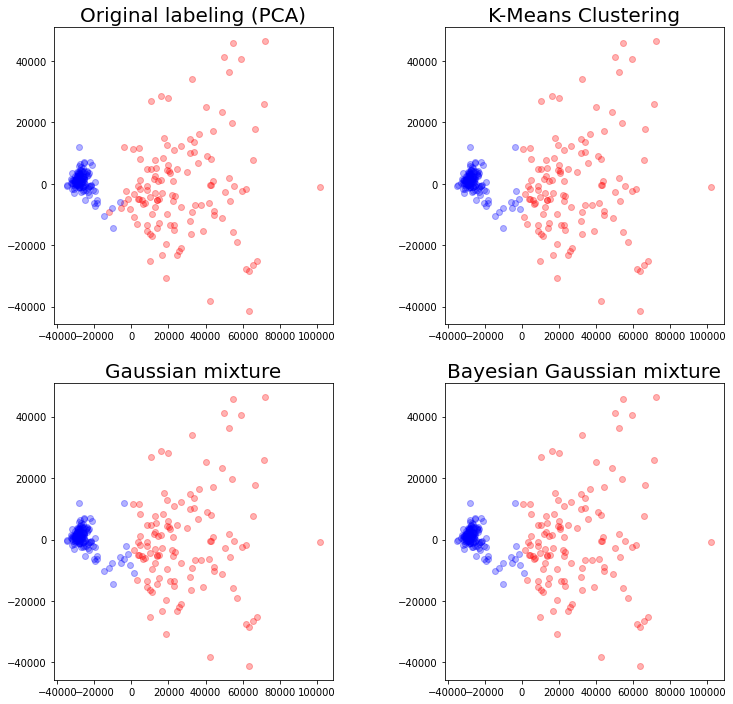

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,4)

ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax3.set_title('Bayesian Gaussian mixture', fontsize = 20)

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(data_red[hypo,0],data_red[hypo,1], c="r",alpha = 0.3)
ax1.scatter(data_red[norm,0],data_red[norm,1], c="b",alpha = 0.3)

ax2.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(data_red[norm_mix,0],data_red[norm_mix,1], c="b",alpha = 0.3)

ax3.scatter(data_red[hypo_bgm,0],data_red[hypo_bgm,1], c="r",alpha = 0.3)
ax3.scatter(data_red[norm_bgm,0],data_red[norm_bgm,1], c="b",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

In [ ]:
# bgm.predict_proba(data_red[:, 0:2])

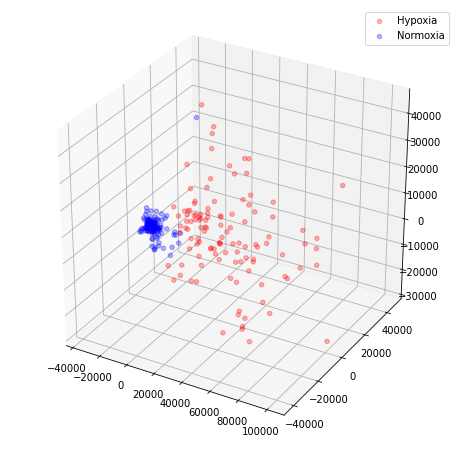

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo_bgm,0],data_red[hypo_bgm,1], data_red[hypo_bgm,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm_bgm,0],data_red[norm_bgm,1], data_red[norm_bgm,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

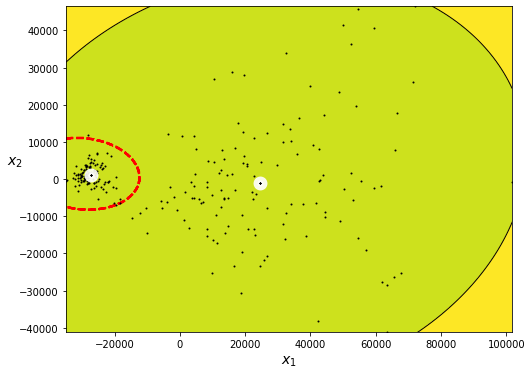

In [ ]:
bgm.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 6))
plot_gaussian_mixture(bgm, data_red[:, 0:2])
plt.show()

#### Agglomerative Clustering

We are also interested on the behavior and performance of hierarchical clustering methods. 
In agglomerative algorithms, each item starts in its own cluster, then, objects are recursively clustered by similarity, i.e. the distances between groups, two items at a time. Eventually, all items will be grouped in one cluster.
We choose to implement Agglomerative Clustering, as it is the most commonly used technique of this kind.

In [ ]:
from sklearn.cluster import AgglomerativeClustering

In [ ]:
aggl = AgglomerativeClustering(n_clusters=2)

In [ ]:
pred_aggl = aggl.fit_predict(data_red)

In [ ]:
hypo_aggl = (pred_aggl == 1)
norm_aggl = (pred_aggl == 0)

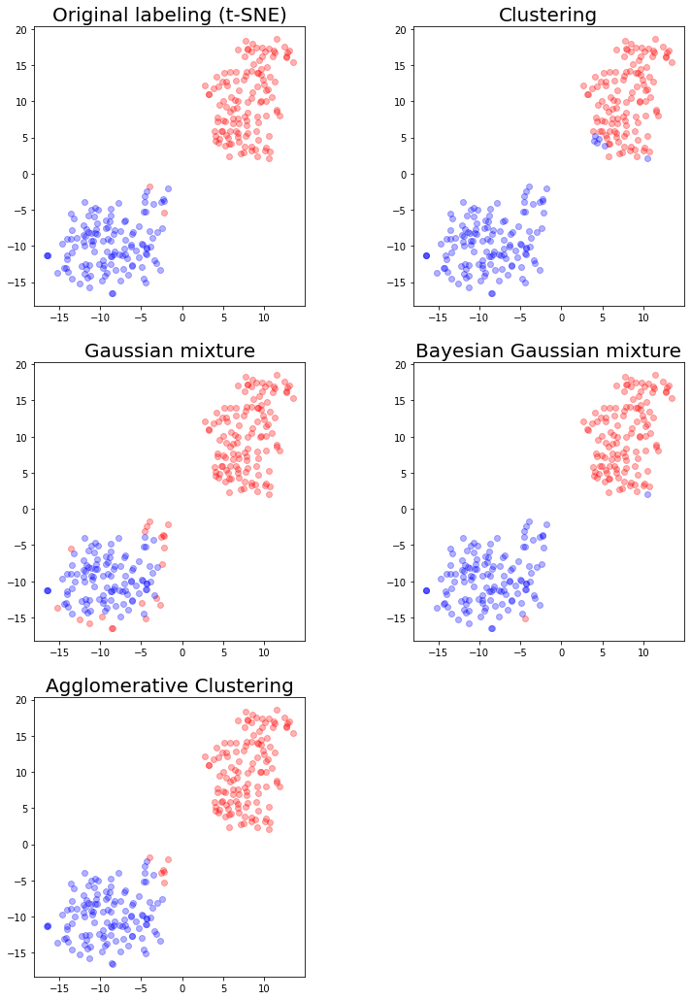

In [ ]:
fig = plt.figure(figsize = (12,18))
ax = fig.add_subplot(3,2,1)
ax1 = fig.add_subplot(3,2,2)
ax2 = fig.add_subplot(3,2,3)
ax3 = fig.add_subplot(3,2,4)
ax4 = fig.add_subplot(3,2,5)

ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax3.set_title('Bayesian Gaussian mixture', fontsize = 20)

ax4.set_title('Agglomerative Clustering', fontsize = 20)

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(data_red[hypo,0],data_red[hypo,1], c="r",alpha = 0.3)
ax1.scatter(data_red[norm,0],data_red[norm,1], c="b",alpha = 0.3)

ax2.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(data_red[norm_mix,0],data_red[norm_mix,1], c="b",alpha = 0.3)

ax3.scatter(data_red[hypo_bgm,0],data_red[hypo_bgm,1], c="r",alpha = 0.3)
ax3.scatter(data_red[norm_bgm,0],data_red[norm_bgm,1], c="b",alpha = 0.3)

ax4.scatter(data_red[hypo_aggl,0],data_red[hypo_aggl,1], c="b",alpha = 0.3)
ax4.scatter(data_red[norm_aggl,0],data_red[norm_aggl,1], c="r",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

This clustering method can be easily visualized in 2D plots known as dendograms, in which the clusters at each step of the algorithm can be clearly displayed. With the following cell, we will try to implement dendograms for each linkage method available for AgglomerativeClustering.

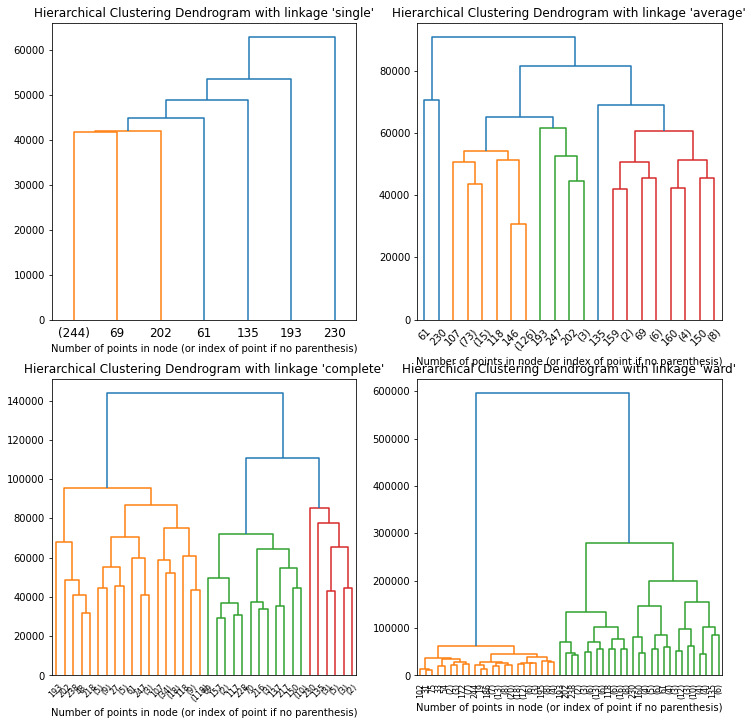

In [ ]:
# setting distance_threshold=0 ensures we compute the full tree.
l_linkage = ['single', 'average', 'complete', 'ward']

fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12,12))

for n, linkage in enumerate(l_linkage):
    model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, linkage=linkage)
    model = model.fit(data.T)

    ax = plt.subplot(2, 2, n + 1)
    # plot the top five levels of the dendrogram
    plot_dendrogram(model, truncate_mode="level", p=5)
    ax.set_title("Hierarchical Clustering Dendrogram with linkage " + "'" + linkage + "'")
    ax.set_xlabel("Number of points in node (or index of point if no parenthesis)")

plt.show()

#### Evaluating Clustering methods 

We will now look at how the various clusterings perform in understanding whether a cell is Hypoxic or not.

In [ ]:
y = []
for i in range(len(l_hypoxia) + len(l_normoxia)):
  if i in l_hypoxia:
    y.append(1)
  elif i in l_normoxia:
    y.append(0)

##### K Means Clustering

In [ ]:
y_pred_clus = kmeans.fit_predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_clus==y))
print("fraction of correct predictions", np.sum(y_pred_clus==y) / len(y_pred_clus))

correct predictions:  243
fraction of correct predictions 0.972


##### Gaussian Mixture

In [ ]:
gm.fit(data.T)
y_pred_mix = gm.predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_mix==y))
print("fraction of correct predictions", np.sum(y_pred_mix==y) / len(y_pred_mix))

correct predictions:  242
fraction of correct predictions 0.968


##### Bayesian Gaussian Mixture

In [ ]:
bgm.fit(data.T)
y_pred_bgm = bgm.predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_bgm==y))
print("fraction of correct predictions", np.sum(y_pred_bgm==y) / len(y_pred_bgm))

correct predictions:  242
fraction of correct predictions 0.968


##### Agglomerative Clustering

In [ ]:
y_pred_aggl = aggl.fit_predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_aggl!=y))
print("fraction of correct predictions", np.sum(y_pred_aggl!=y) / len(y))

correct predictions:  245
fraction of correct predictions 0.98


By observing these results, we can conclude that all clustering methods implemented above, be them Kmeans, GM, or BGM, perform with a significant degree of accuracy on this dataset.

### Classifiers

#### Opening Files

In [ ]:
meta = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_MetaData.tsv', delimiter = "\t", index_col = 0)
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt', delimiter = " ", index_col = 0)
print("data frame dimensions :", np.shape(df))
meta.head()

data frame dimensions : (3000, 250)


,Cell Line,Lane,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.1_A10_Hypo_S28_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A10,Hypo,72,S28,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A11_Hypo_S29_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A11,Hypo,72,S29,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A12_Hypo_S30_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A12,Hypo,72,S30,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A1_Norm_S1_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A1,Norm,72,S1,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.1_A2_Norm_S2_Aligned.sortedByCoord.out.bam,MCF7,output.STAR.1,A2,Norm,72,S2,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


In this section we will test various models for classification of Hypoxic and Normoxic cells. In particular, we will run the following classification models:  

1.   Random Forest
2.   Gradient Boosting
3.   Support Vector Machine

Our goal is to test their performance on a portion of the data which will not be seen by the model during the learning and fitting phase. 
In order to tune the main hyperparameters of the models and to select the best parameters, we will run a Grid Search whose size depends on the amount of data we are working with (so we can expect a larger grid for the SmartSeq datasets, which are smaller than the DropSeq datasets).
We will then report the accuracy of the models on the test set and select the best-performing model according to that metric.

As a technical note, the models in the notebook are defined always using the same pipeline, i.e.:

1.   Create and run the classifier with default parameters
2.   Run grid search and find the best parameters
3.   Run the model with the best parameters chosen by grid search and evaluate it.



As a first step, we add a "Condition" column to the original dataset, transposed.
The condition column will contain a 1 if the corresponding line (i.e. the corresponding cell) is Hypoxic and it will contain a 0 if the corresponding cell is Normoxic.

We then use the train_test_split() function to create a train set and a test on which to fit our models and evaluate them.

In [ ]:
from sklearn.model_selection import train_test_split

MC_smart_T = df.T
X = MC_smart_T.to_numpy()

condition = []
for i in list(MC_smart_T.index):
  if "Norm" in i:
    condition.append(0)
  if "Hypo" in i:
    condition.append(1)
MC_smart_T["Condition"] = condition

y = np.array(condition)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 42)

In [ ]:
(X_train.shape, X_test.shape)

((187, 3000), (63, 3000))

####Random Forest

We will implement a Random Forest 

In [ ]:
from sklearn.model_selection import GridSearchCV
from  sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(criterion = "gini", random_state=42)

# Define the grid of parameters which will be used by GridSearchCV()
p_grid = {'n_estimators': [15, 30, 80, 150, 250],
          'criterion': ["gini", "entropy"],
          'min_samples_leaf': [1, 2]}

gs = GridSearchCV(rfc, param_grid = p_grid).fit(X_train, y_train)
gs.best_params_ # gives the parameters selected by Grid search

{'criterion': 'gini', 'min_samples_leaf': 1, 'n_estimators': 30}

In [ ]:
from  sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Creat a Classifier with the parameters chosen by Grid Search.
rfc = RandomForestClassifier(n_estimators = gs.best_params_['n_estimators'], 
                             min_samples_leaf = gs.best_params_['min_samples_leaf'], 
                             criterion = gs.best_params_["criterion"],
                             random_state = 42)

#fit the model on the train set
rfc.fit(X_train, y_train)
#create a prediction...
y_pred = rfc.predict(X_test)
#...and test it
accuracy_score(y_pred, y_test)

1.0

##### Visualizing the Random Forest

Visualizing the first n elements of a random forest 

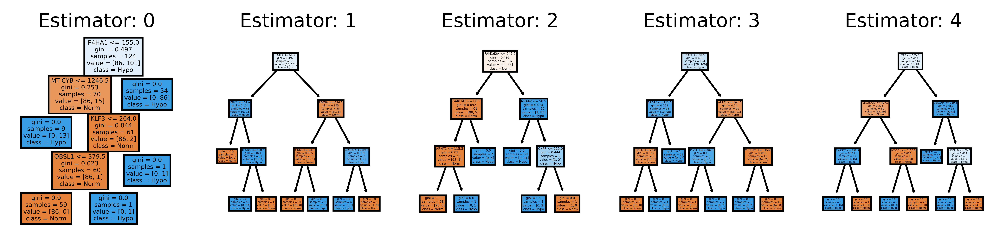

In [ ]:
from sklearn import tree
feature_names = MC_smart_T.columns

fig, axes = plt.subplots(nrows = 1,ncols = 5,figsize = (10,2), dpi=900)
for index in range(0, 5):
    tree.plot_tree(rfc.estimators_[index],
                   feature_names = feature_names, 
                   class_names = {0: 'Norm', 1: 'Hypo'},
                   filled = True,
                   ax = axes[index]);

    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
fig.savefig('rf_5trees.png')

##### Feature Importance

We now want to find a list of the genes that most significantly differ between Normoxic and Hypoxic cells, according to the Random Forest model.

Next we will plot something interesting.

This is the importance of each gene in predicting the right classfication.

The *feature_importances_* looks at the most important features in the model, and understands which are those with the highest appearence frequency when making the splits

In [ ]:
imp = rfc.feature_importances_
q = np.quantile(imp, 0.98)
gene = []
for name, score in zip(list(MC_smart_T.iloc[:,:-1].columns), rfc.feature_importances_):
  if score >= q:
    gene.append((name,score))
#sort the genes in decreasing order of feature importance
gene.sort(key = lambda x : x[1],reverse=True)

#print the names of the genes
genes = [i[0] for i in gene]
for i in genes:
    print(i,end=" ")

genesM = genes

GPI FAM162A P4HA1 MT-CYB ARPC1B DOLK BNIP3 BNIP3L CYP1B1 CRELD2 ENO2 ALDOA DDIT4 NECTIN2 RHOD G6PC3 MT-ATP8 FDFT1 GFRA1 KPNA2 SRM TES IER5L C1QTNF6 ZNF395 OLFM1 SLC25A39 HK2 TST PFKFB4 MTATP6P1 ERO1A RAMP1 QSOX1 TXNRD1 MPV17L2 DUSP10 AP1B1 FTH1 PDZK1 DSP DAPK2 DCXR TMEM255B GAREM1 GPR87 CYB561A3 MT-CO1 RIMKLA PGM1 PDK1 TM7SF2 NEDD9 MECOM QPRT ABHD14A-ACY1 LY6E HSPA1B GATA3 SLC9A3R1-AS1 

In [ ]:
for i in genesH: 
  for j in genesM:
    if i == j:
      print(i)


ERO1A
BNIP3
FAM162A
BNIP3L
P4HA1
SRM


We now give this gene list to DAVID database and here below you can find the result

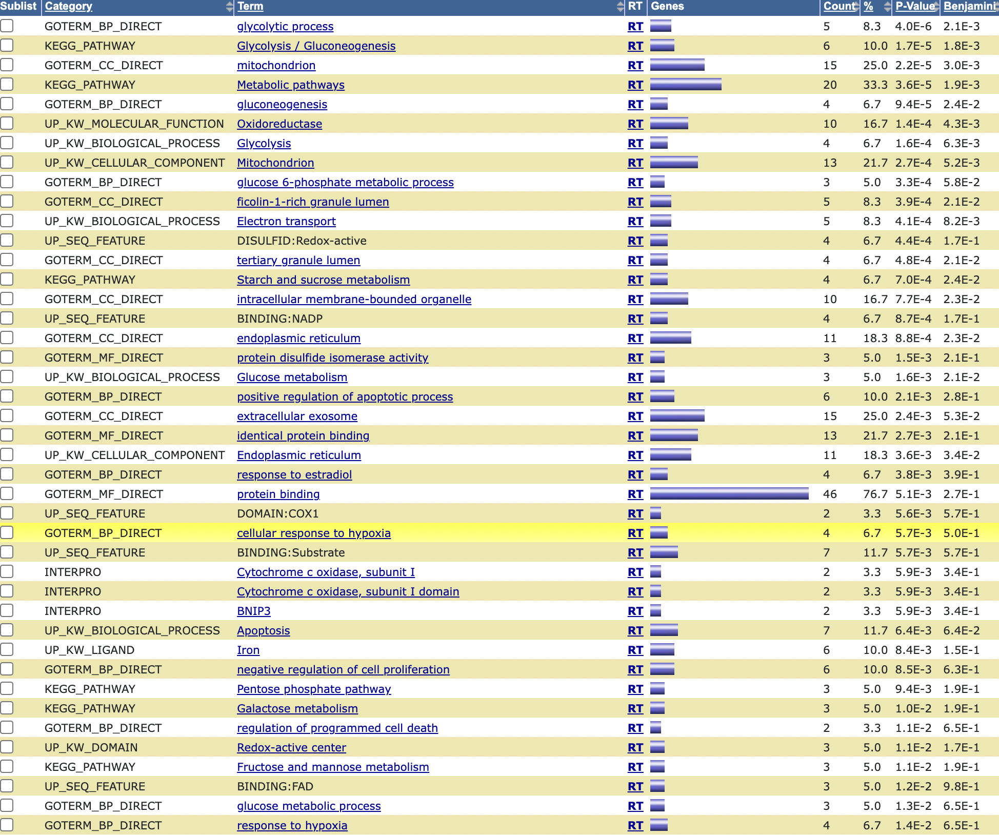

From this image, not to enter in much detail, we can see that from the genes recoverd using feature_importance_ 4 of them can be directly related to "cellular responce to hypoxia", and another 4 of those to "response to hypoxia"

We will now plot just fewer genes for a nicer visualization of their relative feature importance. 

<BarContainer object of 27 artists>

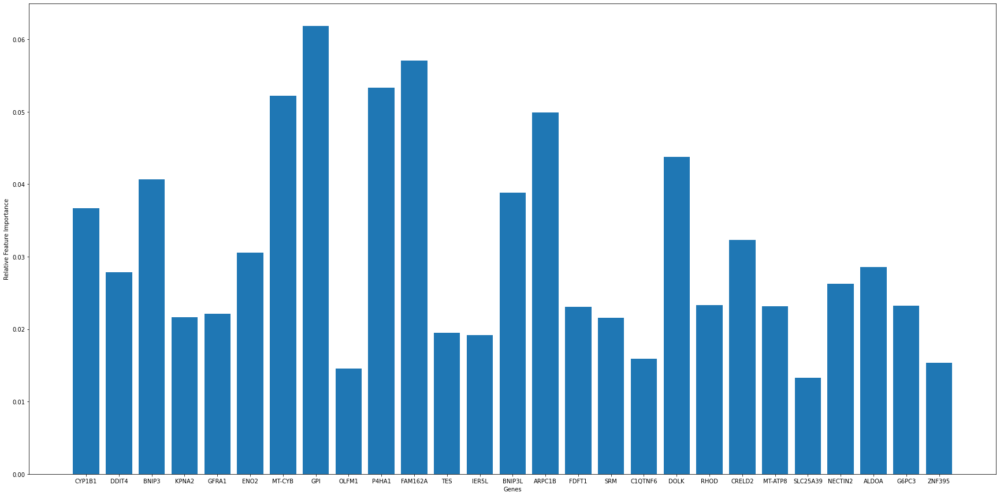

In [ ]:
plt.figure(figsize = (30,15))

g = []
s = []
for name, score in zip(list(MC_smart_T.iloc[:,:-1].columns), rfc.feature_importances_):
  if score >= 0.013:
    g.append(name)
    s.append(score)


plt.xlabel('Genes')
plt.ylabel("Relative Feature Importance")

plt.bar(g, s)

##### Analysing relationship between Principal Components and accuracy


Throughout this section we will perform PCA multiple times each time increasing the number of principal components and in the mean time fitting with the given number of principal components a random forest. 

After that we will plot for each dimensione the accuracy reached from each model and compare the results.

In [ ]:
df_train = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt", sep = " ")

In [ ]:
df_meta = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_MetaData.tsv", delimiter = "\t", header=0)
 
df_meta["Condition"] = df_meta.Condition.eq('Hypo').mul(1)

col_l= []
for j in list(df_train.columns): 
    for i , h in zip(df_meta["Filename"], df_meta["Condition"]):
        if j == i:
            col_l.append(h)

<BarContainer object of 19 artists>

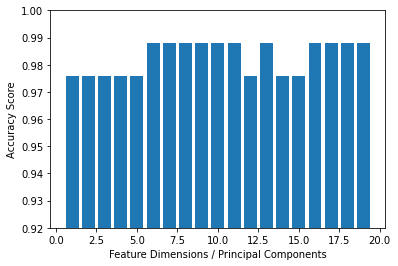

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from  sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score

acc_list = []
dim_list = [i for i in range(1, 20)]
for i in range(1, 20):

  #PCA
  X = df_train.to_numpy()
  X_t = np.transpose(X)
  pca = PCA(n_components = i)
  Xred = pca.fit_transform(X_t)
  df_red = pd.DataFrame(Xred)

  #Creating the classification framework 
  df_red["Classification"] = col_l

  X = df_red.iloc[:,:-1]
  y = df_red["Classification"]

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state = 42)

  #Fitting the random forest
  rfc = RandomForestClassifier(n_estimators = 100, 
                               min_samples_leaf = 1, 
                               min_samples_split = 2,
                               criterion="gini", random_state = 42)

  rfc.fit(X_train, y_train)
  y_pred = rfc.predict(X_test)
  acc_list.append(accuracy_score(y_pred, y_test))


#plotting the accuracy scores
plt.xlabel("Feature Dimensions / Principal Components")
plt.ylabel("Accuracy Score")
plt.ylim([0.92, 1])

plt.bar(dim_list, acc_list)

From the bar chart above we can easily see that our random forest easily reaches high levels of accuracy even with few principal components, i.e. with less information 

####Gradient Boosting

Here we will use another type of classifier, Gradient Boosting.

We will firstly perform a grid search over some of the parameters of our model.

In [ ]:
from sklearn.model_selection import train_test_split

MC_smart_T = df.T
X = MC_smart_T.to_numpy()

condition = []
for i in list(MC_smart_T.index):
  if "Norm" in i:
    condition.append(0)
  if "Hypo" in i:
    condition.append(1)
MC_smart_T["Condition"] = condition

y = np.array(condition)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 42)

In [ ]:
(X_train.shape, X_test.shape)

((187, 3000), (63, 3000))

In [ ]:
(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

((167, 3000), (83, 3000))

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

gb_clf = GradientBoostingClassifier(random_state = 42)

p_grid = {'max_features' : [5, 10, 25, 40], 
          'max_leaf_nodes' : [2, 4, 8, 16],
          'n_estimators' : [20, 40, 60, 80, 100, 150, 200]}

gs = GridSearchCV(gb_clf, param_grid = p_grid).fit(X_train, y_train)
gs.best_params_

{'max_features': 25, 'max_leaf_nodes': 2, 'n_estimators': 150}

In [ ]:
gb_clf = GradientBoostingClassifier(learning_rate = 0.1,
                                    max_features = gs.best_params_['max_features'],
                                    max_leaf_nodes = gs.best_params_['max_leaf_nodes'],
                                    n_estimators = gs.best_params_['n_estimators'])

gb_clf.fit(X_train, y_train)
y_pred = gb_clf.predict(X_test)
accuracy_score(y_pred, y_test)

1.0

####SVM

Yet again a different classifier, SVM and also here we will perform some cross validation to tune the hyperparameters

In [ ]:
from sklearn.model_selection import train_test_split

MC_smart_T = df.T
X = MC_smart_T.to_numpy()

condition = []
for i in list(MC_smart_T.index):
  if "Norm" in i:
    condition.append(0)
  if "Hypo" in i:
    condition.append(1)
MC_smart_T["Condition"] = condition

y = np.array(condition)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 42)

In [ ]:
(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

((167, 3000), (83, 3000), (167,), (83,))

In [ ]:
from sklearn.svm import SVC

svc = SVC()
parameters = {'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
              'C': [0.5, 1, 1.5, 2, 4, 6, 10],
              'gamma': ['scale', 'auto'],
              'degree': [2, 3, 4]}

clf = GridSearchCV(svc, parameters).fit(X_train, y_train)
clf.best_params_

{'C': 1, 'degree': 2, 'gamma': 'scale', 'kernel': 'poly'}

In [ ]:
svc = SVC(C=clf.best_params_["C"],
          kernel=clf.best_params_["kernel"],
          gamma=clf.best_params_["gamma"],
          degree=clf.best_params_["degree"])

svc.fit(X_train, y_train)
y_pred = svc.predict(X_test)
accuracy_score(y_pred, y_test)

0.9759036144578314

#### Soft-Voting Classifer

Implementing an important ensembeling method technique which will allow us to see the performances of different classifiers.

In [ ]:
from sklearn.model_selection import train_test_split

MC_smart_T = df.T
X = MC_smart_T.to_numpy()

condition = []
for i in list(MC_smart_T.index):
  if "Norm" in i:
    condition.append(0)
  if "Hypo" in i:
    condition.append(1)
MC_smart_T["Condition"] = condition

y = np.array(condition)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 42)

In [ ]:
from sklearn.ensemble import VotingClassifier, RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC

from sklearn.metrics import accuracy_score

log_clf = LogisticRegression(solver="lbfgs", random_state=42)
rnd_clf = RandomForestClassifier(n_estimators=100, random_state=42)
svm_clf = SVC(gamma="scale", probability=True, random_state=42) # whatch out for the variable probabilty

vot_clf = VotingClassifier([('lr', log_clf), ('rf', rnd_clf), ('svc', svm_clf)],
                           voting = 'soft')


for clf in (log_clf, rnd_clf, svm_clf, vot_clf):
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    print(clf.__class__.__name__, accuracy_score(y_test, y_pred))

LogisticRegression 1.0
RandomForestClassifier 1.0
SVC 0.9841269841269841
VotingClassifier 1.0


#### Neural Network

Throughout this section we will be implementing a Multi-Layer Perceptron using Keras a Tensorflow library.

$$                             $$

Import libraries and packages first

In [ ]:
import pandas as pd
import numpy as np
import matplotlib 
import os
import sklearn
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Dense

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Python ≥3.5
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20
import sklearn
assert sklearn.__version__ >= "0.20"

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 2.x
except Exception:
    pass

# TensorFlow ≥2.0 
import tensorflow as tf
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os



Import Keras and Tensor Flow


In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras.layers import Dense, Input, Flatten

In [ ]:
tf.__version__

'2.8.0'

In [ ]:
keras.__version__

'2.8.0'

Build correctly the data set on which we will construct our NN

We now import our dataset. After that, we construct a column indicating if the respective cell presents an hypoxia or normoxia condition

In [ ]:
df_meta = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_MetaData.tsv", delimiter = "\t", header=0) 

In [ ]:
df_test = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_Filtered_Normalised_3000_Data_test_anonim.txt", sep = ' ')
df_test_t = df_test.T

In [ ]:
df_train = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt", sep = " ")

In [ ]:
df_meta["Condition"] = df_meta.Condition.eq('Hypo').mul(1)

In [ ]:
col_l= []
for j in list(df_train.columns): 
    for i , h in zip(df_meta["Filename"], df_meta["Condition"]):
        if j == i:
            col_l.append(h)


In [ ]:
X = df_train.to_numpy()
X_t = np.transpose(X)

In [ ]:
df_red = pd.DataFrame(X_t)

In [ ]:
df_red["Classification"] = col_l

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

X = df_red.iloc[:,:-1]
y = df_red["Classification"]



For the purpouse of creating our classifier, we now divide our dataset in training and test set. We retain a part of the dataset to be used just for testing and not also for validation to avoid overfitting

In [ ]:
x_trainF, x_test, y_trainF, y_test = train_test_split(X, y, test_size=0.23, random_state=42)


In [ ]:
x_valid, x_train = x_trainF[:100], x_trainF[100:]
y_valid, y_train = y_trainF[:100], y_trainF[100:]

We now construct our MLP, using a pyramidal architecture. We found that it is the more effective way on how we can costruct our NN for this dataset

In [ ]:
model=Sequential()

In [ ]:
model.add(Dense(units= 512, activation= "relu", input_shape= (3000,)))
model.add(Dense(units= 256, activation= "relu"))
model.add(Dense(units= 128, activation= "relu"))
model.add(Dense(units= 128, activation= "relu"))
model.add(Dense(units= 128, activation= "relu"))
model.add(Dense(units= 64, activation= "relu"))
model.add(Dense(units= 1,activation = 'sigmoid'))


In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer=keras.optimizers.Adam(learning_rate=0.0001, decay = 0.1),
              metrics=['accuracy'])

In [ ]:
hist=model.fit(x = x_train, y = y_train, epochs=20, validation_data = (x_valid,y_valid))

Epoch 1/20


/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


3/3 [==============================] - 1s 142ms/step - loss: 47.0355 - accuracy: 0.5435 - val_loss: 5.5269 - val_accuracy: 0.7900
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 6.6702 - accuracy: 0.8125

/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


3/3 [==============================] - 0s 60ms/step - loss: 9.8007 - accuracy: 0.8043 - val_loss: 0.8538 - val_accuracy: 0.9500
Epoch 3/20
3/3 [==============================] - 0s 39ms/step - loss: 2.1551 - accuracy: 0.9565 - val_loss: 0.1821 - val_accuracy: 0.9900
Epoch 4/20
3/3 [==============================] - 0s 37ms/step - loss: 0.7929 - accuracy: 0.9891 - val_loss: 0.2976 - val_accuracy: 0.9900
Epoch 5/20
3/3 [==============================] - 0s 39ms/step - loss: 0.3914 - accuracy: 0.9891 - val_loss: 0.3906 - val_accuracy: 0.9800
Epoch 6/20
3/3 [==============================] - 0s 57ms/step - loss: 0.1613 - accuracy: 0.9891 - val_loss: 0.5163 - val_accuracy: 0.9700
Epoch 7/20
3/3 [==============================] - 0s 40ms/step - loss: 0.0070 - accuracy: 1.0000 - val_loss: 0.6656 - val_accuracy: 0.9700
Epoch 8/20
3/3 [==============================] - 0s 58ms/step - loss: 0.0113 - accuracy: 0.9891 - val_loss: 0.7522 - val_accuracy: 0.9700
Epoch 9/20
3/3 [======================

In [ ]:
model.evaluate(x_test, y_test)

2/2 [==============================] - 0s 10ms/step - loss: 4.4379e-12 - accuracy: 1.0000


[4.437930491846265e-12, 1.0]

With an accurate choice on how we construct our MLP, we obtain a 100% accuracy on the test set, confirming the fact that we were not overfitting

Saving figure keras_learning_curves_plot


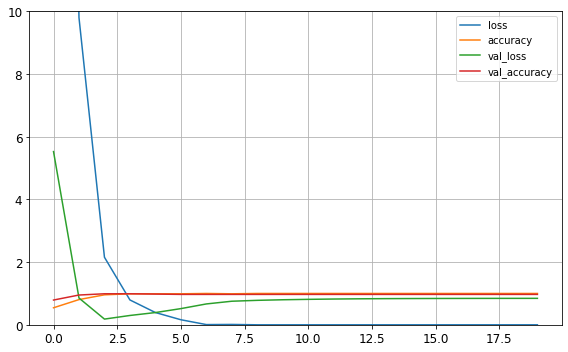

In [ ]:
import pandas as pd

pd.DataFrame(hist.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 10)
save_fig("keras_learning_curves_plot")
plt.show()

As we notice from above, we have plotted the accuracy and the loss on the training and validation set. We actually obtain a very smooth function: nice!




## HCC1806

For this part of the study we will simply report the plots obtained when it comes to study the HCC1086 cells. The sequencing techniques is the same of the plots above and also the sample size is comparable. Therefore, the differences that will be pointed out in this section will be related just to the cell type

##Exploratory data analysis and Data cleaning 


We start by loading the necessary libraries and load the first two datasets from our drive. Please notice that you'll need to change it, in order to match it with the path to the file on your local machine.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns
import random

In [ ]:
unfilt = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_Unfiltered_Data.txt', delimiter = " ", index_col = 0)
meta = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_MetaData.tsv', delimiter = "\t", index_col = 0)

We now see how the data is stored in these tables, looking at the first entries:
We notice that with respect to MCF7 Cells there's just a slightly difference in how the cells are named


In [ ]:
meta

,Cell Line,PCR Plate,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,HCC1806,1,A10,Normo,24,S123,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,HCC1806,1,A12,Normo,24,S26,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,HCC1806,1,A1,Hypo,24,S97,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,HCC1806,1,A2,Hypo,24,S104,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,HCC1806,1,A3,Hypo,24,S4,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
...,...,...,...,...,...,...,...,...
output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,HCC1806,4,H10,Normo,24,S210,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,HCC1806,4,H11,Normo,24,S214,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,HCC1806,4,H2,Hypo,24,S199,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


The second is the actual table containig the read counts as described above

In [ ]:
print("The dimension of this dataset is:", unfilt.shape,"\n")
unfilt

The dimension of this dataset is: (23396, 243) 



,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
CICP27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DDX11L17,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WASH9P,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,1,0,0
OR4F29,2,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,22,43,0,0,0,3,47,4,2,8,...,24,15,15,4,4,26,1,4,4,20
MT-CYB,4208,6491,25,4819,310,695,2885,1552,366,1829,...,1119,1429,808,999,916,3719,984,2256,981,2039
MT-TT,26,62,0,11,4,0,41,9,2,8,...,48,31,3,8,5,42,1,15,6,34
MT-TP,66,71,1,3,9,14,91,22,3,30,...,119,52,11,22,15,48,18,36,8,79


We can first check if the data type is always the same across the features in the dataframe

In [ ]:
assert [unfilt.T.dtypes[i] == 'int64' for i in range(len(unfilt.dtypes))]
#And this is the case

print("The number of missing values in this dataset is:", unfilt.isnull().sum(axis = 1).sum(axis = 0), "\n")
#Luckly enough there are not :)

dup_rows_unfilt = unfilt[unfilt.duplicated(keep=False)]
print("The number of duplicate rows is", dup_rows_unfilt.shape[0], "\n")

dup_rows_corr = dup_rows_unfilt.T.corr()

dup_dict = {}

for col in dup_rows_corr.columns:
  for row in dup_rows_corr.index:
    if (dup_rows_corr.loc[row, col] == 1 and row != col):
      if row not in dup_dict:
        dup_dict[row] = []
      dup_dict[row].append(col)

dup_dict

The number of missing values in this dataset is: 0 

The number of duplicate rows is 89 



{'ALPK2': ['C4orf45'],
 'AOX3P': ['RNY1P12'],
 'APLNR': ['LINC01361',
  'ITGA10',
  'GPA33',
  'C4orf50',
  'SMIM23',
  'VNN3',
  'TRPV6',
  'KCNA4',
  'CYCSP26',
  'OR5AU1',
  'CD300A',
  'DTNA',
  'PLVAP'],
 'ASS1P4': ['RPL10AP3'],
 'B3GAT1-DT': ['CPS1', 'COL2A1'],
 'C4orf45': ['ALPK2'],
 'C4orf50': ['LINC01361',
  'ITGA10',
  'GPA33',
  'SMIM23',
  'VNN3',
  'TRPV6',
  'KCNA4',
  'APLNR',
  'CYCSP26',
  'OR5AU1',
  'CD300A',
  'DTNA',
  'PLVAP'],
 'CCL3L1': ['CCL3L3'],
 'CCL3L3': ['CCL3L1'],
 'CCR4': ['KCNJ16'],
 'CD300A': ['LINC01361',
  'ITGA10',
  'GPA33',
  'C4orf50',
  'SMIM23',
  'VNN3',
  'TRPV6',
  'KCNA4',
  'APLNR',
  'CYCSP26',
  'OR5AU1',
  'DTNA',
  'PLVAP'],
 'CILP': ['RPL21P88'],
 'CNPY1': ['LINC01647'],
 'COL2A1': ['CPS1', 'B3GAT1-DT'],
 'CPS1': ['B3GAT1-DT', 'COL2A1'],
 'CUX2': ['LINC01247'],
 'CYCSP26': ['LINC01361',
  'ITGA10',
  'GPA33',
  'C4orf50',
  'SMIM23',
  'VNN3',
  'TRPV6',
  'KCNA4',
  'APLNR',
  'OR5AU1',
  'CD300A',
  'DTNA',
  'PLVAP'],
 'DTNA': ['LI

In [ ]:
#Here we drop the diplicate genes that we recorded
unfilt = unfilt.copy().drop_duplicates()

---
Now we turn our attention to the study of the correlation between cells. The result here is an average correlation that is a bit less the one obtained for the MCF7 data.

Average correlation between cells:  0.49929107365519126
Minimum correlation between cells:  -0.0014178526896174333 



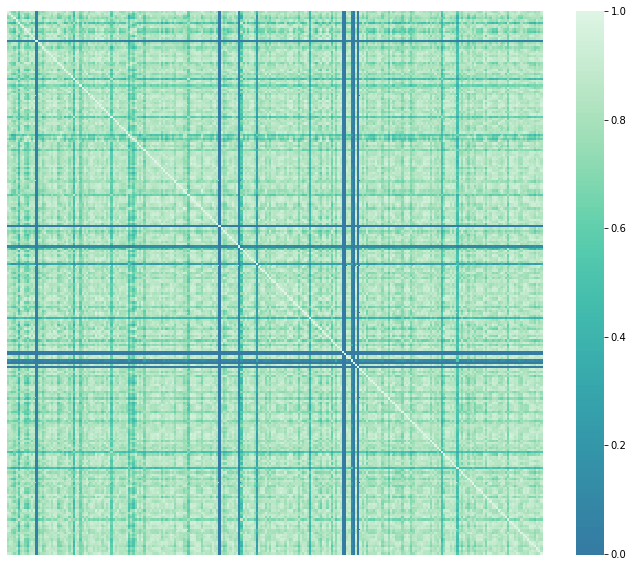

In [ ]:
plt.figure(figsize=(12,10))

corr = unfilt.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()

sns.heatmap(corr,cmap="mako", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

Again, we can see from the minimum value obtained that there are some cells that are completely uncorrelated from the others and we want to see why:

Text(0, 0.5, 'Frequency')

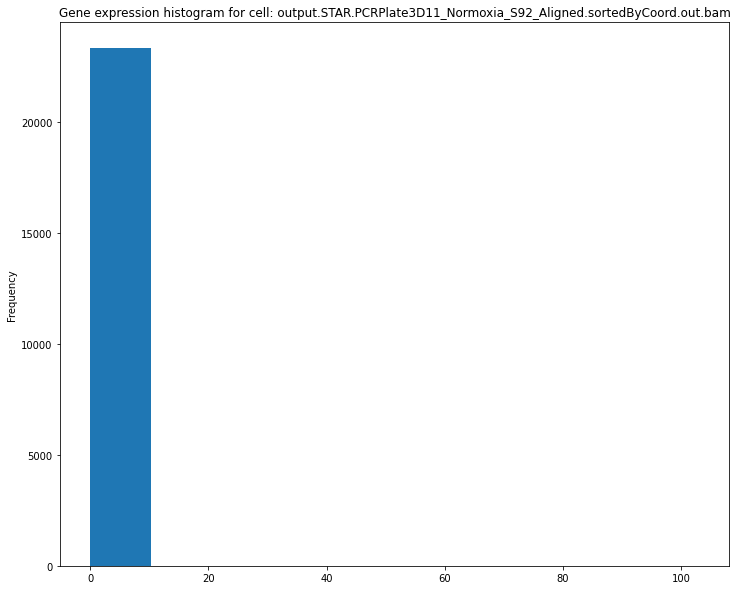

In [ ]:
plt.figure(figsize=(12,10))
#Given the symmetry of the table i look for low correlated cells in the first column, but
#that's completely arbirary
min  = np.argmin(list(corr[corr.columns.values[1]]))
plt.hist(unfilt.iloc[:,min])
plt.title(f"Gene expression histogram for cell: {unfilt.columns.values[min]}")
plt.ylabel("Frequency")

Here we can see the same result. These cells have zero count for every gene. These cells are abnormal and therefore will need to be removed.

We now want to analyse the structure among the covariates. Notice that here due to computational power issues we display the correlation just of the first 10% of the genes. 

Average correlation between cells:  0.40951765039846083
Minimum correlation between cells:  -0.1809646992030784 



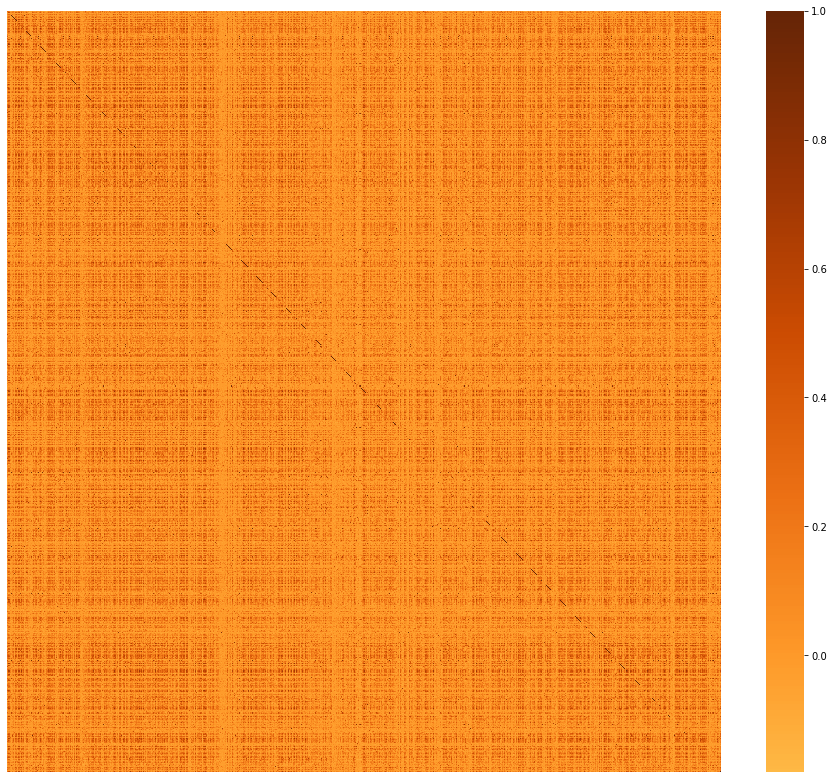

In [ ]:
plt.figure(figsize=(16,14))
#df_small = df.iloc[:, :50]
#c= df_small.corr()
corr = unfilt.iloc[:3000,:].T.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()
#sns.heatmap(c,cmap='coolwarm',annot=True, center=midpoint )
sns.heatmap(corr,cmap="YlOrBr", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

Even if we are dealing with just the 10% of the data we can clearly see how there's not a well defined structure among the genes. This can be paroblem if we consider the dimension of the dataset, some more structure for sure would have helped us in dimensionality reduction, for example, or in the task to find the so called "meta-genes". This average correlation is even less the one obtained for MCF7


---

Given what we've seen in the table `unfilt` we suspect that our dataset will be probably very sparsed, so we want to quantify that sparsity in some way. The first and more intutive one is to calculate the average sparsity and to plot the table in some way.

This average sparsity is almost 5% less than the one obtained in MCF7



In [ ]:
#Avarage density of zeros in the data

print(f"The average sparsity of the table is: {(unfilt == 0).sum().sum() / (unfilt.shape[0] * unfilt.shape[1]) * 100}%")

The average sparsity of the table is: 55.76545995438026%


Again, our dataset is definitely sparsed.

In the following plot we color with blue the points in the table that are different from zero. This can give us an idea of how this high sparsity is distributed across the dataset

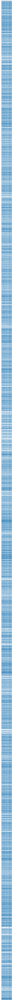

In [ ]:
plt.figure(figsize=(25, 600))
plt.spy(unfilt.iloc[:, :], markersize=1)

For the discussion of this plot see the one made for the SmarSeq MCF7 dataset, because it's analogus.

We describe the data to see some statistics of the distributions over the cells

In [ ]:
unfilt.describe()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
count,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,...,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000,23342.000000
mean,99.795947,208.126896,9.716391,151.004027,35.779496,47.197284,153.152643,136.182589,38.452660,45.617171,...,76.534359,105.796718,54.145146,29.829406,28.967484,104.975538,35.262874,108.445849,37.361109,76.472753
std,530.122968,982.196276,65.620267,978.042324,206.116742,545.993502,865.942966,871.712002,265.362499,367.122155,...,347.041462,537.480379,344.457045,186.932074,135.624956,445.260258,171.061263,589.740715,181.600602,369.500033
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000
75%,52.000000,126.000000,5.000000,40.000000,22.000000,17.000000,82.000000,76.000000,22.000000,18.000000,...,57.000000,67.000000,30.000000,18.000000,19.000000,76.000000,24.000000,68.000000,23.000000,45.000000
max,35477.000000,69068.000000,6351.000000,70206.000000,17326.000000,47442.000000,43081.000000,62813.000000,30240.000000,35450.000000,...,19629.000000,30987.000000,21894.000000,13457.000000,11488.000000,33462.000000,15403.000000,34478.000000,10921.000000,28532.000000


Text(0, 0.5, 'Frequency')

<Figure size 1440x1224 with 0 Axes>

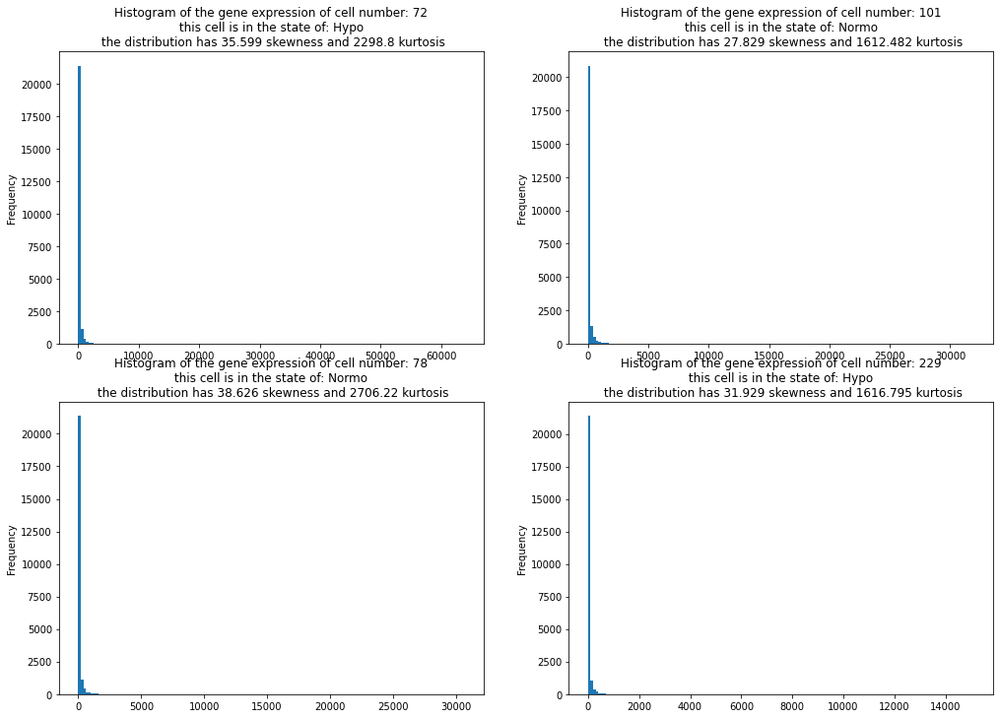

In [ ]:
from scipy.stats import kurtosis, skew

plt.figure(figsize=(20, 17))

first_cell = random.randrange(unfilt.shape[1])
second_cell = random.randrange(unfilt.shape[1])
third_cell = random.randrange(unfilt.shape[1])
fourth_cell = random.randrange(unfilt.shape[1])

plt.figure(figsize=(17, 12))

plt.subplot(2, 2, 1)
plt.hist(unfilt.iloc[:,first_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {first_cell}\n this cell is in the state of: {meta.iloc[first_cell, 3]} \n the distribution has {round(skew(unfilt.iloc[:,first_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,first_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 2)
plt.hist(unfilt.iloc[:,second_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {second_cell}\n this cell is in the state of: {meta.iloc[second_cell, 3]} \n the distribution has {round(skew(unfilt.iloc[:,second_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,second_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 3)
plt.hist(unfilt.iloc[:,third_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {third_cell}\n this cell is in the state of: {meta.iloc[third_cell, 3]} \n the distribution has {round(skew(unfilt.iloc[:,third_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,third_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 4)
plt.hist(unfilt.iloc[:,fourth_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {fourth_cell}\n this cell is in the state of: {meta.iloc[fourth_cell, 3]} \n the distribution has {round(skew(unfilt.iloc[:,fourth_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,fourth_cell]), 3)} kurtosis")
plt.ylabel("Frequency")



The distribution of gene counts for each cell is the sane as above, the discussion is analogus

---

We now study the distribution of counts for a single gene among the different cells in the sample

Text(0, 0.5, 'Frequency (possibly scaled)')

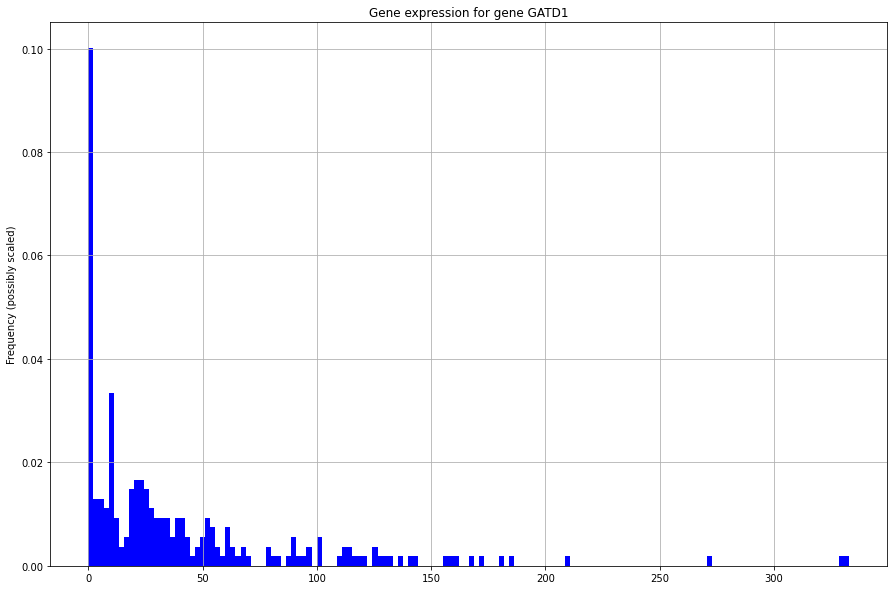

In [ ]:
rdn_gene = random.randrange(unfilt.shape[0])

plt.figure(figsize=(15, 10))
unfilt.iloc[rdn_gene, :].plot.hist(grid=True,
                                      density = True, 
                                      bins=150,
                                      color='blue')

plt.title(f"Gene expression for gene {unfilt.index[rdn_gene]}")
plt.ylabel("Frequency (possibly scaled)")

The important characteristics we want to point out are the same:
- A low number of counts associated with a large proportion of genes 
- A long right tail due to the lack of any upper limit for expression
- A large dynamic range

The distribution seems again to follow a Poisson/Negative binomial distribution.

And we remind why is it the case:
**With RNA-Seq data, a very large number of RNAs are represented and the probability of pulling out a particular transcript is very small**

--- 
Given what stated above, we further investigate the ralation between mean and variance of the gene expression among cells to see if we would prefer adopting a Negative Binomial ditribution:

Text(0, 0.5, 'Variance')

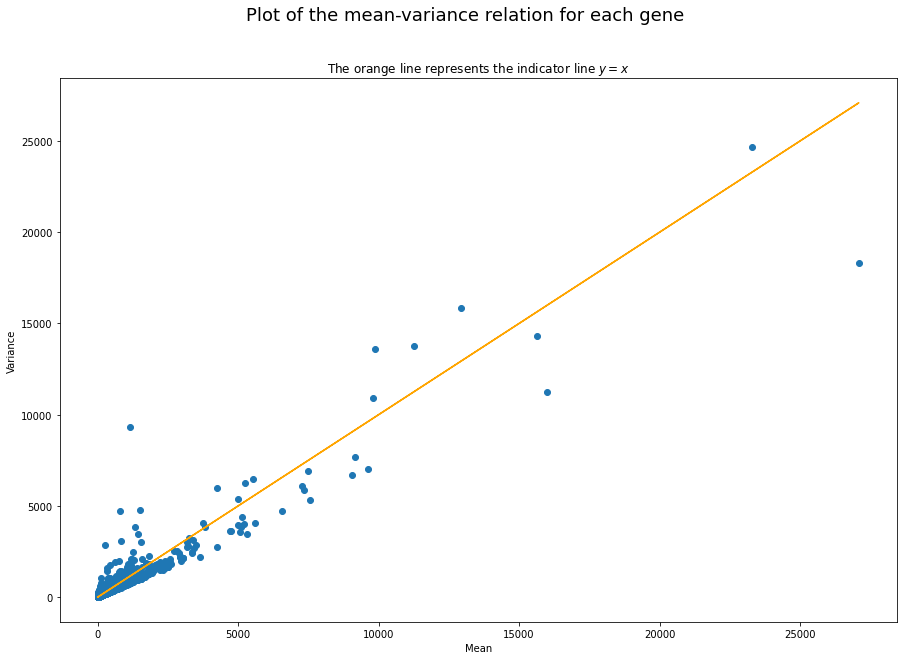

In [ ]:
##################### THIS PLOT COULD TAKE SOME TIME ########################
mean_vector = unfilt.T.describe().iloc[1,:]
var_vector = unfilt.T.describe().iloc[2,:]

plt.figure(figsize=(15, 10))
plt.scatter(mean_vector, var_vector)
plt.plot(mean_vector, mean_vector, color = "orange")
plt.title("The orange line represents the indicator line $y=x$", fontsize = 12)
plt.suptitle("Plot of the mean-variance relation for each gene", fontsize = 18)
plt.xlabel("Mean")
plt.ylabel("Variance")



Also here we see that there's a sort of linear 1:1 relation between mean and variance, we can try to use the Poisson distribution to model the gene expression and use it to identify **HVG** (Highly Variable Genes). Those will be the genes we want to keep when filtering (See the next part)

##Filtering and Normalization

###Cells filtering

We now check if the total reads among cells follow a normal distribution, meaning that the difference in total read counts it's just a measurement error. 

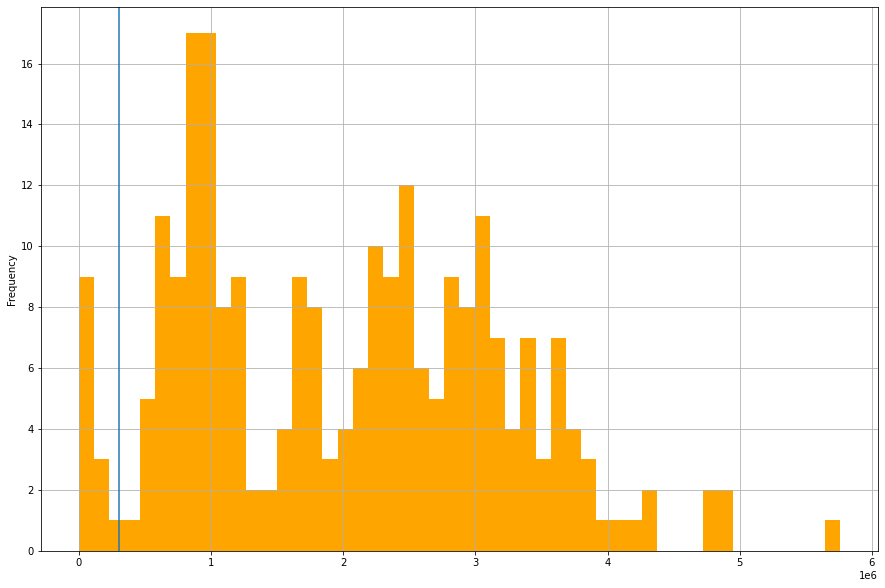

In [ ]:
totsums = unfilt.sum(axis = 0)

plt.figure(figsize=(15, 10))
plt.axvline(x=0.30e6) #Where do we want to do the cut in our filtering 
totsums.plot.hist(grid = True, bins = 50, color= "orange")

Now we want to plot an istogram of the number of genes different from zero for each cell, also this should follow a normal distribution (this is a stadard step in each analysis)

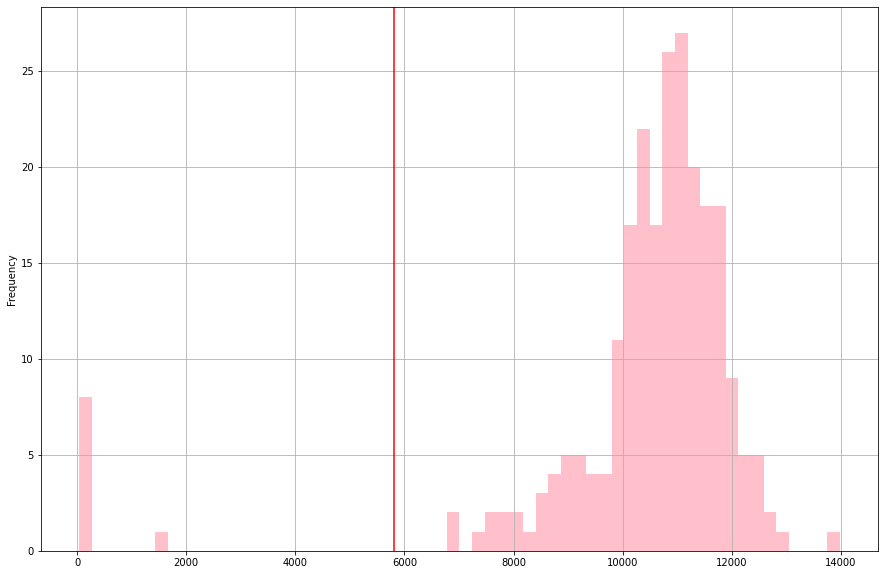

In [ ]:
#Create a copy dataframe where all the positive entries will become equal to one 
copy = unfilt.copy()
copy[copy != 0] = 1
totcopysums = copy.sum(axis = 0)

plt.figure(figsize=(15, 10))
plt.axvline(x=5800, color = "red") #Where do we want to do the cut in our filtering 
totcopysums.plot.hist(grid = True, bins = 60, color= "pink")

This last plot is even nicer that the one of MCF7! Also these plots are suggesting that indeed there's a measuement error following a normal distribution and therefore we would like to cut those cells that do not follow this curve, because their gene expression may be corrupted by human mistakes in extracting the data or by the health status of the cell itself.

Again, the blue vertical line in the first plot and the red one in the second indicate where (by eye) the plot finishes to be a nice bell-shaped histogram and thus where we want to cut in the filtering.


---

Here we proceed with the above described filtering

In [ ]:
filtered  = unfilt.loc[:, (totsums >= .30e6) & (copy.sum(axis = 0) >= 5800)]
perc_cell_lost = (unfilt.shape[1] - filtered.shape[1]) / unfilt.shape[1] * 100
print(f" We passed from haveing {unfilt.shape[1]} cells to have {filtered.shape[1]} cells\n This results in a lost of the {perc_cell_lost}% of the cells") 

 We passed from haveing 243 cells to have 230 cells
 This results in a lost of the 5.349794238683128% of the cells


In [ ]:
filtered

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
CICP27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DDX11L17,0,0,0,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
WASH9P,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,1,0,1,0,0
OR4F29,2,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,22,43,0,0,3,47,4,2,8,17,...,24,15,15,4,4,26,1,4,4,20
MT-CYB,4208,6491,4819,310,695,2885,1552,366,1829,3387,...,1119,1429,808,999,916,3719,984,2256,981,2039
MT-TT,26,62,11,4,0,41,9,2,8,9,...,48,31,3,8,5,42,1,15,6,34
MT-TP,66,71,3,9,14,91,22,3,30,37,...,119,52,11,22,15,48,18,36,8,79


We now want to study the percentage of mitochondrial RNA and cut those cells at a rate that is too high (above 4%/5% is the rule of thumb that we adopt here). You can see the discutssion above to see why is important to account for mithocondrial Rna in our filtering

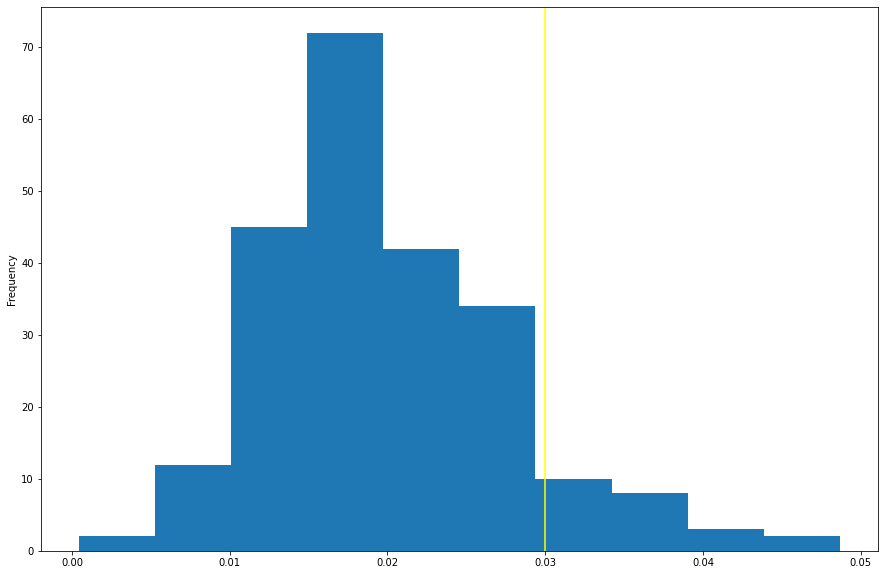

In [ ]:
total_mitocondrial = filtered[filtered.index.str.startswith('MT-')].sum(axis = 0)
total_express = filtered.sum(axis = 0)
assert len(total_mitocondrial) == len(total_express)

mito_ratio = total_mitocondrial / total_express

plt.figure(figsize=(15, 10))
plt.axvline(x=0.03, color = "yellow") #Where do we want to do the cut in our filtering
mito_ratio.plot.hist()

We filter cells with too much mitocondrial RNA

In [ ]:
filtered_cells = filtered.loc[:, mito_ratio <= 0.03]
filtered_cells

,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1B11_Normoxia_S127_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1B12_Normoxia_S27_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
CICP27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DDX11L17,0,0,0,1,0,0,0,1,1,0,...,0,0,0,0,0,0,0,0,0,0
WASH9P,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,1,0,1,0,0
OR4F29,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,43,0,0,3,47,4,2,17,17,15,...,24,15,15,4,4,26,1,4,4,20
MT-CYB,6491,4819,310,695,2885,1552,366,3387,7107,2384,...,1119,1429,808,999,916,3719,984,2256,981,2039
MT-TT,62,11,4,0,41,9,2,9,25,9,...,48,31,3,8,5,42,1,15,6,34
MT-TP,71,3,9,14,91,22,3,37,88,53,...,119,52,11,22,15,48,18,36,8,79


And this is the end for us of the filtering of the cells.

---

### Normalization

We first recall what is the distribution of a randomly choosen gene, this time within the cells that passed the filtering section

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Gene expression for gene TRPV1')

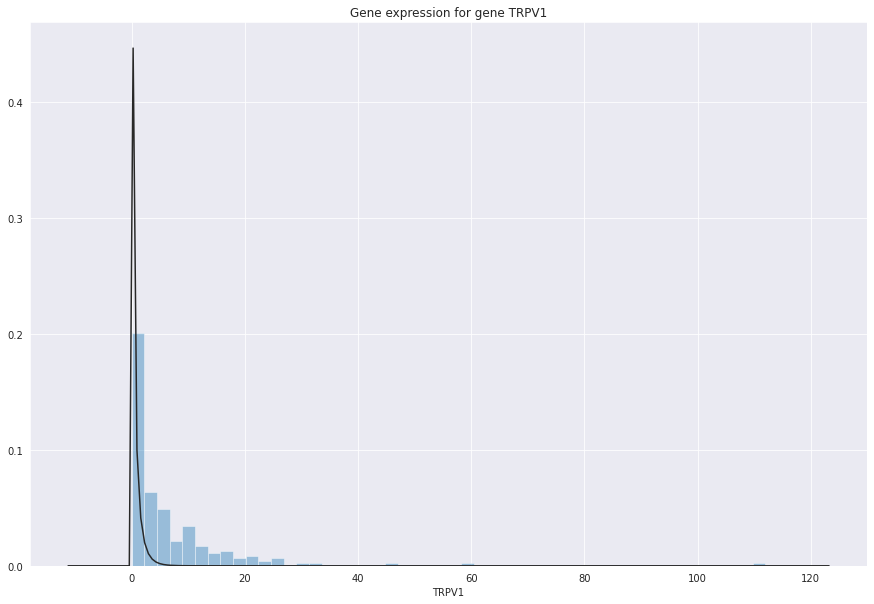

In [ ]:
rdn_gene = random.randrange(filtered_cells.shape[0])
plt.figure(figsize=(15, 10))
sns.set_style('darkgrid')
sns.distplot(filtered_cells.iloc[rdn_gene, :], fit=stats.gamma, 
                                          kde=False, 
                                          bins = 50)
plt.title(f"Gene expression for gene {unfilt.index[rdn_gene]}")


Here you see an histogram with a gamma distribution fitted.

We now want to check that normalizing for total reads across cells will change the distribution for our single gene. This is a normalization in Cell dimension and reading depth, if we want to perform comparisons within cells we need them to be indeed comparable.

In [ ]:
unfilt_CPM = filtered_cells.copy()

#CPM normalization 
for i in range(unfilt_CPM.shape[1]):
  unfilt_CPM.iloc[:,i] = unfilt_CPM.iloc[:,i]/(sum(unfilt_CPM.iloc[:,i])/10e6)


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


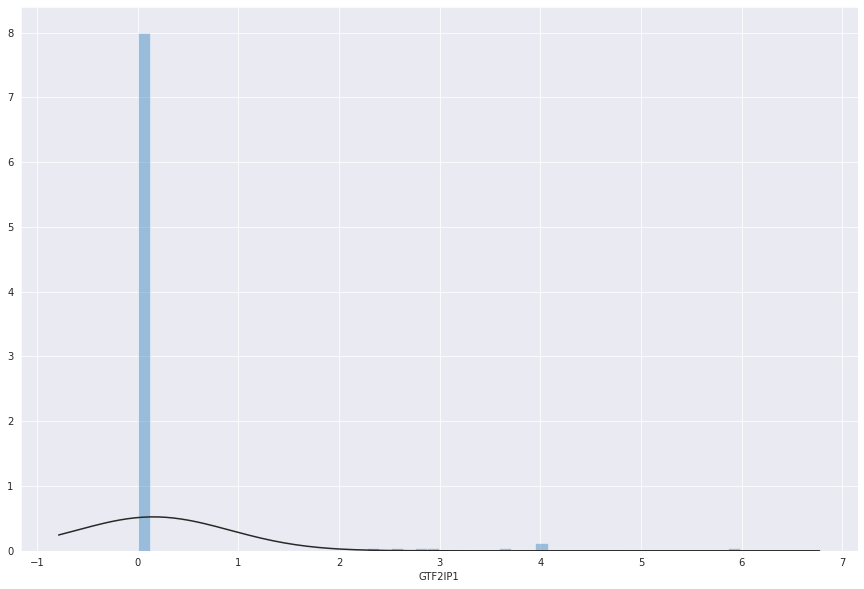

In [ ]:
rdn_gene = random.randrange(filtered_cells.shape[0])

plt.figure(figsize=(15, 10))
sns.set_style('darkgrid')
sns.distplot(unfilt_CPM.iloc[rdn_gene, :], fit=stats.norm, 
                                          kde=False, 
                                          bins = 50)

Again, I invite the reader to see above the long discussion about the limitations of using just a CPM normalization and not another more advanced normalization factor 

In [ ]:
#Log + 1 transfomration
Normal = np.log(unfilt_CPM.copy() + 1)
Normal

,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1B11_Normoxia_S127_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1B12_Normoxia_S27_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.119858,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CICP27,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
DDX11L17,0.000000,0.000000,0.000000,2.310261,0.000000,0.000000,0.000000,1.839774,1.276152,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
WASH9P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.496612,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.625521,0.000000,1.599483,0.000000,0.000000
OR4F29,0.000000,0.000000,0.000000,0.000000,1.334288,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,4.494373,0.000000,0.000000,3.340426,4.886376,2.608853,3.147706,4.511045,3.804617,3.464681,...,4.907816,4.122946,4.784858,4.068143,4.096969,4.673835,2.576354,2.821491,3.847318,4.727769
MT-CYB,9.500185,9.523174,8.219553,8.749820,8.996055,8.493594,8.313537,9.794540,9.817775,8.501586,...,8.742697,8.663470,8.763136,9.571416,9.514002,9.627635,9.388965,9.095296,9.328117,9.343454
MT-TT,4.856878,3.472215,3.889670,0.000000,4.750904,3.378024,3.147706,3.884775,4.183129,2.974496,...,5.597262,4.840488,3.208295,4.752699,4.316783,5.149846,2.576354,4.098620,4.245645,5.254748
MT-TP,4.991437,2.252478,4.689172,4.852645,5.543431,4.251478,3.538750,5.282793,5.430612,4.704238,...,6.502970,5.354548,4.477737,5.758794,5.406460,5.282652,5.392190,4.964361,4.529739,6.094856


We now look at the effect of this normalization on the distribution of a random gene. 

N.B: you can run this cell multiple times to see different genes choosen. As you can see it's not difficult to find genes with almost all zero reads (we will take care of this issue soon)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


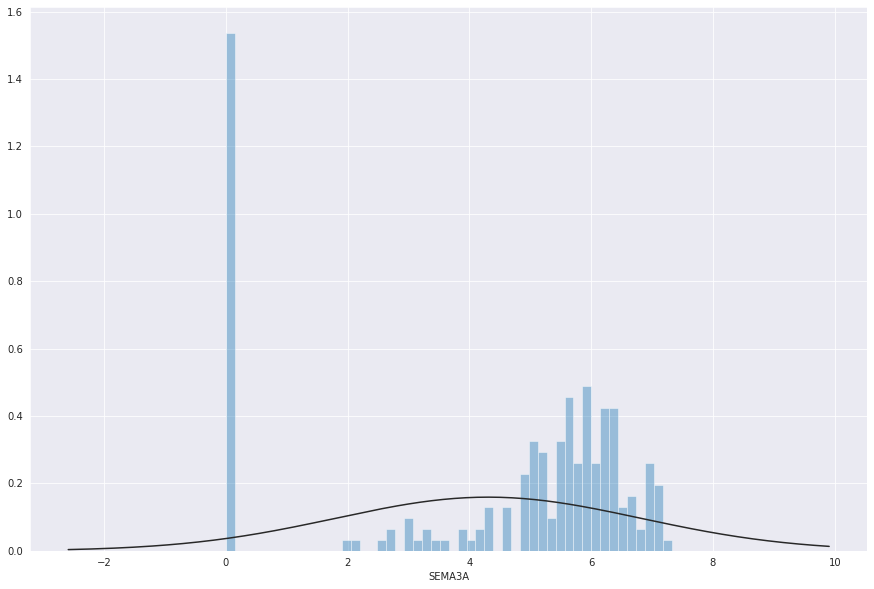

In [ ]:
rdn_gene = random.randrange(filtered_cells.shape[0])

plt.figure(figsize=(15, 10))
sns.set_style('darkgrid')
sns.distplot(Normal.iloc[rdn_gene, :], fit=stats.norm, 
                                          kde=False, 
                                          bins = 50)

In [ ]:
Normal

,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1B11_Normoxia_S127_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1B12_Normoxia_S27_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.119858,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CICP27,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
DDX11L17,0.000000,0.000000,0.000000,2.310261,0.000000,0.000000,0.000000,1.839774,1.276152,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
WASH9P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.496612,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.625521,0.000000,1.599483,0.000000,0.000000
OR4F29,0.000000,0.000000,0.000000,0.000000,1.334288,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,4.494373,0.000000,0.000000,3.340426,4.886376,2.608853,3.147706,4.511045,3.804617,3.464681,...,4.907816,4.122946,4.784858,4.068143,4.096969,4.673835,2.576354,2.821491,3.847318,4.727769
MT-CYB,9.500185,9.523174,8.219553,8.749820,8.996055,8.493594,8.313537,9.794540,9.817775,8.501586,...,8.742697,8.663470,8.763136,9.571416,9.514002,9.627635,9.388965,9.095296,9.328117,9.343454
MT-TT,4.856878,3.472215,3.889670,0.000000,4.750904,3.378024,3.147706,3.884775,4.183129,2.974496,...,5.597262,4.840488,3.208295,4.752699,4.316783,5.149846,2.576354,4.098620,4.245645,5.254748
MT-TP,4.991437,2.252478,4.689172,4.852645,5.543431,4.251478,3.538750,5.282793,5.430612,4.704238,...,6.502970,5.354548,4.477737,5.758794,5.406460,5.282652,5.392190,4.964361,4.529739,6.094856


---

##Data filtering


###Assuming normality of the transformed data

In this section we try to find the Higly Variable genes and keep them, discarding all the others.

First of all we divide our normalized and filtered with respect to cells dataframe `Normal` into two smaller dataframes: one containing the cells that grew up under Hypoxia `meta["Condition"] == "Hypo"` and one containing the cells that grew up under Normoxia `meta["Condition"] == "Norm"`

In [ ]:
t_norm = Normal.T.copy()

#We divide the dataset in two subdatasets containing the hypoxic and the normal cells
hypo = t_norm[meta["Condition"] == "Hypo"].T
norm = t_norm[meta["Condition"] == "Normo"].T

hypo.columns = hypo.columns.str.replace("output.STAR.", "")
hypo.columns = hypo.columns.str.replace("_Aligned.sortedByCoord.out.bam", "")

norm.columns = norm.columns.str.replace("output.STAR.", "")
norm.columns = norm.columns.str.replace("_Aligned.sortedByCoord.out.bam", "")


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning: The default value of regex will change from True to False in a future version.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: FutureWarning: The default value of regex will change from True to False in a future version.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: FutureWarning: The default value of regex will change from True to False in a future version.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning: The default value of regex will change from True 

Now we have a look to the result for the new dataframe `hypo` and we check if the dimensions of the two dataframes are similar 

In [ ]:
print(f"The dataframe hypo has dimension: {hypo.shape} \nThe dataframe norm has dimension: {norm.shape}")
hypo

The dataframe hypo has dimension: (23342, 110) 
The dataframe norm has dimension: (23342, 99)


,PCRPlate1A2_Hypoxia_S104,PCRPlate1A3_Hypoxia_S4,PCRPlate1A4_Hypoxia_S8,PCRPlate1A5_Hypoxia_S108,PCRPlate1A6_Hypoxia_S11,PCRPlate1B2_Hypoxia_S1,PCRPlate1B3_Hypoxia_S5,PCRPlate1B5_Hypoxia_S109,PCRPlate1B6_Hypoxia_S12,PCRPlate1C1_Hypoxia_S99,...,PCRPlate4E2_Hypoxia_S196,PCRPlate4E3_Hypoxia_S227,PCRPlate4F1_Hypoxia_S224,PCRPlate4F2_Hypoxia_S197,PCRPlate4F4_Hypoxia_S228,PCRPlate4F5_Hypoxia_S229,PCRPlate4G1_Hypoxia_S193,PCRPlate4G2_Hypoxia_S198,PCRPlate4G6_Hypoxia_S232,PCRPlate4H2_Hypoxia_S199
WASH7P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CICP27,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,2.862838,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
DDX11L17,0.000000,0.000000,2.310261,0.000000,0.000000,3.613948,3.044451,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
WASH9P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.889376,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.599483
OR4F29,0.000000,0.000000,0.000000,1.334288,0.000000,2.305389,2.397827,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,0.000000,0.000000,3.340426,4.886376,2.608853,2.947390,3.433915,3.050472,2.730650,4.443719,...,4.457283,4.205359,4.569119,4.083044,3.192022,4.039419,4.122946,4.784858,4.068143,2.821491
MT-CYB,9.523174,8.219553,8.749820,8.996055,8.493594,8.300906,8.973403,8.787494,9.528173,9.827093,...,9.775171,8.853441,8.316030,8.485091,8.545023,9.548771,8.663470,8.763136,9.571416,9.095296
MT-TT,3.472215,3.889670,0.000000,4.750904,3.378024,2.947390,0.000000,3.719667,3.390666,3.368339,...,4.057598,4.343173,4.910931,4.366503,4.607016,4.502798,4.840488,3.208295,4.752699,4.098620
MT-TP,2.252478,4.689172,4.852645,5.543431,4.251478,3.831688,3.433915,4.117018,4.619073,5.492078,...,5.297934,5.592779,5.641063,4.482874,5.203272,4.984036,5.354548,4.477737,5.758794,4.964361


We want to identify those genes for which we can see a statistically significant difference in the ditribution of the genes expression among all the cells. Those will be the genes that we want to keep for our furure studies. 

We start by applying a t-test to obtain some raw p-values that identify statistically significant genes. We remind that we naively assume normality of the data, leveraging on the central limit theorem given that the two sample sizes are respectively 110 and 99)

In [ ]:
#We create a dict to store the inial un adjusted p-values
p_val_row = {}
for i in range(Normal.shape[0]):  
  p_val_row[i] = stats.ttest_ind(hypo.iloc[i,:], norm.iloc[i,:], equal_var=False).pvalue

We plot the result on an histogram that is as would expect: A lot of genes seems statistically significant and then you have an "under layer" of uniform distribution coming from the non significant expressed genes.

Text(0.5, 1.0, 'p-value histogram')

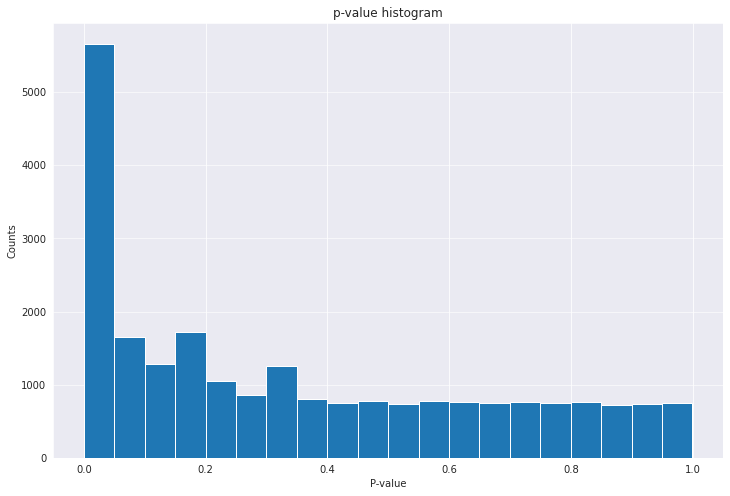

In [ ]:
plt.figure(figsize=(12,8))
plt.hist(p_val_row.values(),
         bins = 20)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('P-value')
plt.ylabel('Counts')
plt.title('p-value histogram')

Of course, when having to deal with so many tests we will incur in the so called "Multiple Testing Problem" and one way to deal with it is to change the p-values into q-values using the Benjamini-Hochberg correction. These values are also known as FDRs (False Discovery Rates) and we write down a function called `q-value` that computes them. 

Sometimes, however, the Benjamini-Hochberg correction is very good ad eliminating False positives, but sometimes it shriks too much the number of true positive, when adjusting the p-values. This eccesive shrinking behaviour can lead to a significant loss of important genes and we have to account for that. 

This is exactly what we do in the next part: 
- We try different CPM trashold (see the description of the function)
- We calculate the ajusted p-values on the genes that come out of this procedure 



In [ ]:
def filter_CPM(treshold):
  '''
  This function takes as input a CPM trashold and then it looks for each gene if there are
  at least two cells with the CPM that is over the given trashold. It then stores the indices
  of the genes that did NOT pass this barrier test.
  '''
  to_filter_list = []
  for i in range(Normal.shape[0]):
    mask = [element for element in Normal.iloc[i,:] if element >= treshold]
    if len(mask) <= 2:
      to_filter_list.append(i) 
  return to_filter_list

In [ ]:
def q_value (p_val_dict):
  sorted_list = [[key, value] for (key, value) in sorted(p_val_dict.items(), key=lambda x: x[1])]
  rank = 1
  for p in sorted_list:
    p[1] = p[1] * len(p_val_dict)/rank
    rank += 1
  q_val_dict = dict(sorted_list)
  q_val_dict = (sorted(q_val_dict.items()))
  return q_val_dict

In [ ]:
def graph_data_due(p_val_pre):
  y_axis = []
  for treshold in np.arange(0, 20, 1):
    aux_dictt = p_val_pre.copy()
    indices = filter_CPM(treshold)
    print("how many genes will be ignored in this iteration", len(indices))
    for ind in indices:
      del aux_dictt[ind]
    count = len([value for value in q_value(aux_dictt) if value[1] <= 0.05])
    print("Relevant number of genes for this treshold", count)
    y_axis.append(count)
    aux_dictt = p_val_pre.copy()
  return y_axis


In [ ]:
#Calculating this values will take some time, it has to go 20 iterations 
y = graph_data_due(p_val_row)

KeyboardInterrupt: ignored

In [ ]:
x = np.arange(0, 20, 1)
plt.figure(figsize=(12,8))
plt.scatter(x, y,
            s = 80,
            color = "r")
plt.grid()
plt.xlabel('CPM TRESHOLD')
plt.ylabel('N. OF SIGNIFICANT GENES')
plt.title('OPTIMAL TRESHOLD SELECTION')
plt.axvline(x=4, color = "blue")
plt.show()

NameError: ignored

<Figure size 864x576 with 0 Axes>

Given that we want to preserve as many significant genes as possible when adjusting the p-values, we choose a CMP cut of 3

In [ ]:
#We calculate the optimal set of genes
indices = filter_CPM(4)
final_dictt = p_val_row.copy()

for ind in indices:
  del final_dictt[ind]

#Notice that the sensitivity setted is very very small: 0.001%
final_indices = [value[0] for value in q_value(final_dictt) if (value[1] <= 0.05)]

We apply this to the dataset we had to finally obtain the final filtered version

In [ ]:
filt_lollo_1 = Normal.copy().iloc[final_indices]
filt_lollo_1

,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1B11_Normoxia_S127_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1B12_Normoxia_S27_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
MTND1P23,6.772817,5.191494,5.781636,6.601558,6.750134,5.556678,6.241249,6.404638,6.165922,5.936978,...,7.046227,6.128137,5.921251,5.963004,6.251190,6.391642,6.110395,5.795721,6.291457,7.241321
MTND2P28,5.331955,3.837159,3.608782,2.310261,5.282240,3.264497,4.037888,5.255535,5.230914,3.249328,...,5.024778,4.960946,4.163534,4.068143,4.096969,5.261706,4.302640,4.783435,4.397747,5.365424
MTATP6P1,8.125904,7.524896,6.994488,7.287838,8.153417,7.229034,7.552846,8.235127,8.448522,7.194849,...,7.767775,7.605640,7.602307,7.806662,8.055522,7.871329,7.662512,7.832570,7.527590,7.869863
MTCO3P12,5.928611,5.310412,4.888170,5.155970,5.487146,4.738400,5.359810,5.903624,6.001219,4.400754,...,5.338081,4.988922,5.019487,5.558824,5.406460,5.672484,5.392190,5.290908,4.845248,5.441068
AGRN,5.923116,7.426881,3.216768,4.415141,4.843226,5.671327,0.000000,5.384952,5.567831,4.906660,...,5.868313,4.302565,3.702819,5.441522,5.003236,5.897744,5.392190,4.221829,6.466364,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-ATP6,9.169457,8.654302,7.881252,8.358717,9.272553,8.051159,8.422145,9.272768,9.459936,8.075675,...,8.740012,8.641541,8.534759,8.817472,8.760177,8.924556,8.648034,8.811779,8.535477,8.845355
MT-CO3,9.577100,8.989522,8.428350,8.797575,9.480422,8.574612,8.950374,9.673881,9.855331,8.374295,...,8.688539,8.883635,8.890753,9.283423,9.399634,9.414806,8.971273,9.265261,9.047574,9.267049
MT-TE,4.494373,0.000000,0.000000,3.340426,4.886376,2.608853,3.147706,4.511045,3.804617,3.464681,...,4.907816,4.122946,4.784858,4.068143,4.096969,4.673835,2.576354,2.821491,3.847318,4.727769
MT-CYB,9.500185,9.523174,8.219553,8.749820,8.996055,8.493594,8.313537,9.794540,9.817775,8.501586,...,8.742697,8.663470,8.763136,9.571416,9.514002,9.627635,9.388965,9.095296,9.328117,9.343454


Last, we try to implement a function that returns the name of the n most significant genes, based on the adjusted p_values calculated before

In [ ]:
def top_genes (n):
  sorted_list = [[key, value] for (key, value) in sorted(p_val_row.items(), key=lambda x: x[1])]
  rank = 1
  for p in sorted_list:
    p[1] = p[1] * len(p_val_row)/rank
    rank += 1

  indices = []
  for couple in sorted_list[:n]:
    indices.append(couple[0])
  
  for index in indices:
    print(Normal.index.values[index])
  

In [ ]:
top_genes(20)

EGLN3
SLC2A1
C4orf3
DANT1
LOXL2
PGK1
PLIN2
SLC6A8
BNIP3L
PNCK
EGLN1
BRIX1
LDHAP4
ARRDC3
SAP30-DT
NOP16
PAM
CCT6A
SEC61G
PNO1


Luckly enough at position #11 (EGLN1), #1 (EGLN3),#5 (LOXL2), #17(PAM), #2 (SLC2A1) we find two genes that we know are directly involved in the cell reaction to hypoxia (According to [DAVID Database](https://david.ncifcrf.gov/)). This little naive and baiased filtering gave us some nice results at the end and that's why we wanted to include it in the discussion

- **EGLN1**: The protein encoded by this gene catalyzes the post-translational formation of 4-hydroxyproline in hypoxia-inducible factor (HIF) alpha proteins. HIF is a transcriptional complex that plays a central role in mammalian oxygen homeostasis. This protein functions as a cellular oxygen sensor, and under normal oxygen concentration, modification by prolyl hydroxylation is a key regulatory event that targets HIF subunits for proteasomal destruction via the von Hippel-Lindau ubiquitylation complex.

- **EGLN3**: Enables peptidyl-proline 4-dioxygenase activity. Involved in several processes, including activation of cysteine-type endopeptidase activity involved in apoptotic process; peptidyl-proline hydroxylation to 4-hydroxy-L-proline; and response to hypoxia. Located in cytosol and nucleus. Implicated in renal cell carcinoma.

- **LOXL2**: This gene encodes a member of the lysyl oxidase gene family. The prototypic member of the family is essential to the biogenesis of connective tissue, encoding an extracellular copper-dependent amine oxidase that catalyses the first step in the formation of crosslinks in collagens and elastin. A highly conserved amino acid sequence at the C-terminus end appears to be sufficient for amine oxidase activity, suggesting that each family member may retain this function. The N-terminus is poorly conserved and may impart additional roles in developmental regulation, senescence, tumor suppression, cell growth control, and chemotaxis to each member of the family.

- **PAM**: 	This gene encodes a multifunctional protein. The encoded preproprotein is proteolytically processed to generate the mature enzyme. This enzyme includes two domains with distinct catalytic activities, a peptidylglycine alpha-hydroxylating monooxygenase (PHM) domain and a peptidyl-alpha-hydroxyglycine alpha-amidating lyase (PAL) domain.

- **SLC2A1**: This gene encodes a major glucose transporter in the mammalian blood-brain barrier. The encoded protein is found primarily in the cell membrane and on the cell surface, where it can also function as a receptor for human T-cell leukemia virus (HTLV) I and II.

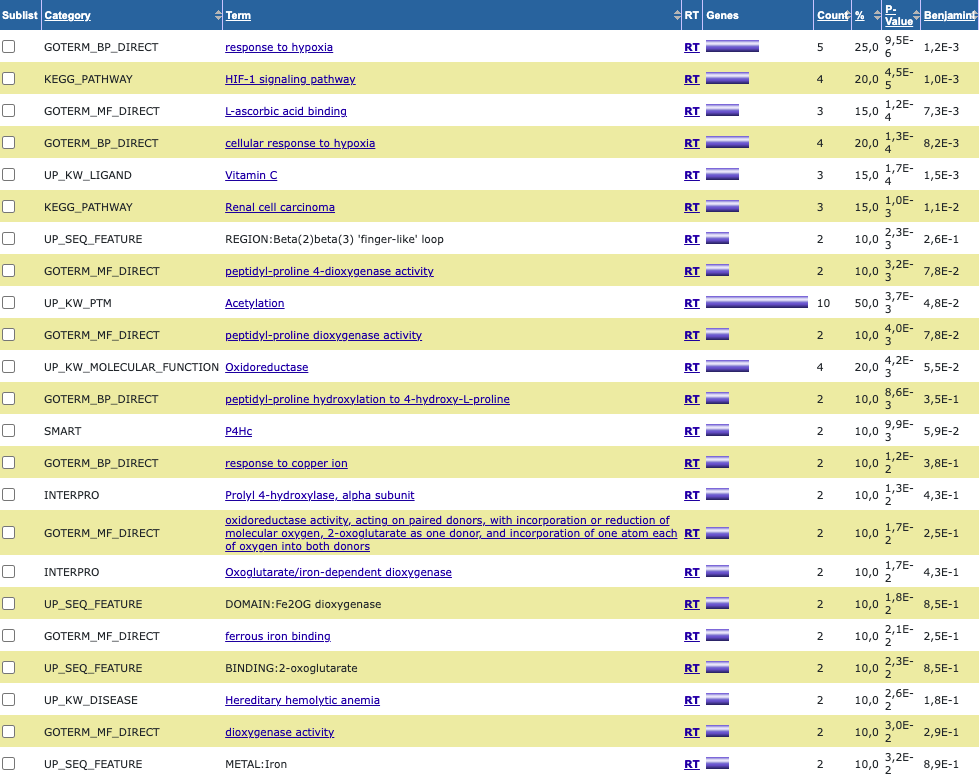

In [ ]:
proffilt = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_Filtered_Normalised_3000_Data_train.txt', delimiter = " ", index_col = 0)

In [ ]:
counter = 0
for gene in proffilt.index.values:
  if gene in filt_lollo_1.index.values:
    counter +=1

print(f"Sovrapposition between our dataframe and the provided dataframe: {counter/3000 *100}%")

Sovrapposition between our dataframe and the provided dataframe: 20.233333333333334%


Loading the meta data and the filtered and normalised dataset of HCC1806 SmartSeq.

In [ ]:
meta = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_MetaData.tsv', delimiter = "\t", index_col = 0)
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt', delimiter = " ", index_col = 0)
print("data frame dimensions :", np.shape(df))
meta.head()

data frame dimensions : (3000, 182)


,Cell Line,PCR Plate,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,HCC1806,1,A10,Normo,24,S123,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,HCC1806,1,A12,Normo,24,S26,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,HCC1806,1,A1,Hypo,24,S97,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,HCC1806,1,A2,Hypo,24,S104,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,HCC1806,1,A3,Hypo,24,S4,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


In [ ]:
# t_meta = meta.T
# print(t_meta.shape)
# hypo_ind = (meta["Condition"] == "Hypo")
# hypo_ind = hypo_ind.to_numpy()
# norm_ind = (~(hypo_ind))
# norm_ind.sum()
# hypo_ind

### Dimensionality Reduction

> Throughout this section, we will be applying a Principal Components Analysis for the purpose of analyzing data and dimensionality reduction, as well as other dimensionality reduction techniques and discuss their outcomes.

We start by converting our Pandas DataFrame into a NumPy array.

In [ ]:
data = df.to_numpy()

Then, we extract the indices of hypoxic and normoxic cells and build two lists out of them

In [ ]:
l_hypoxia = get_condition_list(df, "Hypo")
l_normoxia = get_condition_list(df, "Norm")
print(len(l_normoxia))
l_hypoxia[:10], l_normoxia[:10]

NameError: ignored

#### PCA

As we import the PCA function from the SKLearn library, we proceed to apply it to our dataset, requesting a 95% variance expression on the reduced outcome.

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pca = PCA(n_components = 0.95)
data_red = pca.fit_transform(data.T)
pca.n_components_

34

We can notice that here we need 34 principal components, in order to express 95% of the variance.

In [ ]:
data_red.shape

(182, 34)

In [ ]:
pca.explained_variance_ratio_[:3]

array([0.29018923, 0.18101256, 0.12288734])

We now plot the results, starting from a 2D scatter plot on the two main principal components.

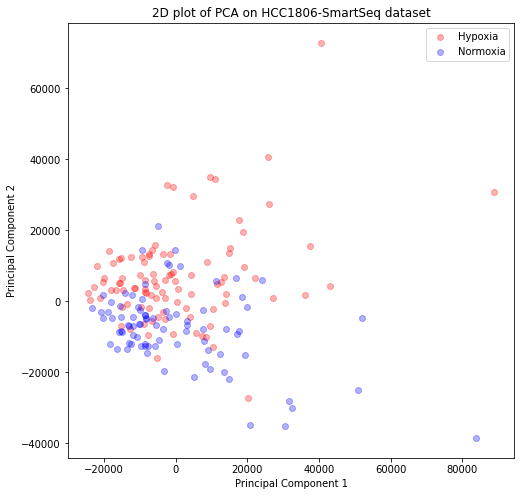

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_title('2D plot of PCA on HCC1806-SmartSeq dataset')

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3, label="Normoxia")
ax.legend()
plt.show()

Next, we can again build a scatter plot, 3D this time, as we take into account the third principal component as well.

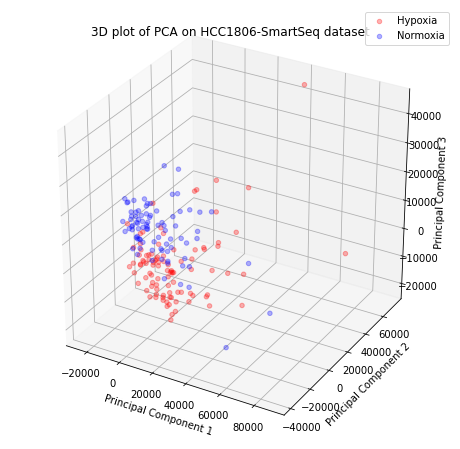

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D plot of PCA on HCC1806-SmartSeq dataset')

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], data_red[l_hypoxia,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], data_red[l_normoxia,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

##### Interactive 3D version
> Might take a few minutes to run

Notice. The following implementation is quite time-consuming when executed on large-sized datasets (since a simpler static version of the 3D plot has been implemented above, we provide the code cell below commented).

In [ ]:
plot_df = pd.DataFrame(data_red[:, 0:3])
plot_df.columns = ["PC1","PC2","PC3"]

aux_lst = []
for name in df.columns.values:
  if 'Hypo' in name:
    aux_lst.append(1)
  elif 'Norm' in name:
    aux_lst.append(0)

plot_df["Color"] = aux_lst
plot_df

,x,y,z,Color
0,-26874.672396,766.013957,-880.248212,0
1,-26354.743000,5039.849020,-5372.826809,0
2,-29351.253485,2414.726753,-3076.254097,0
3,-24813.833293,-75.979072,-3934.877133,0
4,4454.732179,-1836.273354,-1595.912696,1
...,...,...,...,...
245,-18394.340467,-5274.416642,649.525614,0
246,-10023.164045,-14507.616731,-1941.969647,0
247,603.697715,11492.308191,43230.690452,1
248,17016.931253,8398.335833,4439.884803,1


In [ ]:
# !pip install jupyter-dash

import plotly.graph_objects as go
import plotly.express as px
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

fig = px.scatter_3d(
    data_frame = plot_df,
    x = "PC1",
    y = "PC2",
    z = "PC3",
    color = "Color",
    title = "Interactive PCA plot with supervised labels",
)

# build jupyter dash app 
app = JupyterDash(__name__)
# add html components and figure to app
app.layout = html.Div([dcc.Graph(figure=fig)])
# run app inline
app.run_server(mode='inline')

<IPython.core.display.Javascript object>

#### t-SNE


We first import TSNE from the SKLearn library

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

Now, PCA is carried out on the dataframe, and all the data is mapped into a 50-dimensional space.
PCA is performed as a sort of pre-processing stage because t-SNE does not work properly on datasets having too many features (in this case the initial dataset have 3000 features), so we need to reduce the dimensionality to about 50 (a number of features with which t-SNE produces good results).

In [ ]:
pca50 = PCA(n_components=50)
data_fifty = pca50.fit_transform(data.T)
data_fifty.shape

(182, 50)

In [ ]:
pca50.explained_variance_ratio_[0:4]

array([0.29018923, 0.18101256, 0.12288734, 0.07970126])

We now apply t-SNE on the output of PCA (i.e. the data_fifty reduced dataset).

In [ ]:
embedded = TSNE(n_components=2, learning_rate='auto', init='random').fit_transform(data_fifty)

In [ ]:
embedded.shape

(182, 2)

We now plot the results.

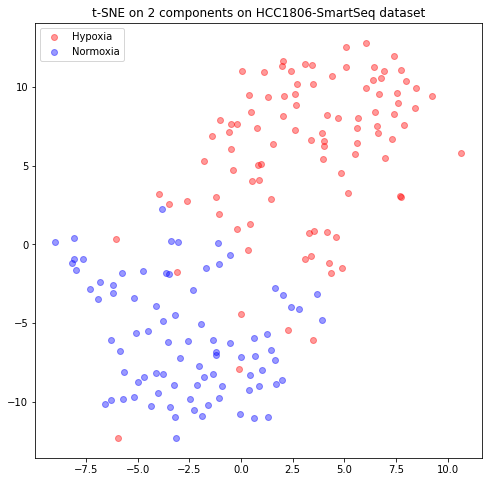

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.scatter(embedded[l_hypoxia,0], embedded[l_hypoxia,1], c="r",alpha = 0.4, label="Hypoxia")
ax.scatter(embedded[l_normoxia,0], embedded[l_normoxia,1], c="b",alpha = 0.4, label="Normoxia")
ax.set_title('t-SNE on 2 components on HCC1806-SmartSeq dataset')
ax.legend()

plt.show()

Again, we want to visualize how the t-SNE plot changes as we set ‘pca’ as init parameter. We would again expect to get a scatterplot which is very close to the one described by the PCA function.

In [ ]:
# Here the init parameter is set to 'pca'
embedded2 = TSNE(n_components=2, learning_rate='auto', init='pca').fit_transform(data_fifty)

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.set_title('2 component t-SNE on HCC1806-SmartSeq dataset (pca as init)', fontsize = 15)

ax.scatter(embedded2[l_hypoxia,0], embedded2[l_hypoxia,1], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(embedded2[l_normoxia,0], embedded2[l_normoxia,1], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

KeyboardInterrupt: ignored

We can observe once more that the plot above displays a practically perfect match of the PCA plot.

#### UMAP

Let's first install the umap library

In [ ]:
# !pip install umap-learn

     |████████████████████████████████| 88 kB 3.0 MB/s 
     |████████████████████████████████| 1.1 MB 40.7 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=ce75bd95b80eaa7196e8381fc04923b2f808201bc2b92e7c2a20cc713b4ff08c
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.7-py3-none-any.whl size=54286 sha256=f7e687ffcf649d46a44e5827938b3ddca0a60de035d4c051298bef1995aec004
  Stored in directory: /root/.cache/pip/wheels/7f/2a/f8/7bd5dcec71bd5c669f6f574db3113513696b98f3f9b51f496c
Successfully built umap-learn pynndescent


In [ ]:
from umap import UMAP

In [ ]:
reducer = UMAP()

embedding_data = reducer.fit_transform(data.T)
embedding_data.shape

(182, 2)

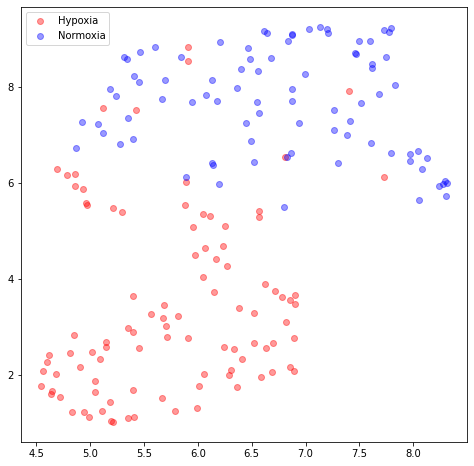

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.scatter(embedding_data[l_hypoxia, 1], embedding_data[l_hypoxia,0], c="r",alpha = 0.4, label="Hypoxia")
ax.scatter(embedding_data[l_normoxia, 1], embedding_data[l_normoxia,0], c="b",alpha = 0.4, label="Normoxia")
ax.legend()
plt.show()

### Clustering methods

Again, since we are dealing with a rather small-sized dataframe, clustering techniques will be implemented on the entire dataset.

#### K-means

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans = KMeans(n_clusters=2, random_state=42)
pred_clus = kmeans.fit_predict(data.T)

In [ ]:
hypo = (pred_clus == 1)
norm = (pred_clus == 0)

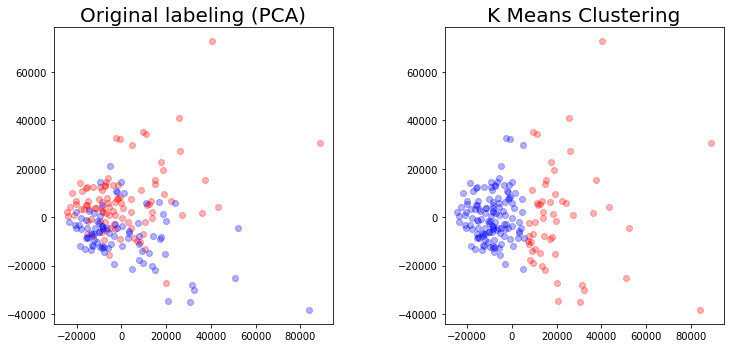

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(data_red[hypo,0],data_red[hypo,1], c="r",alpha = 0.3)
ax1.scatter(data_red[norm,0],data_red[norm,1], c="b",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

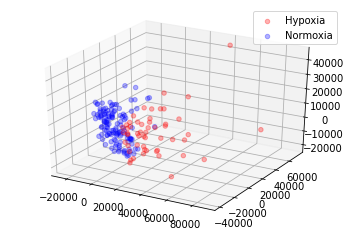

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo,0],data_red[hypo,1], data_red[hypo,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm,0],data_red[norm,1], data_red[norm,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

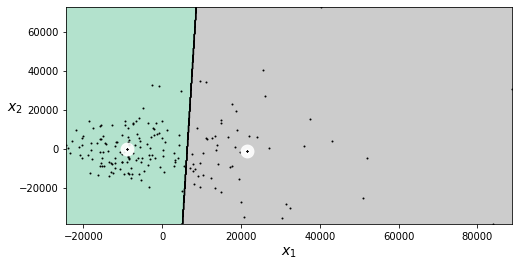

In [ ]:
kmeans.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 4))
plot_decision_boundaries(kmeans, data_red[:, 0:2])
plt.show()

#### Gaussian mixture

In [ ]:
from sklearn.mixture import GaussianMixture

gm = GaussianMixture(n_components=2, random_state=42,
                     covariance_type = "diag")

In [ ]:
pred_mix = gm.fit_predict(data.T)

In [ ]:
hypo_mix = (pred_mix == 1)
norm_mix = (pred_mix == 0)

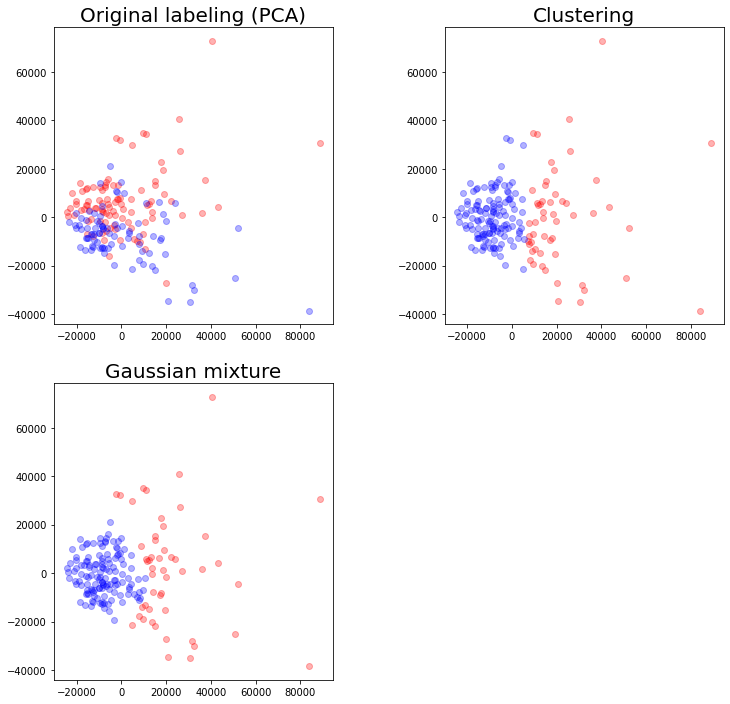

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax2 = fig.add_subplot(2,2,3)
ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(data_red[hypo,0],data_red[hypo,1], c="r",alpha = 0.3)
ax1.scatter(data_red[norm,0],data_red[norm,1], c="b",alpha = 0.3)

ax2.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(data_red[norm_mix,0],data_red[norm_mix,1], c="b",alpha = 0.3)


plt.subplots_adjust(wspace=0.4)

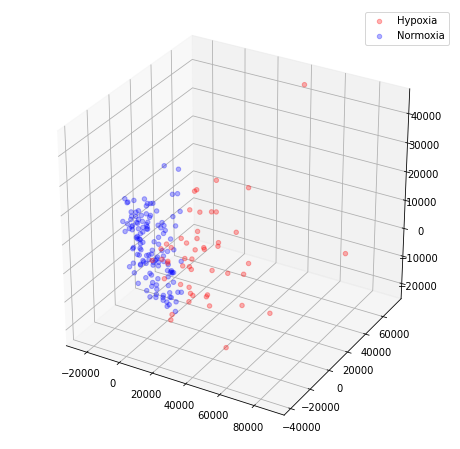

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], data_red[hypo_mix,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm_mix,0],data_red[norm_mix,1], data_red[norm_mix,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

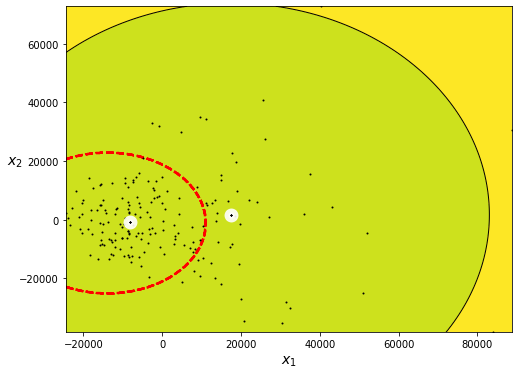

In [ ]:
gm.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 6))
plot_gaussian_mixture(gm, data_red[:, 0:2])
plt.show()

#### Bayesian Gaussian Mixture


Here we try to implement a different yet similar method to Gaussian Mixture. 

The Bayesian Gaussian Mixture is a method which allows you to not know the exact number of clusters in your data, in a sense it is better because by using a prior it understands how many clusters there should be.

In [ ]:
from sklearn.mixture import BayesianGaussianMixture

In [ ]:
bgm = BayesianGaussianMixture(n_components = 2, random_state = 42)
pred_bgm = bgm.fit_predict(data.T)

In [ ]:
hypo_bgm = (pred_bgm == 1)
norm_bgm = (pred_bgm == 0)

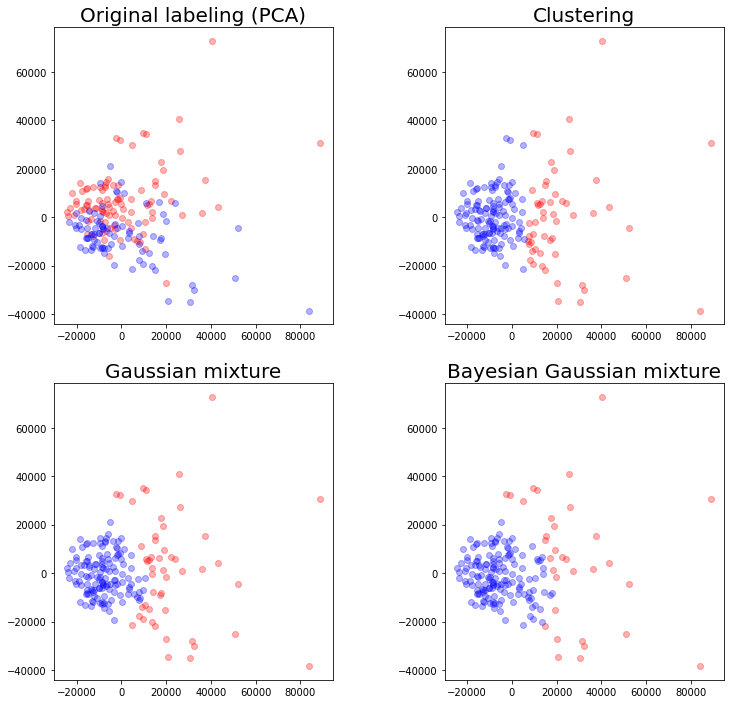

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,4)

ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax3.set_title('Bayesian Gaussian mixture', fontsize = 20)

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(data_red[hypo,0],data_red[hypo,1], c="r",alpha = 0.3)
ax1.scatter(data_red[norm,0],data_red[norm,1], c="b",alpha = 0.3)

ax2.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(data_red[norm_mix,0],data_red[norm_mix,1], c="b",alpha = 0.3)

ax3.scatter(data_red[hypo_bgm,0],data_red[hypo_bgm,1], c="r",alpha = 0.3)
ax3.scatter(data_red[norm_bgm,0],data_red[norm_bgm,1], c="b",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

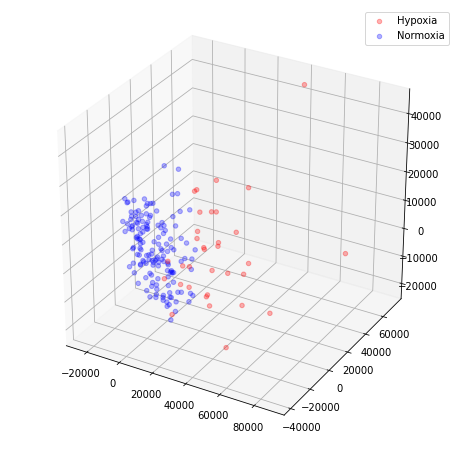

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo_bgm,0],data_red[hypo_bgm,1], data_red[hypo_bgm,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm_bgm,0],data_red[norm_bgm,1], data_red[norm_bgm,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

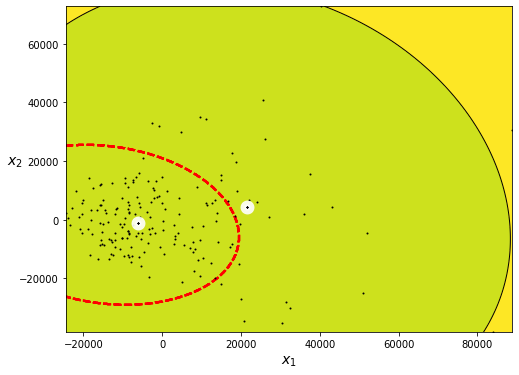

In [ ]:
bgm.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 6))
plot_gaussian_mixture(bgm, data_red[:, 0:2])
plt.show()

#### Agglomerative Clustering

We are also interested on the behavior and performance of hierarchical clustering methods. 
In agglomerative algorithms, each item starts in its own cluster, then, objects are recursively clustered by similarity, i.e. the distances between groups, two items at a time. Eventually, all items will be grouped in one cluster.
We choose to implement Agglomerative Clustering, as it is the most commonly used technique of this kind.

In [ ]:
from sklearn.cluster import AgglomerativeClustering

In [ ]:
aggl = AgglomerativeClustering(n_clusters=2)

In [ ]:
pred_aggl = aggl.fit_predict(data_red)

In [ ]:
hypo_aggl = (pred_aggl == 1)
norm_aggl = (pred_aggl == 0)

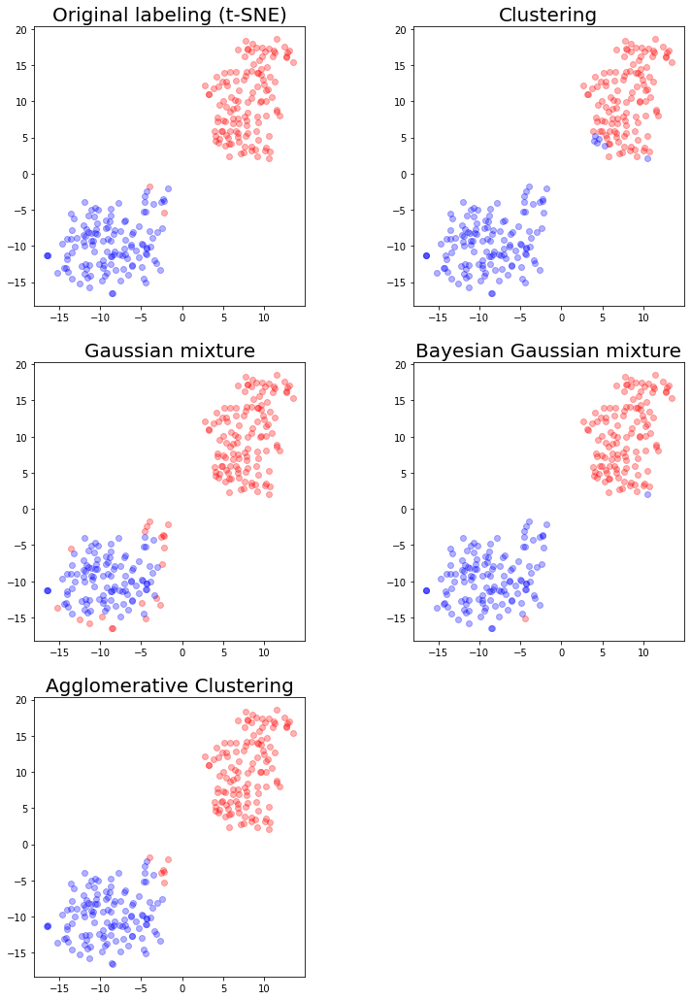

In [ ]:
fig = plt.figure(figsize = (12,18))
ax = fig.add_subplot(3,2,1)
ax1 = fig.add_subplot(3,2,2)
ax2 = fig.add_subplot(3,2,3)
ax3 = fig.add_subplot(3,2,4)
ax4 = fig.add_subplot(3,2,5)

ax.set_title('Original labeling (t-SNE)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax3.set_title('Bayesian Gaussian mixture', fontsize = 20)

ax4.set_title('Agglomerative Clustering', fontsize = 20)

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(data_red[hypo,0],data_red[hypo,1], c="r",alpha = 0.3)
ax1.scatter(data_red[norm,0],data_red[norm,1], c="b",alpha = 0.3)

ax2.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(data_red[norm_mix,0],data_red[norm_mix,1], c="b",alpha = 0.3)

ax3.scatter(data_red[hypo_bgm,0],data_red[hypo_bgm,1], c="r",alpha = 0.3)
ax3.scatter(data_red[norm_bgm,0],data_red[norm_bgm,1], c="b",alpha = 0.3)

ax4.scatter(data_red[hypo_aggl,0],data_red[hypo_aggl,1], c="b",alpha = 0.3)
ax4.scatter(data_red[norm_aggl,0],data_red[norm_aggl,1], c="r",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

This clustering method can be easily visualized in 2D plots known as dendograms, in which the clusters at each step of the algorithm can be clearly displayed. With the following cell, we will try to implement dendograms for each linkage method available for AgglomerativeClustering.

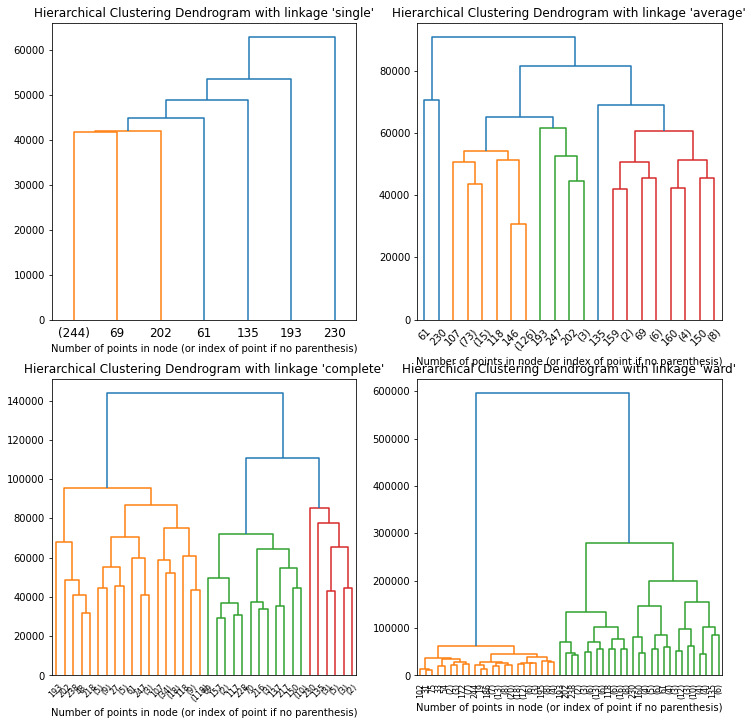

In [ ]:
# setting distance_threshold=0 ensures we compute the full tree.
l_linkage = ['single', 'average', 'complete', 'ward']

fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12,12))

for n, linkage in enumerate(l_linkage):
    model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, linkage=linkage)
    model = model.fit(data.T)

    ax = plt.subplot(2, 2, n + 1)
    # plot the top five levels of the dendrogram
    plot_dendrogram(model, truncate_mode="level", p=5)
    ax.set_title("Hierarchical Clustering Dendrogram with linkage " + "'" + linkage + "'")
    ax.set_xlabel("Number of points in node (or index of point if no parenthesis)")

plt.show()

#### Evaluating Clustering methods 

We will now look at how the various clusterings perform in understanding whether a cell is an Hypoxia one or not.

We will do it over the normal data, i.e. 'df' transposed, that is data.T

In [ ]:
y = []
for i in range(len(l_hypoxia) + len(l_normoxia)):
  if i in l_hypoxia:
    y.append(1)
  elif i in l_normoxia:
    y.append(0)

##### K Means Clustering

In [ ]:
y_pred_clus = kmeans.fit_predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_clus==y))
print("fraction of correct predictions", np.sum(y_pred_clus==y) / len(y_pred_clus))

correct predictions:  9826
fraction of correct predictions 0.45436049200036993


##### Gaussian Mixture

In [ ]:
gm.fit(data.T)
y_pred_mix = gm.predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_mix==y))
print("fraction of correct predictions", np.sum(y_pred_mix==y) / len(y_pred_mix))

correct predictions:  241
fraction of correct predictions 0.964


##### Bayesian Gaussian Mixture

In [ ]:
bgm.fit(data.T)
y_pred_bgm = bgm.predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_bgm==y))
print("fraction of correct predictions", np.sum(y_pred_bgm==y) / len(y_pred_bgm))

correct predictions:  244
fraction of correct predictions 0.976


By observing these results, we can conclude that all clustering methods implemented above, be them Kmeans, GM, or BGM, perform with a significant degree of accuracy on this dataset.

###Classifiers

#### Opening Files

In [ ]:
meta = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_MetaData.tsv', delimiter = "\t", index_col = 0)
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt', delimiter = " ", index_col = 0)
print("data frame dimensions :", np.shape(df))
meta.head()

data frame dimensions : (3000, 182)


,Cell Line,PCR Plate,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
Filename,,,,,,,,
output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,HCC1806,1,A10,Normo,24,S123,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,HCC1806,1,A12,Normo,24,S26,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,HCC1806,1,A1,Hypo,24,S97,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,HCC1806,1,A2,Hypo,24,S104,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,HCC1806,1,A3,Hypo,24,S4,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


The models for classification of Hypoxic and Normoxic are the same ones implemented in the SmartSeq MCF7 section and are carried out following the same pipeline. For the main description, see Section SmartSeq - Classifiers.

In [ ]:
from sklearn.model_selection import train_test_split

HCC_smart_T = df.T
X = HCC_smart_T.to_numpy()

condition = []
for i in list(HCC_smart_T.index):
  if "Norm" in i:
    condition.append(0)
  if "Hypo" in i:
    condition.append(1)
HCC_smart_T["Condition"] = condition

y = np.array(condition)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 42)

In [ ]:
(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

((136, 3000), (46, 3000), (136,), (46,))

####Random Forest

In [ ]:
from sklearn.model_selection import GridSearchCV
from  sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(criterion = "gini", random_state=42)

p_grid = {'n_estimators': [15, 30, 80, 150, 250],
          'criterion': ["gini", "entropy"],
          'min_samples_leaf': [1, 2]}
                    
gs = GridSearchCV(rfc, param_grid = p_grid).fit(X_train, y_train)
gs.best_params_

{'criterion': 'gini', 'min_samples_leaf': 1, 'n_estimators': 15}

In [ ]:
from sklearn.metrics import accuracy_score

rfc = RandomForestClassifier(n_estimators = gs.best_params_["n_estimators"], 
                             min_samples_leaf = gs.best_params_["min_samples_leaf"], 
                             criterion = gs.best_params_["criterion"], 
                             random_state = 42)

rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
accuracy_score(y_pred, y_test)

0.9782608695652174

##### Feature Importance

In [ ]:
imp = rfc.feature_importances_
q = np.quantile(imp, 0.98)
gene = []
for name, score in zip(list(HCC_smart_T.iloc[:,:-1].columns), rfc.feature_importances_):
  if score >= q:
    #print(name, score)
    gene.append((name,score))
gene.sort(key = lambda x : x[1],reverse=True)
gene
genes = [i[0] for i in gene]
for i in genes:
    print(i,end=" ")
genesH = genes

LOXL2 SLC2A1 ERO1A BNIP3 TPBG NDRG1 FAM162A BNIP3L KCTD11 INSIG1 LDHA BLCAP AHNAK2 KRT19 P4HA1 MT1X GRHL3 KYNU JUNB HSPH1 SRM PLK1 RIPK4 H1-0 PRDM1 EGLN1 PLOD2 H2BC8 GJB4 HDAC5 ARRDC3 CRIP2 ACTG1P25 BHLHE40 TUBA1B KCNMA1 PGK1 UGDH MXD1 LIPA TSPAN33 VSIR STRA6 TXNIP ARL6IP1 KCNS3 SLC43A2 GLUL LDHB PTGS2 F10 TP53INP1 SLC2A3 ASB2 RPH3AL KCTD8 EIF5 FNDC4 GEM TSPEAR-AS1 

We now want to find a list of the genes that most significantly differ between Normoxic and Hypoxic cells, according to the Random Forest model.

<BarContainer object of 27 artists>

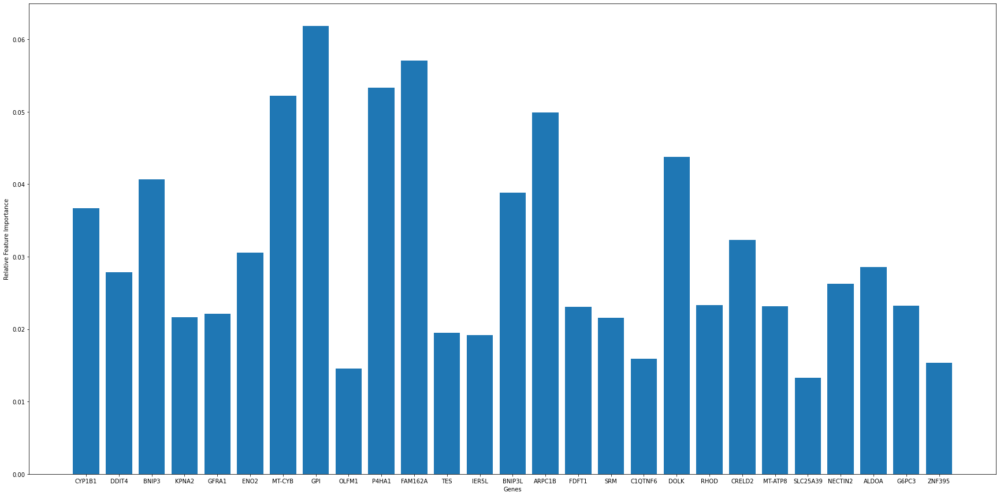

In [ ]:
plt.figure(figsize = (30,15))

g = []
s = []
for name, score in zip(list(HCC_smart_T.iloc[:,:-1].columns), rfc.feature_importances_):
  if score >= 0.013:
    g.append(name)
    s.append(score)


plt.xlabel('Genes')
plt.ylabel("Relative Feature Importance")

plt.bar(g, s)

##### Analysing relationship between Principal Components and accuracy

In [ ]:
df_train = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt", sep = " ")

In [ ]:
df_meta = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_MetaData.tsv", delimiter = "\t", header=0)
 
df_meta["Condition"] = df_meta.Condition.eq('Hypo').mul(1)

col_l= []
for j in list(df_train.columns): 
    for i , h in zip(df_meta["Filename"], df_meta["Condition"]):
        if j == i:
            col_l.append(h)

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from  sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score

acc_list = []
dim_list = [i for i in range(1, 20)]
for i in range(1, 20):

  #PCA
  X = df_train.to_numpy()
  X_t = np.transpose(X)
  pca = PCA(n_components = i)
  Xred = pca.fit_transform(X_t)
  df_red = pd.DataFrame(Xred)

  #Creating the classification framework 
  df_red["Classification"] = col_l

  X = df_red.iloc[:,:-1]
  y = df_red["Classification"]

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state = 42)

  #Fitting the random forest
  rfc = RandomForestClassifier(n_estimators = 100, 
                               min_samples_leaf = 1, 
                               min_samples_split = 2,
                               criterion="gini", random_state = 42)

  rfc.fit(X_train, y_train)
  y_pred = rfc.predict(X_test)
  acc_list.append(accuracy_score(y_pred, y_test))


<BarContainer object of 19 artists>

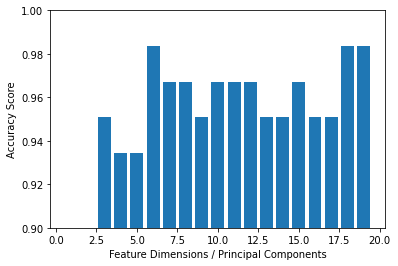

In [ ]:
#plotting the accuracy scores
(figsize = (30,15))

plt.xlabel("Feature Dimensions / Principal Components")
plt.ylabel("Accuracy Score")
plt.ylim([0.90, 1])

plt.bar(dim_list, acc_list)

####Gradient Boosting

In [ ]:
(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

((136, 3000), (46, 3000), (136,), (46,))

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

gb_clf = GradientBoostingClassifier(random_state = 42)

p_grid = {'max_features' : [6, 10, 25, 40], 
          'max_leaf_nodes' : [4, 8, 16, 32],
          'n_estimators' : [20, 30, 40, 60, 100, 150]}

gs = GridSearchCV(gb_clf, param_grid = p_grid).fit(X_train, y_train)
gs.best_params_

{'max_features': 6, 'max_leaf_nodes': 8, 'n_estimators': 150}

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

gb_clf = GradientBoostingClassifier(learning_rate = 0.1,
                                    max_features = gs.best_params_['max_features'],
                                    max_leaf_nodes = gs.best_params_['max_leaf_nodes'],
                                    n_estimators = gs.best_params_['n_estimators'])

gb_clf.fit(X_train, y_train)
y_pred = gb_clf.predict(X_test)
accuracy_score(y_pred, y_test)

0.9782608695652174

####SVM

In [ ]:
(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

((187, 3000), (63, 3000), (187,), (63,))

In [ ]:
from sklearn.svm import SVC

svc = SVC()
parameters = {'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
              'C': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.8, 1, 1.5, 2, 4, 6, 10],
              'gamma': ['scale', 'auto'],
              'degree': [1, 2, 3, 4]}

clf = GridSearchCV(svc, parameters).fit(X_train, y_train)
clf.best_params_

{'C': 0.1, 'degree': 1, 'gamma': 'scale', 'kernel': 'rbf'}

In [ ]:
svc = SVC(C=clf.best_params_["C"],
          kernel=clf.best_params_["kernel"],
          gamma=clf.best_params_["gamma"],
          degree=clf.best_params_["degree"])

svc.fit(X_train, y_train)
y_pred = svc.predict(X_test)
accuracy_score(y_pred, y_test)

0.9841269841269841

#### Neural Network

Let's now try to train and predict hypoxia and normoxia on the other data set

In [ ]:
df_meta = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_MetaData.tsv", delimiter = "\t", header=0)

df_meta["Condition"] = df_meta.Condition.eq('Hypo').mul(1)
col_= []
for j in list(df_train.columns): 
    for i , h in zip(df_meta["Filename"], df_meta["Condition"]):
        if j == i:
            col_.append(h)



In [ ]:
df_train = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt", sep = " ")
df_train_t = df_train.T
df_train_t["Classification"] = col_

In [ ]:
from sklearn.model_selection import train_test_split

X = df_train_t.iloc[:,:-1]
y = df_train_t["Classification"]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.33)

In [ ]:
x_valid, x_train = X_train[:18], X_train[18:]
y_valid, y_train = y_train[:18], y_train[18:]

doing the same thing as before

In [ ]:
model = Sequential()
model.add(Dense(units=300, activation= "relu", input_shape= (3000,)))
model.add(Dense(units= 100, activation= "relu"))
model.add(Dense(units= 1,activation = 'sigmoid'))


In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer=keras.optimizers.Adam(learning_rate=0.0001, decay = 0.001),
              metrics=['accuracy'])

In [ ]:
hist=model.fit(x = x_train, y = y_train, epochs=20, validation_data = (x_valid,y_valid))

Epoch 1/20


/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


3/4 [=====================>........] - ETA: 0s - loss: 445.4955 - accuracy: 0.4896

/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


4/4 [==============================] - 3s 396ms/step - loss: 419.0799 - accuracy: 0.5146 - val_loss: 95.2831 - val_accuracy: 0.7222
Epoch 2/20
4/4 [==============================] - 0s 62ms/step - loss: 154.4945 - accuracy: 0.6117 - val_loss: 84.2173 - val_accuracy: 0.7222
Epoch 3/20
4/4 [==============================] - 0s 57ms/step - loss: 70.9539 - accuracy: 0.7961 - val_loss: 8.3093 - val_accuracy: 0.9444
Epoch 4/20
4/4 [==============================] - 0s 63ms/step - loss: 26.0875 - accuracy: 0.8835 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 5/20
4/4 [==============================] - 0s 38ms/step - loss: 16.5616 - accuracy: 0.9417 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 6/20
4/4 [==============================] - 0s 37ms/step - loss: 7.3736 - accuracy: 0.9709 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 7/20
4/4 [==============================] - 0s 55ms/step - loss: 1.0967 - accuracy: 0.9806 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 8/20
4

In [ ]:
model.evaluate(X_test, y_test)

2/2 [==============================] - 0s 14ms/step - loss: 10.5361 - accuracy: 0.9672


[10.536117553710938, 0.9672130942344666]

# **DropSeq**

## MCF7

##Exploratory data analysis 


This datased was already provided "clean", filtered and normalized, therefore we will just limit ourself to explore it and try to see the differences with the Datasets explored in the previous part. The differences will come from the different sequencing technique and, as just stated, from the fact that the data are already processed

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns
import random

In [ ]:
unfilt = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_SmartS_Filtered_Normalised_3000_Data_train.txt", sep = " ")

We display the actual table

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
print("The dimension of this dataset is:", unfilt.shape,"\n")
unfilt

The dimension of this dataset is: (3000, 250) 



,output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam,output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam,output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam,output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam,output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam,output.STAR.2_B9_Hypo_S81_Aligned.sortedByCoord.out.bam,output.STAR.2_C10_Hypo_S130_Aligned.sortedByCoord.out.bam,output.STAR.2_C11_Hypo_S131_Aligned.sortedByCoord.out.bam,output.STAR.2_C1_Norm_S103_Aligned.sortedByCoord.out.bam,output.STAR.2_C2_Norm_S104_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
CYP1B1,343,131,452,27,5817,3841,9263,21543,1013,53,...,7890,4512,160,351,327,196,504,34565,20024,5953
CYP1B1-AS1,140,59,203,7,2669,1565,3866,9113,459,22,...,3647,2035,75,138,130,102,238,13717,7835,2367
CYP1A1,0,0,0,0,0,79,238,443,0,0,...,86,1654,0,0,0,1,0,11274,563,522
NDRG1,0,1,0,0,654,1263,2634,540,0,13,...,481,1052,0,0,54,243,62,1263,925,1572
DDIT4,386,289,0,288,2484,2596,1323,2044,36,204,...,3692,2410,800,1,189,266,417,4256,12733,2275
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GRIK5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
SLC25A27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DENND5A,51,34,0,4,60,107,74,127,0,66,...,179,97,0,35,56,45,0,140,7,37
CDK5R1,0,0,0,0,0,0,0,0,0,8,...,0,0,26,0,0,19,0,0,0,0


We can first check if the data type is always the same across the features in the dataframe

In [ ]:
assert [unfilt.T.dtypes[i] == 'int64' for i in range(len(unfilt.T.dtypes))]
#And this is the case

First of all we want to see if there'are some missing value in the dataset. This is a standard operation that we want to do on a dataset, because if there are some missing entries we will have to deal with them somehow

In [ ]:
unfilt.isnull().sum(axis = 1).sum(axis = 0)
#Luckly enough there are not :)

0

Another standard procedure is the one to look for duplicate values among the features in our table. As pointed out in the suggestion notebook this could be due to many reasons: redundancy in gene annotation, overlapping of gene annotation on the same region, etc...

In [ ]:
dup_rows_unfilt = unfilt[unfilt.duplicated(keep=False)]
print("The number of duplicate rows is", dup_rows_unfilt.shape[0])

The number of duplicate rows is 2


Here the number of duplicate raws is zero as expected, the data were previously cleaned

---
Now we turn our attention to the study of the correlation between cells. In principle, given the fact that every gene expression in the table is coming from the same cell line we expect overall an high correlation among them.

In [ ]:
plt.figure(figsize=(12,10))

corr = unfilt.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()

sns.heatmap(corr,cmap="mako", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

We can see from the plot above that the correlation structure is much more homogeneus now, if compared to the unfiltered data. 

We now want to analyse the structure among the covariates. Notice that here due to computational power issues we display the correlation just of the first 10% of the genes.

Average correlation between cells:  0.1409328696690194
Minimum correlation between cells:  -0.7181342606619613 



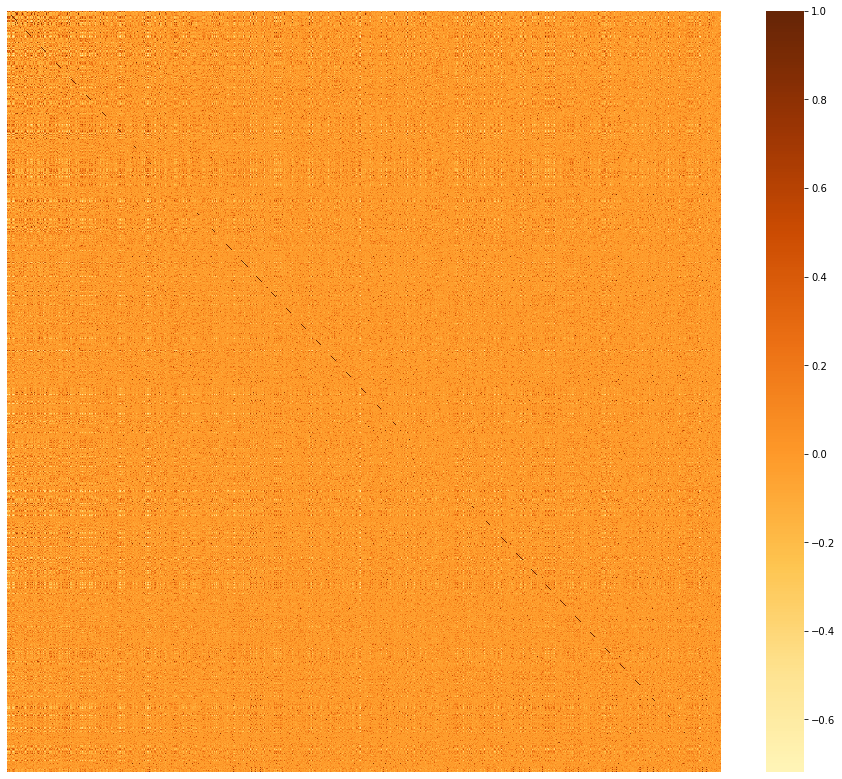

In [ ]:
plt.figure(figsize=(16,14))
#df_small = df.iloc[:, :50]
#c= df_small.corr()
corr = unfilt.iloc[:3000,:].T.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()
#sns.heatmap(c,cmap='coolwarm',annot=True, center=midpoint )
sns.heatmap(corr,cmap="YlOrBr", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

But again we can clearly see how there's not a well defined structure among the genes.


---

Given what we've seen in the table `unfilt` we suspect that our dataset will be probably very sparsed, so we want to quantify that sparsity in some way. The first and more intutive one is to calculate the average sparsity and to plot the table in some way



In [ ]:
#Avarage density of zeros in the data

print(f"The average sparsity of the table is: {(unfilt == 0).sum().sum() / (unfilt.shape[0] * unfilt.shape[1]) * 100}%")

The average sparsity of the table is: 63.62213333333333%


This is a pretty high value! our dataset is definitely sparsed.

In the following plot we color with blue the points in the table that are different from zero. This can give us an idea of how this high sparsity is distributed across the dataset

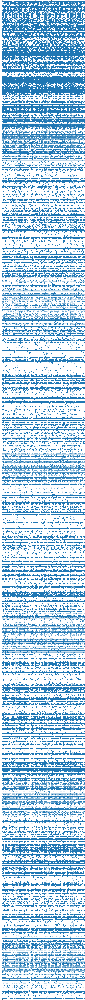

In [ ]:
plt.figure(figsize=(25, 600))
plt.spy(unfilt.iloc[:, :], markersize=5)

If we compare this graph to the ones obtained on the unfiltered data, we see how we cannot find entire white vertical lines, this is becasue pronblematic cells have been filtered out.

Again, we can see much more homogeneity in the sparsity

The great limitation of this plot is that we don't have a differentiation among values of the expression (but we will have a more complete picture with an heatmap leater), to have an idea of that we use the function `describe()` on our dataset and we plot an histogram of the expression for some randomly choosen cells

In [ ]:
unfilt.describe()

,output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam,output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam,output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam,output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam,output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam,output.STAR.2_B9_Hypo_S81_Aligned.sortedByCoord.out.bam,output.STAR.2_C10_Hypo_S130_Aligned.sortedByCoord.out.bam,output.STAR.2_C11_Hypo_S131_Aligned.sortedByCoord.out.bam,output.STAR.2_C1_Norm_S103_Aligned.sortedByCoord.out.bam,output.STAR.2_C2_Norm_S104_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
count,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,...,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000
mean,74.140333,90.907000,99.089000,88.137000,110.395667,148.849000,126.422667,142.229667,91.781000,91.426333,...,144.008333,133.846000,98.699333,84.070333,101.416333,96.636667,92.344333,154.387333,125.340000,132.017667
std,345.005307,409.560228,442.980702,425.804372,822.178446,1710.088769,1351.567001,1515.496440,388.660906,376.793214,...,1349.125183,1242.320764,417.410827,406.100983,513.988262,499.224863,680.698856,1169.686762,1066.926126,1422.143351
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,24.000000,37.000000,33.000000,34.000000,38.250000,24.000000,13.000000,22.000000,37.000000,44.000000,...,33.000000,38.000000,52.250000,25.000000,33.000000,44.000000,17.000000,19.000000,21.000000,20.250000
max,8222.000000,10167.000000,11446.000000,10312.000000,30586.000000,65037.000000,52680.000000,60789.000000,9394.000000,9077.000000,...,56392.000000,50404.000000,11352.000000,8713.000000,17006.000000,16625.000000,29663.000000,34565.000000,34175.000000,57814.000000


Text(0, 0.5, 'Frequency')

<Figure size 1440x1224 with 0 Axes>

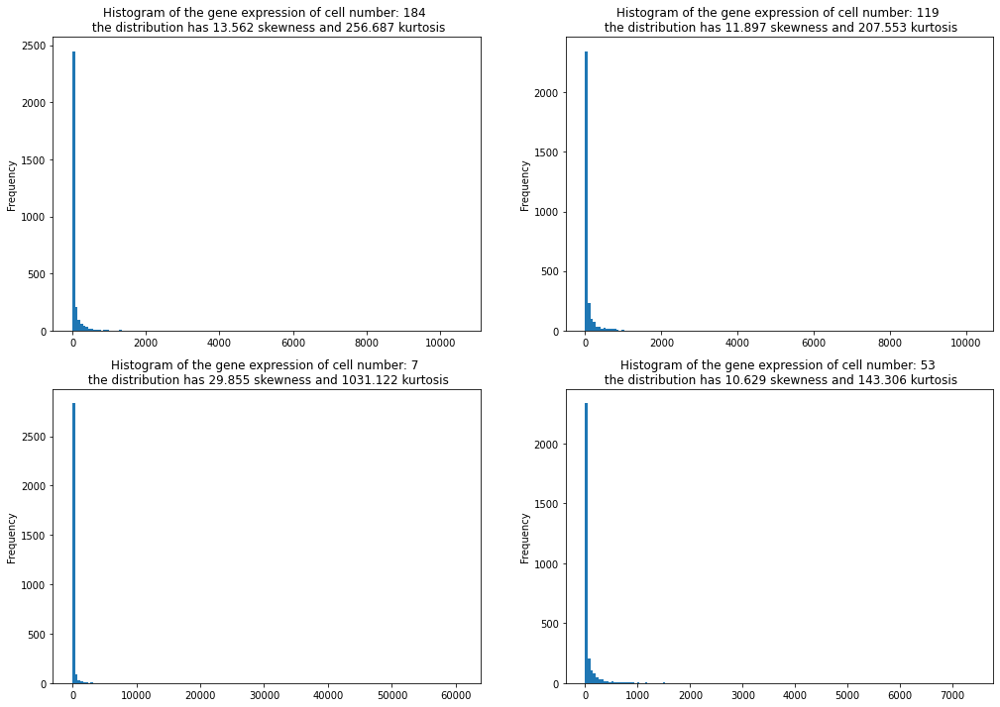

In [ ]:
from scipy.stats import kurtosis, skew

plt.figure(figsize=(20, 17))

first_cell = random.randrange(unfilt.shape[1])
second_cell = random.randrange(unfilt.shape[1])
third_cell = random.randrange(unfilt.shape[1])
fourth_cell = random.randrange(unfilt.shape[1])

plt.figure(figsize=(17, 12))

plt.subplot(2, 2, 1)
plt.hist(unfilt.iloc[:,first_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {first_cell} \n the distribution has {round(skew(unfilt.iloc[:,first_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,first_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 2)
plt.hist(unfilt.iloc[:,second_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {second_cell} \n the distribution has {round(skew(unfilt.iloc[:,second_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,second_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 3)
plt.hist(unfilt.iloc[:,third_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {third_cell} \n the distribution has {round(skew(unfilt.iloc[:,third_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,third_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 4)
plt.hist(unfilt.iloc[:,fourth_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {fourth_cell} \n the distribution has {round(skew(unfilt.iloc[:,fourth_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,fourth_cell]), 3)} kurtosis")
plt.ylabel("Frequency")



The result is showing is that even if the data are filtered and normalized, the distribution of counts among the cells is the same. 

---

Now that we assessed that there are a lot of zeros in our dataset, we want to see for some genes how is the distributions on non-zero values, to compare it to the one we had in the case of unfiltered and unnormalized data.

Text(0, 0.5, 'Frequency (possibly scaled)')

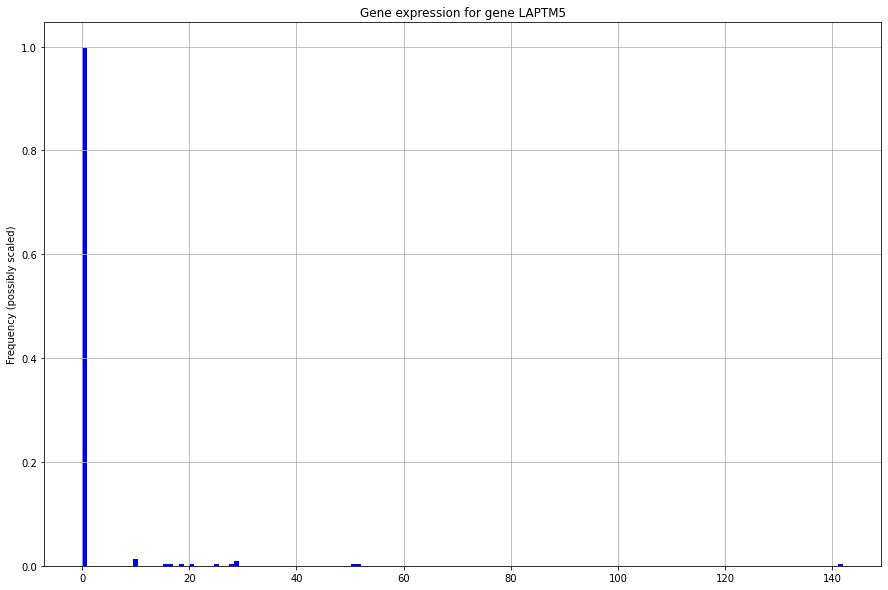

In [ ]:
rdn_gene = random.randrange(unfilt.shape[0])

plt.figure(figsize=(15, 10))
unfilt.iloc[rdn_gene, :].plot.hist(grid=True,
                                      density = True, 
                                      bins=150,
                                      color='blue')

plt.title(f"Gene expression for gene {unfilt.index[rdn_gene]}")
plt.ylabel("Frequency (possibly scaled)")

But we see that the distribution is similar to the one in the unfiltered case

The distribution seems therefore to follow a Poisson/Negative binomial distribution.

--- 
Given what stated above, we further investigate the ralation between mean and variance of the gene expression among cells to see if we would prefer adopting a Negative Binomial ditribution:

Text(0, 0.5, 'Variance')

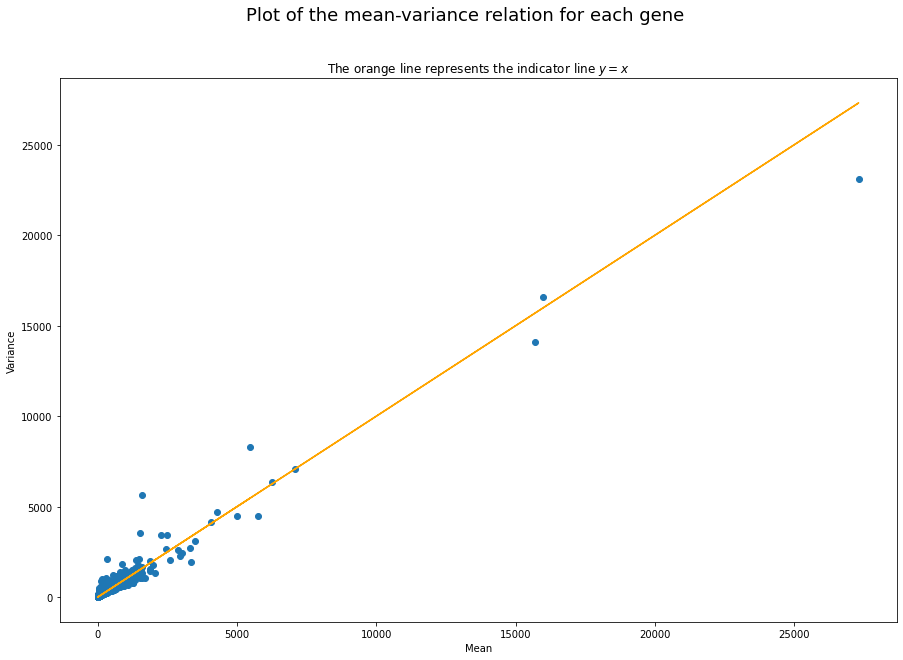

In [ ]:
##################### THIS PLOT COULD TAKE SOME TIME ########################
mean_vector = unfilt.T.describe().iloc[1,:]
var_vector = unfilt.T.describe().iloc[2,:]

plt.figure(figsize=(15, 10))
plt.scatter(mean_vector, var_vector)
plt.plot(mean_vector, mean_vector, color = "orange")
plt.title("The orange line represents the indicator line $y=x$", fontsize = 12)
plt.suptitle("Plot of the mean-variance relation for each gene", fontsize = 18)
plt.xlabel("Mean")
plt.ylabel("Variance")



Here we observe that the mean-variace relation is mantained! The filtering just eliminated some outlier cells!

Loading the filtered and normalised datafile for MCF7-DropSeq

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_Filtered_Normalised_3000_Data_train.txt', delimiter = " ", index_col = 0)
print("data frame dimensions :", np.shape(df))
df.head()

In [ ]:
# t_meta = meta.T
# print(t_meta.shape)
# hypo_ind = (meta["Condition"] == "Hypo")
# hypo_ind = hypo_ind.to_numpy()
# norm_ind = (~(hypo_ind))
# norm_ind.sum()
# hypo_ind

### Dimensionality Reduction

> Throughout this section, we will be applying a Principal Components Analysis for the purpose of analyzing data and dimensionality reduction, as well as other dimensionality reduction techniques and discuss their outcomes.

We start by converting our Pandas DataFrame into a NumPy array.

In [ ]:
data = df.to_numpy()

Then, we extract the indices of hypoxic and normoxic cells and build two lists out of them

In [ ]:
l_hypoxia = get_condition_list(df, "Hypo")
l_normoxia = get_condition_list(df, "Norm")
print(len(l_normoxia))
l_hypoxia[:10], l_normoxia[:10]

12705


([12705, 12706, 12707, 12708, 12709, 12710, 12711, 12712, 12713, 12714],
 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

#### PCA

As we import the PCA function from the SKLearn library, we proceed to apply it to our dataset, requesting a 95% variance expression on the reduced outcome.

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pca = PCA(n_components = 0.95)
data_red = pca.fit_transform(data.T)
pca.n_components_

761

As we might have expected from the increased size of the dataset, we now need 761 principal components in order to express 95% of the variance.


In [ ]:
data_red.shape

(21626, 761)

In [ ]:
pca.explained_variance_ratio_[:3]

array([0.24948472, 0.0862724 , 0.0443336 ])

We now plot the results, starting from a 2D scatter plot on the two main principal components.

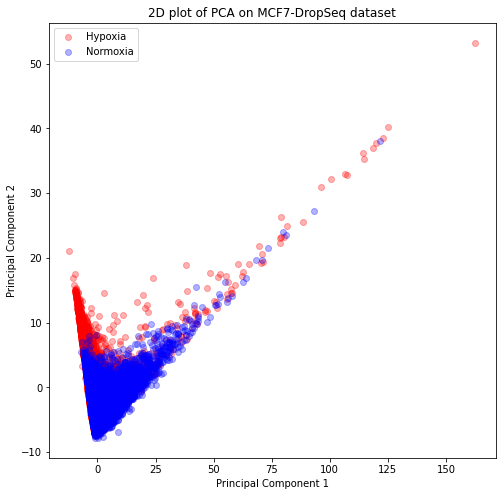

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_title('2D plot of PCA on MCF7-DropSeq dataset')

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3, label="Normoxia")
ax.legend()
plt.show()

Next, we can again build a scatter plot, 3D this time, as we take into account the third principal component as well.

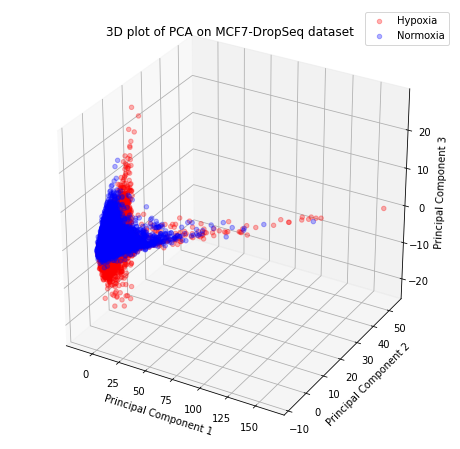

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D plot of PCA on MCF7-DropSeq dataset')

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], data_red[l_hypoxia,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], data_red[l_normoxia,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

##### Interactive 3D version
> Might take a few minutes to run

Notice. The following implementation is quite time-consuming when executed on large-sized datasets (since a simpler static version of the 3D plot has been implemented above, we provide the code cell below commented).

In [ ]:
plot_df = pd.DataFrame(data_red[:, 0:3])
plot_df.columns = ["PC1","PC2","PC3"]

aux_lst = []
for name in df.columns.values:
  if 'Hypo' in name:
    aux_lst.append(1)
  elif 'Norm' in name:
    aux_lst.append(0)

plot_df["Color"] = aux_lst
plot_df

,x,y,z,Color
0,-26874.672396,766.013957,-880.248212,0
1,-26354.743000,5039.849020,-5372.826809,0
2,-29351.253485,2414.726753,-3076.254097,0
3,-24813.833293,-75.979072,-3934.877133,0
4,4454.732179,-1836.273354,-1595.912696,1
...,...,...,...,...
245,-18394.340467,-5274.416642,649.525614,0
246,-10023.164045,-14507.616731,-1941.969647,0
247,603.697715,11492.308191,43230.690452,1
248,17016.931253,8398.335833,4439.884803,1


In [ ]:
# !pip install jupyter-dash

import plotly.graph_objects as go
import plotly.express as px
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

fig = px.scatter_3d(
    data_frame = plot_df,
    x = "PC1",
    y = "PC2",
    z = "PC3",
    color = "Color",
    title = "Interactive PCA plot with supervised labels",
)

# build jupyter dash app 
app = JupyterDash(__name__)
# add html components and figure to app
app.layout = html.Div([dcc.Graph(figure=fig)])
# run app inline
app.run_server(mode='inline')

<IPython.core.display.Javascript object>

#### t-SNE


We first import TSNE from the SKLearn library

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

Now, PCA is carried out on the dataframe, and all the data is mapped into a 50-dimensional space.
PCA is performed as a sort of pre-processing stage because t-SNE does not work properly on datasets having too many features (in this case the initial dataset have 3000 features), so we need to reduce the dimensionality to about 50 (a number of features with which t-SNE produces good results).

In [ ]:
pca50 = PCA(n_components=50)
data_fifty = pca50.fit_transform(data.T)
data_fifty.shape

(21626, 50)

In [ ]:
pca50.explained_variance_ratio_[0:4]

array([0.24948472, 0.0862724 , 0.0443336 , 0.02627554])

We now apply t-SNE on the output of PCA (i.e. the data_fifty reduced dataset).

In [ ]:
# This takes a long time (more than 7 minutes on Colab)
embedded = TSNE(n_components=2, learning_rate='auto', init='random').fit_transform(data_fifty)

In [ ]:
embedded.shape

(21626, 2)

We now plot the results.

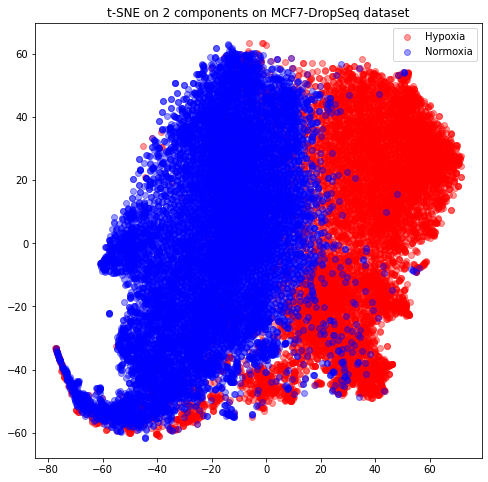

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.scatter(embedded[l_hypoxia,0], embedded[l_hypoxia,1], c="r",alpha = 0.4, label="Hypoxia")
ax.scatter(embedded[l_normoxia,0], embedded[l_normoxia,1], c="b",alpha = 0.4, label="Normoxia")
ax.set_title('t-SNE on 2 components on MCF7-DropSeq dataset')
ax.legend()

plt.show()

We now visualize how the t-SNE plot changes as we introduce ‘pca’ as init. Given both previous cases, we would expect to get a very close plot to the one described by the PCA function.

In [ ]:
Also this take a long time
embedded2 = TSNE(n_components=2, learning_rate='auto', init='pca').fit_transform(data_fifty)

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.set_title('2 component t-SNE on MCF7-DropSeq dataset (pca as init)', fontsize = 15)

ax.scatter(embedded2[l_hypoxia,0], embedded2[l_hypoxia,1], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(embedded2[l_normoxia,0], embedded2[l_normoxia,1], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

In opposition to our assumption, the outcome seems to be very different from the visualization of the actual PCA. To understand why this happened, we need to go back to the criteria we chose for the implementation of t-SNE. As a matter of fact, we have been using 50-component PCA reductions to fit the model: this amount of principal components is more than sufficient to express 95% of the variance in both SmartSeq datasets - which explains the nearly perfect match with the actual PCA -; on the dataset considered, however, fifty components are a significantly low number of directions compared to the 761 selected for the 95% variance expression, thus, the high graphical divergence between the two plots.

#### UMAP

Let's first install the umap library

In [ ]:
# !pip install umap-learn

     |████████████████████████████████| 88 kB 3.0 MB/s 
     |████████████████████████████████| 1.1 MB 40.7 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=ce75bd95b80eaa7196e8381fc04923b2f808201bc2b92e7c2a20cc713b4ff08c
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.7-py3-none-any.whl size=54286 sha256=f7e687ffcf649d46a44e5827938b3ddca0a60de035d4c051298bef1995aec004
  Stored in directory: /root/.cache/pip/wheels/7f/2a/f8/7bd5dcec71bd5c669f6f574db3113513696b98f3f9b51f496c
Successfully built umap-learn pynndescent


In [ ]:
from umap import UMAP

In [ ]:
reducer = UMAP()

embedding_data = reducer.fit_transform(data.T)
embedding_data.shape

(21626, 2)

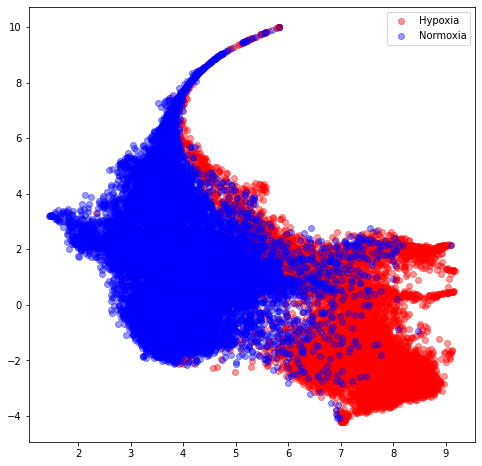

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.scatter(embedding_data[l_hypoxia, 1], embedding_data[l_hypoxia,0], c="r",alpha = 0.4, label="Hypoxia")
ax.scatter(embedding_data[l_normoxia, 1], embedding_data[l_normoxia,0], c="b",alpha = 0.4, label="Normoxia")
ax.legend()
plt.show()

### Clustering methods on Reduced dataset
> For a matter of computational convenience, we consider the reduced dataset expressing 95% of the variance.

As we may have noticed in the dimensionality reduction section above, the plot visualizing the PCA method shows that the data has a less clear as in the lower-size datasets, while t-SNE still gives us a reasonably clearer visualization. Thus, we will use this latter visualization to plot the comparisons.

#### K-means

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans = KMeans(n_clusters=2, random_state=42)
pred_clus = kmeans.fit_predict(data_red)

In [ ]:
hypo = (pred_clus == 1)
norm = (pred_clus == 0)

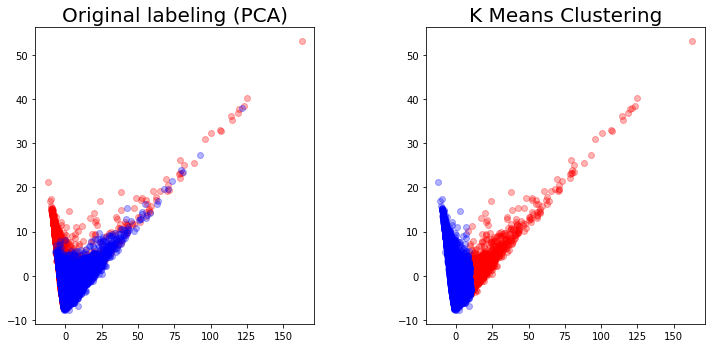

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax.scatter(embedded[l_hypoxia,0],embedded[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(embedded[l_normoxia,0],embedded[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(embedded[hypo,0],embedded[hypo,1], c="r",alpha = 0.3)
ax1.scatter(embedded[norm,0],embedded[norm,1], c="b",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

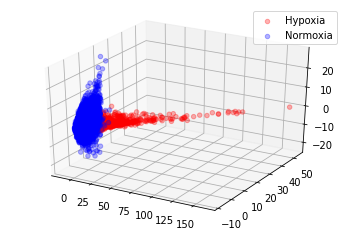

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo,0],data_red[hypo,1], data_red[hypo,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm,0],data_red[norm,1], data_red[norm,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

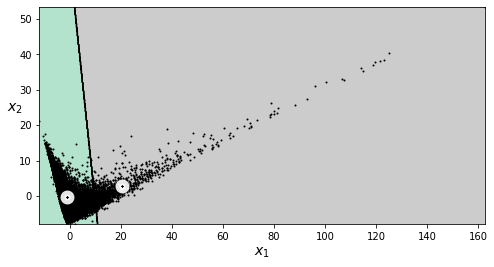

In [ ]:
kmeans.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 4))
plot_decision_boundaries(kmeans, data_red[:, 0:2])
plt.show()

By observing the plots, we can notice that K-Means clustering in actually quite far from the original labeling.

#### Gaussian mixture

In [ ]:
from sklearn.mixture import GaussianMixture

gm = GaussianMixture(n_components=2, random_state=42,
                     covariance_type = "diag")

In [ ]:
pred_mix = gm.fit_predict(data_red)

In [ ]:
hypo_mix = (pred_mix == 1)
norm_mix = (pred_mix == 0)

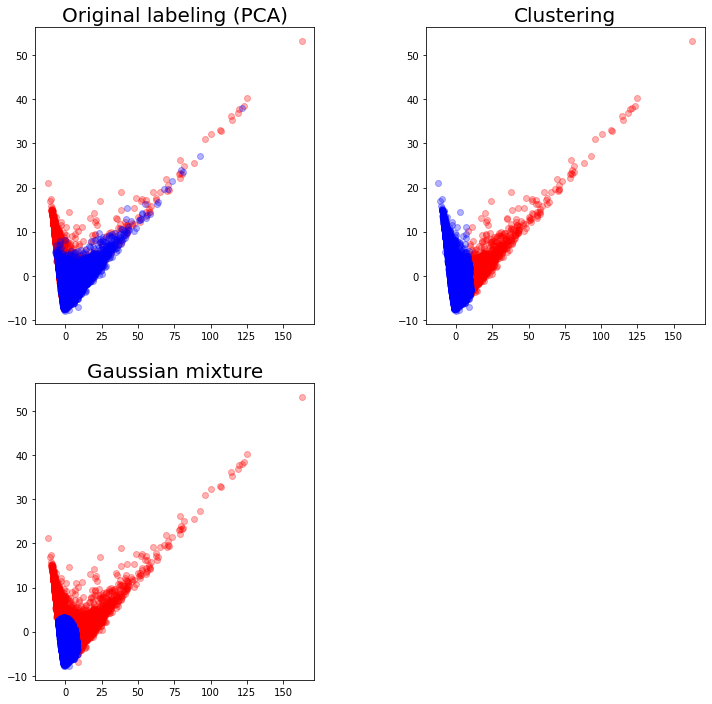

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax2 = fig.add_subplot(2,2,3)
ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax.scatter(embedded[l_hypoxia,0],embedded[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(embedded[l_normoxia,0],embedded[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(embedded[hypo,0],embedded[hypo,1], c="r",alpha = 0.3)
ax1.scatter(embedded[norm,0],embedded[norm,1], c="b",alpha = 0.3)

ax2.scatter(embedded[hypo_mix,0],embedded[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(embedded[norm_mix,0],embedded[norm_mix,1], c="b",alpha = 0.3)


plt.subplots_adjust(wspace=0.4)

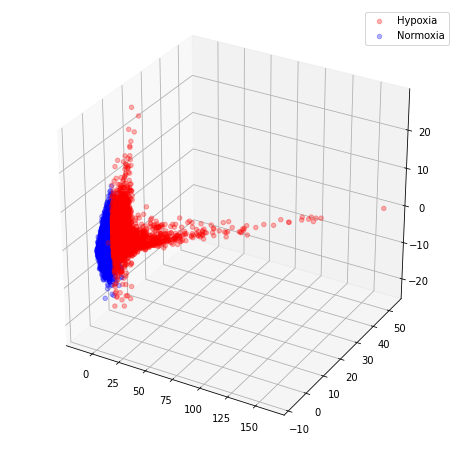

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], data_red[hypo_mix,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm_mix,0],data_red[norm_mix,1], data_red[norm_mix,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

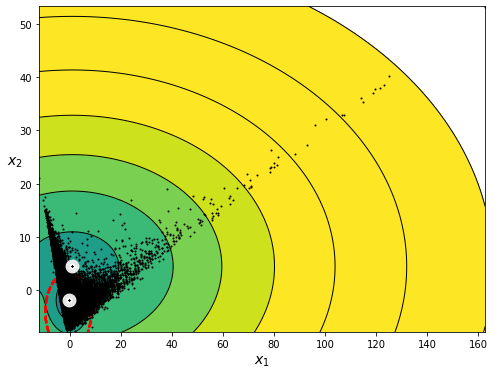

In [ ]:
gm.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 6))
plot_gaussian_mixture(gm, data_red[:, 0:2])
plt.show()

With Gaussian mixture plots do not seem to get better to the original labeling. However, nothing can be said for sure as two and three-dimensional plots gives us a very narrow view of the dataset space.

#### Bayesian Gaussian Mixture


Here we try to implement a different yet similar method to Gaussian Mixture. 

The Bayesian Gaussian Mixture is a method which allows you to not know the exact number of clusters in your data, in a sense it is better because by using a prior it understands how many clusters there should be.

In [ ]:
from sklearn.mixture import BayesianGaussianMixture

In [ ]:
bgm = BayesianGaussianMixture(n_components = 2, random_state = 42)
pred_bgm = bgm.fit_predict(data_red)

In [ ]:
hypo_bgm = (pred_bgm == 1)
norm_bgm = (pred_bgm == 0)

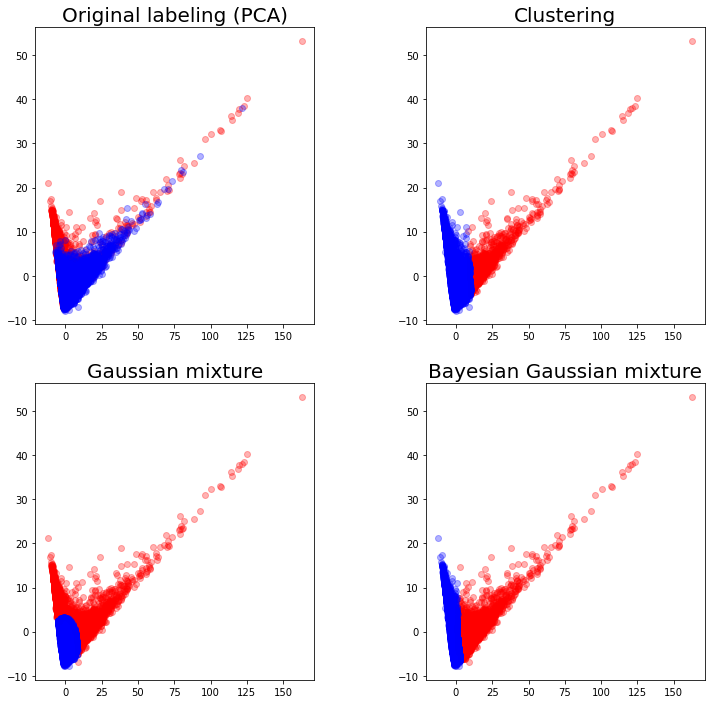

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,4)

ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax3.set_title('Bayesian Gaussian mixture', fontsize = 20)

ax.scatter(embedded[l_hypoxia,0],embedded[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(embedded[l_normoxia,0],embedded[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(embedded[hypo,0],embedded[hypo,1], c="r",alpha = 0.3)
ax1.scatter(embedded[norm,0],embedded[norm,1], c="b",alpha = 0.3)

ax2.scatter(embedded[hypo_mix,0],embedded[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(embedded[norm_mix,0],embedded[norm_mix,1], c="b",alpha = 0.3)

ax3.scatter(embedded[hypo_bgm,0],embedded[hypo_bgm,1], c="r",alpha = 0.3)
ax3.scatter(embedded[norm_bgm,0],embedded[norm_bgm,1], c="b",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

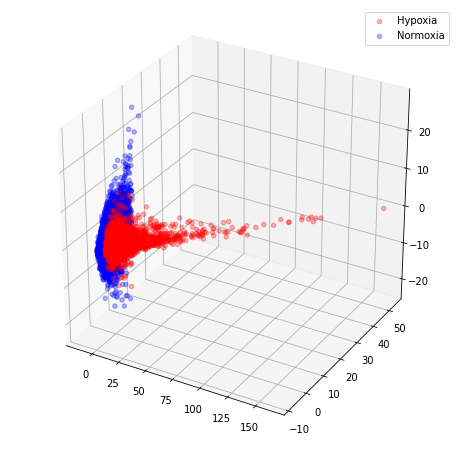

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo_bgm,0],data_red[hypo_bgm,1], data_red[hypo_bgm,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm_bgm,0],data_red[norm_bgm,1], data_red[norm_bgm,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

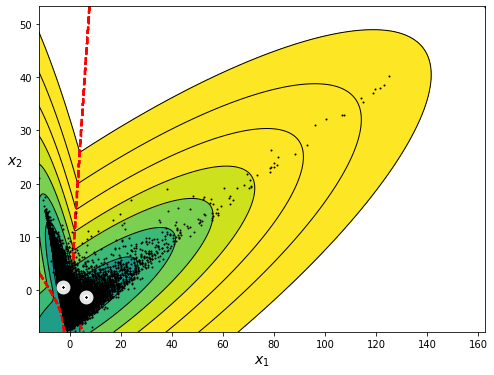

In [ ]:
bgm.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 6))
plot_gaussian_mixture(bgm, data_red[:, 0:2])
plt.show()

Again, the plots above show a very different outcome from the expected one. Nonetheless, we will now o see

#### Agglomerative Clustering

We are also interested on the behavior and performance of hierarchical clustering methods. 
In agglomerative algorithms, each item starts in its own cluster, then, objects are recursively clustered by similarity, i.e. the distances between groups, two items at a time. Eventually, all items will be grouped in one cluster.
We choose to implement Agglomerative Clustering, as it is the most commonly used technique of this kind.

In [ ]:
from sklearn.cluster import AgglomerativeClustering

In [ ]:
aggl = AgglomerativeClustering(n_clusters=2, linkage='ward')

In [ ]:
pred_aggl = aggl.fit_predict(data_red)

In [ ]:
hypo_aggl = (pred_aggl == 1)
norm_aggl = (pred_aggl == 0)

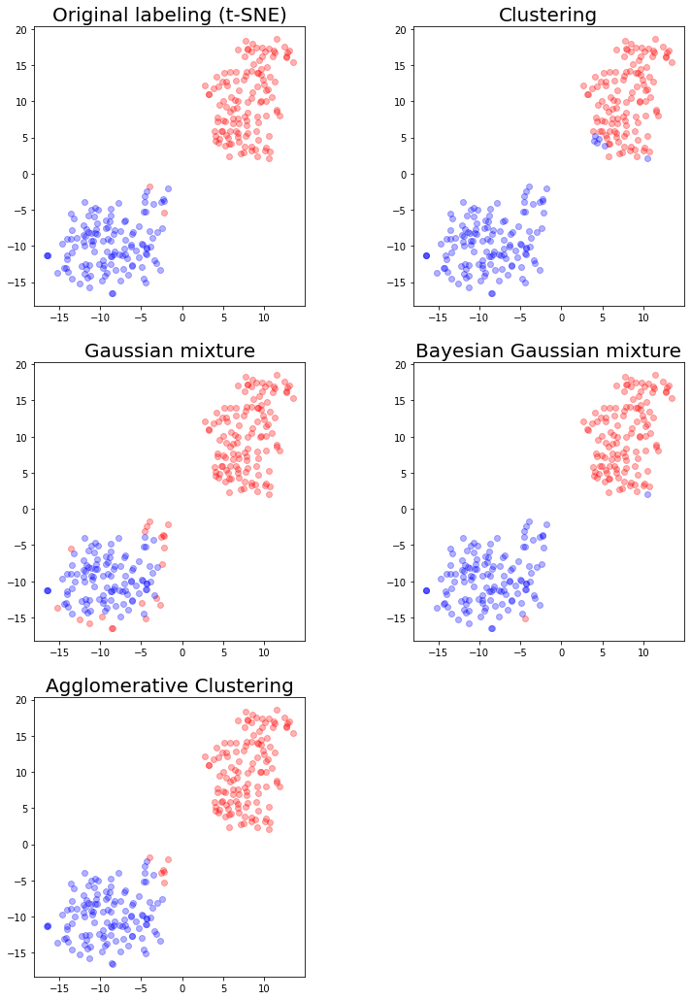

In [ ]:
fig = plt.figure(figsize = (12,18))
ax = fig.add_subplot(3,2,1)
ax1 = fig.add_subplot(3,2,2)
ax2 = fig.add_subplot(3,2,3)
ax3 = fig.add_subplot(3,2,4)
ax4 = fig.add_subplot(3,2,5)

ax.set_title('Original labeling (t-SNE)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax3.set_title('Bayesian Gaussian mixture', fontsize = 20)

ax4.set_title('Agglomerative Clustering', fontsize = 20)

ax.scatter(embedded[l_hypoxia,0],embedded[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(embedded[l_normoxia,0],embedded[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(embedded[hypo,0],embedded[hypo,1], c="r",alpha = 0.3)
ax1.scatter(embedded[norm,0],embedded[norm,1], c="b",alpha = 0.3)

ax2.scatter(embedded[hypo_mix,0],embedded[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(embedded[norm_mix,0],embedded[norm_mix,1], c="b",alpha = 0.3)

ax3.scatter(embedded[hypo_bgm,0],embedded[hypo_bgm,1], c="r",alpha = 0.3)
ax3.scatter(embedded[norm_bgm,0],embedded[norm_bgm,1], c="b",alpha = 0.3)

ax4.scatter(embedded[hypo_aggl,0],embedded[hypo_aggl,1], c="b",alpha = 0.3)
ax4.scatter(embedded[norm_aggl,0],embedded[norm_aggl,1], c="r",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

This clustering method can be easily visualized in 2D plots known as dendograms, in which the clusters at each step of the algorithm can be clearly displayed. With the following cell, we will try to implement dendograms for each linkage method available for AgglomerativeClustering.

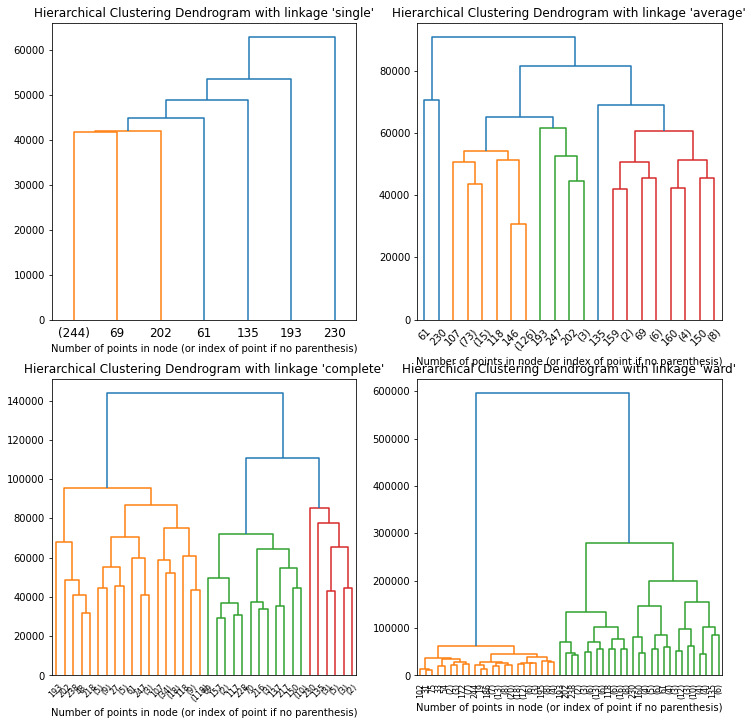

In [ ]:
# setting distance_threshold=0 ensures we compute the full tree.
l_linkage = ['single', 'average', 'complete', 'ward']

fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12,12))

for n, linkage in enumerate(l_linkage):
    model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, linkage=linkage)
    model = model.fit(data.T)

    ax = plt.subplot(2, 2, n + 1)
    # plot the top five levels of the dendrogram
    plot_dendrogram(model, truncate_mode="level", p=5)
    ax.set_title("Hierarchical Clustering Dendrogram with linkage " + "'" + linkage + "'")
    ax.set_xlabel("Number of points in node (or index of point if no parenthesis)")

plt.show()

#### Evaluating Clustering methods 

We will now look at how the various clusterings perform in understanding whether a cell is an Hypoxia one or not.

We will do it over the normal data, i.e. 'df' transposed, that is data.T

In [ ]:
y = []
for i in range(len(l_hypoxia) + len(l_normoxia)):
  if i in l_hypoxia:
    y.append(1)
  elif i in l_normoxia:
    y.append(0)

##### K Means Clustering

In [ ]:
y_pred_clus = kmeans.fit_predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_clus==y))
print("fraction of correct predictions", np.sum(y_pred_clus==y) / len(y_pred_clus))

correct predictions:  9826
fraction of correct predictions 0.45436049200036993


##### Gaussian Mixture

In [ ]:
gm.fit(data.T)
y_pred_mix = gm.predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_mix==y))
print("fraction of correct predictions", np.sum(y_pred_mix==y) / len(y_pred_mix))

correct predictions:  241
fraction of correct predictions 0.964


##### Bayesian Gaussian Mixture

In [ ]:
bgm.fit(data.T)
y_pred_bgm = bgm.predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_bgm==y))
print("fraction of correct predictions", np.sum(y_pred_bgm==y) / len(y_pred_bgm))

correct predictions:  244
fraction of correct predictions 0.976


By observing these results, we can conclude that all clustering methods implemented above, be them Kmeans, GM, or BGM, perform rather poorly on this larger dataset.

###Classifiers

#### Preprocessing: PCA reduction for hyperparameters tuning

The Classifiers section for DropSeq datasets is carried out in a very similar fashion to the Classifiers for SmartSeq datasets.
However, we now need to take into account the significantly larger dimensionality of the datasets. Applying the same methods we used for SmartSeq would result in unsustainable running times (especially for grid search). 
For this reason, we will run grid search (and obtain the best hyperparameters) on a PCA-reduced dataset, where we will lower the number of features and therefore reduce the running time. 
After obtaining the best-performing hyperparameters, we will implement the models on the original dataset, using exactly those parameters.


In [ ]:
from sklearn.decomposition import PCA

#MC_drop_T stands for MCF7 DropSeq, transposed
MC_drop_T = df.T
X = MC_drop_T.to_numpy()
pca = PCA(n_components=0.6) # We accept a low explained variance, since the Random Forest and Gradient Bossting classifiers
# are very time-consuming
X_red = pca.fit_transform(X)

In [ ]:
X_red.shape

(21626, 34)

In [ ]:
sum(pca.explained_variance_ratio_)

0.6030874057396105

We now add the "Condition" column with 0,1 labels for Normoxic and Hypoxic cells.

In [ ]:
from sklearn.model_selection import train_test_split

condition = []
for i in list(MC_drop_T.index):
  if "Normoxia" in i:
    condition.append(0)
  if "Hypoxia" in i:
    condition.append(1)
MC_drop_T["Condition"] = condition

y = np.array(condition)
 
X_train_red, X_test_red, y_train_red, y_test_red = train_test_split(X_red, y, test_size=0.33, random_state = 42)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state = 42)

In [ ]:
(X_train_red.shape, X_test_red.shape, X_train.shape, X_test.shape, )

((14489, 34), (7137, 34), (14489, 3000), (7137, 3000))

#### Random Forest

In [ ]:
from sklearn.model_selection import GridSearchCV
from  sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(criterion = "gini", random_state=42)

p_grid = {'n_estimators': [800, 1200]}

gs = GridSearchCV(rfc, param_grid = p_grid).fit(X_train_red, y_train_red)
gs.best_params_

In [ ]:
from  sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

rfc = RandomForestClassifier(n_estimators = gs.best_params_['n_estimators'], 
                             min_samples_leaf = 1, 
                             min_samples_split = 2,
                             criterion="gini", random_state = 42)

rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
accuracy_score(y_pred, y_test)

##### Analysing relationship between Principal Components and accuracy

We will now move to the analysis of how the accuracy of our Random Forest changes as we consider more and more principal components of our data. 

In [ ]:
df_train_MC7 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/DropSeq/MCF7_Filtered_Normalised_3000_Data_train.txt", sep = " ")

In [ ]:
namesM = df_train_MC7.columns.values
df_train_MC7_t = df_train_MC7.T
df_train_MC7_t["Classification"] = [i for i in range(len(namesM))]


for i in range(len(namesM)):
    if "Hypo" in namesM[i]:
        df_train_MC7_t["Classification"][i] = 1
    else:
        df_train_MC7_t["Classification"][i] = 0

l = list(df_train_MC7_t["Classification"])

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from  sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score

acc_list = []
dim_list = [i for i in range(1, 20)]
for i in range(1, 20):

  #PCA
  X = df_train_MC7.to_numpy()
  X_t = np.transpose(X)
  pca = PCA(n_components = i)
  Xred = pca.fit_transform(X_t)
  df_red = pd.DataFrame(Xred)
  
  #Creating the classification framework 
  df_red["Classification"] = l

  
  X = df_red.iloc[:,:-1]
  y = df_red["Classification"]
  
  
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state = 42)
  
  #Fitting the random forest
  rfc = RandomForestClassifier(n_estimators = 200, 
                               min_samples_leaf = 1, 
                               min_samples_split = 2,
                               criterion="gini", random_state = 42)

  rfc.fit(X_train, y_train)
  y_pred = rfc.predict(X_test)
  acc_list.append(accuracy_score(y_pred, y_test))

<BarContainer object of 19 artists>

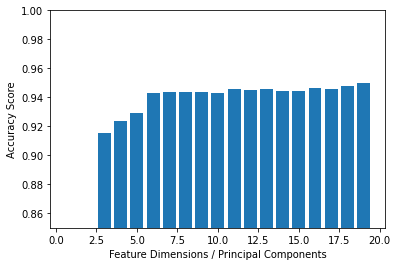

In [ ]:
#plotting the accuracy scores
plt.figure(figsize = (30,15))
plt.xlabel("Feature Dimensions / Principal Components", )
plt.ylabel("Accuracy Score")
plt.ylim([0.85, 1])

plt.bar(dim_list, acc_list)

#### Gradient Boosting

In [ ]:
(X_train_red.shape, X_test_red.shape, X_train.shape, X_test.shape)

((14489, 34), (7137, 34), (14489, 3000), (7137, 3000))

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

gb_clf = GradientBoostingClassifier(random_state = 42)

p_grid = {'max_features' : [10, 20], 
          'max_leaf_nodes' : [16],
          'n_estimators' : [400]}

gs = GridSearchCV(gb_clf, param_grid = p_grid).fit(X_train_red, y_train_red)
gs.best_params_

{'max_features': 10, 'max_leaf_nodes': 16, 'n_estimators': 400}

In [ ]:
gb_clf = GradientBoostingClassifier(learning_rate = 0.1,
                                    max_features = gs.best_params_['max_features'],
                                    max_leaf_nodes = gs.best_params_['max_leaf_nodes'],
                                    n_estimators = gs.best_params_['n_estimators'])

gb_clf.fit(X_train, y_train)
y_pred = gb_clf.predict(X_test)
accuracy_score(y_pred, y_test)

0.9722572509457755

#### SVM

In [ ]:
(X_train_red.shape, X_test_red.shape, X_train.shape, X_test.shape)

((14489, 34), (7137, 34), (14489, 3000), (7137, 3000))

In [ ]:
from sklearn.svm import SVC

svc = SVC()
parameters = {'kernel':('linear', 'rbf'), 'C':[1, 10]}

clf = GridSearchCV(svc, parameters).fit(X_train_red, y_train_red)
print(clf.best_params_)
clf.best_params

In [ ]:
svc = SVC(C=clf.best_params_["C"],
          kernel=clf.best_params_["kernel"])

svc.fit(X_train, y_train)
y_pred = svc.predict(X_test)
accuracy_score(y_pred, y_test)

0.9812246041754239

#### Neural Network

In [ ]:
df_train_MC7 = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/MCF7_Filtered_Normalised_3000_Data_train.txt", sep = " ") 

In [ ]:
namesM = df_train_MC7.columns.values

Distinguish Hypoxia and Normoxia Cells

In [ ]:
df_train_MC7_t = df_train_MC7.T
df_train_MC7_t["Classification"] = [i for i in range(len(namesM))]

for i in range(len(namesM)):
    if "Hypo" in namesM[i]:
        df_train_MC7_t["Classification"][i] = 1
    else:
        df_train_MC7_t["Classification"][i] = 0

Now divide dataset 

In [ ]:
from sklearn.model_selection import train_test_split

X = df_train_MC7_t.iloc[:,:-1]
y = df_train_MC7_t["Classification"]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.23, random_state = 42)

In [ ]:
x_valid, x_train = X_train[:1000], X_train[1000:]
y_valid, y_train = y_train[:1000], y_train[1000:]

In [ ]:
model = Sequential()
model.add(Dense(units=512, activation= "relu", input_shape= (3000,)))
model.add(Dense(units= 256, activation= "relu"))
model.add(Dense(units= 256, activation= "relu"))
model.add(Dense(units= 64, activation= "relu")) 
model.add(Dense(1, activation= 'sigmoid'))
	
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer=keras.optimizers.SGD(learning_rate=0.01, momentum=0.2),
              metrics=['accuracy'])



In [ ]:
model.fit(x_train, y_train, epochs = 20, validation_data = (x_valid, y_valid))

Epoch 1/20


/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


488/490 [============================>.] - ETA: 0s - loss: 0.2045 - accuracy: 0.9346

/usr/local/lib/python3.7/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


490/490 [==============================] - 14s 27ms/step - loss: 0.2043 - accuracy: 0.9346 - val_loss: 0.0968 - val_accuracy: 0.9710
Epoch 2/20
490/490 [==============================] - 8s 16ms/step - loss: 0.0648 - accuracy: 0.9792 - val_loss: 0.0761 - val_accuracy: 0.9700
Epoch 3/20
490/490 [==============================] - 7s 15ms/step - loss: 0.0511 - accuracy: 0.9836 - val_loss: 0.0878 - val_accuracy: 0.9660
Epoch 4/20
490/490 [==============================] - 8s 15ms/step - loss: 0.0403 - accuracy: 0.9875 - val_loss: 0.0713 - val_accuracy: 0.9760
Epoch 5/20
490/490 [==============================] - 8s 15ms/step - loss: 0.0328 - accuracy: 0.9899 - val_loss: 0.0893 - val_accuracy: 0.9640
Epoch 6/20
490/490 [==============================] - 7s 15ms/step - loss: 0.0283 - accuracy: 0.9909 - val_loss: 0.0739 - val_accuracy: 0.9780
Epoch 7/20
490/490 [==============================] - 8s 15ms/step - loss: 0.0228 - accuracy: 0.9930 - val_loss: 0.0819 - val_accuracy: 0.9730
Epoch 8/2

In [ ]:
model.evaluate(X_test, y_test)

156/156 [==============================] - 1s 7ms/step - loss: 0.0892 - accuracy: 0.9783


[0.08923697471618652, 0.9782871007919312]

Saving figure keras_learning_curves_plot


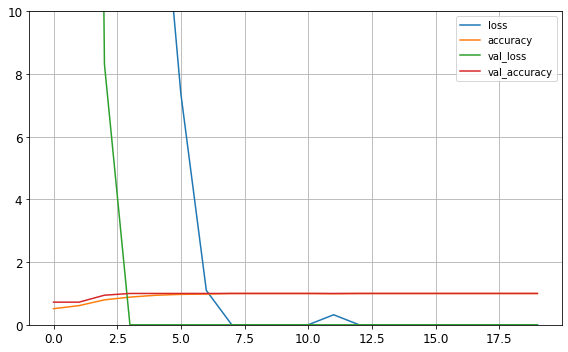

In [ ]:
import pandas as pd

pd.DataFrame(hist.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 10)
save_fig("keras_learning_curves_plot")
plt.show()

also the plot here exactly shows what we were expecting

## HCC1806

##Exploratory data analysis 


This datased was already provided "clean", filtered and normalized, therefore we will just limit ourself to explore it and try to see the differences with the Datasets explored in the previous part. The differences will come from the different sequencing technique and, as just stated, from the fact that the data are already processed

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns
import random

In [ ]:
unfilt = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_Filtered_Normalised_3000_Data_train.txt", sep = " ")

We display the actual table

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
print("The dimension of this dataset is:", unfilt.shape,"\n")
unfilt

The dimension of this dataset is: (3000, 250) 



,output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam,output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam,output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam,output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam,output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam,output.STAR.2_B9_Hypo_S81_Aligned.sortedByCoord.out.bam,output.STAR.2_C10_Hypo_S130_Aligned.sortedByCoord.out.bam,output.STAR.2_C11_Hypo_S131_Aligned.sortedByCoord.out.bam,output.STAR.2_C1_Norm_S103_Aligned.sortedByCoord.out.bam,output.STAR.2_C2_Norm_S104_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
CYP1B1,343,131,452,27,5817,3841,9263,21543,1013,53,...,7890,4512,160,351,327,196,504,34565,20024,5953
CYP1B1-AS1,140,59,203,7,2669,1565,3866,9113,459,22,...,3647,2035,75,138,130,102,238,13717,7835,2367
CYP1A1,0,0,0,0,0,79,238,443,0,0,...,86,1654,0,0,0,1,0,11274,563,522
NDRG1,0,1,0,0,654,1263,2634,540,0,13,...,481,1052,0,0,54,243,62,1263,925,1572
DDIT4,386,289,0,288,2484,2596,1323,2044,36,204,...,3692,2410,800,1,189,266,417,4256,12733,2275
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GRIK5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
SLC25A27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DENND5A,51,34,0,4,60,107,74,127,0,66,...,179,97,0,35,56,45,0,140,7,37
CDK5R1,0,0,0,0,0,0,0,0,0,8,...,0,0,26,0,0,19,0,0,0,0


We can first check if the data type is always the same across the features in the dataframe

In [ ]:
assert [unfilt.T.dtypes[i] == 'int64' for i in range(len(unfilt.T.dtypes))]
#And this is the case

First of all we want to see if there'are some missing value in the dataset. This is a standard operation that we want to do on a dataset, because if there are some missing entries we will have to deal with them somehow

In [ ]:
unfilt.isnull().sum(axis = 1).sum(axis = 0)
#Luckly enough there are not :)

0

Another standard procedure is the one to look for duplicate values among the features in our table. As pointed out in the suggestion notebook this could be due to many reasons: redundancy in gene annotation, overlapping of gene annotation on the same region, etc...

In [ ]:
dup_rows_unfilt = unfilt[unfilt.duplicated(keep=False)]
print("The number of duplicate rows is", dup_rows_unfilt.shape[0])

The number of duplicate rows is 2


Here the number of duplicate raws is zero as expected, the data were previously cleaned

---
Now we turn our attention to the study of the correlation between cells. In principle, given the fact that every gene expression in the table is coming from the same cell line we expect overall an high correlation among them.

In [ ]:
plt.figure(figsize=(12,10))

corr = unfilt.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()

sns.heatmap(corr,cmap="mako", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

We can see from the plot above that the correlation structure is much more homogeneus now, if compared to the unfiltered data. 

We now want to analyse the structure among the covariates. Notice that here due to computational power issues we display the correlation just of the first 10% of the genes.

Average correlation between cells:  0.1409328696690194
Minimum correlation between cells:  -0.7181342606619613 



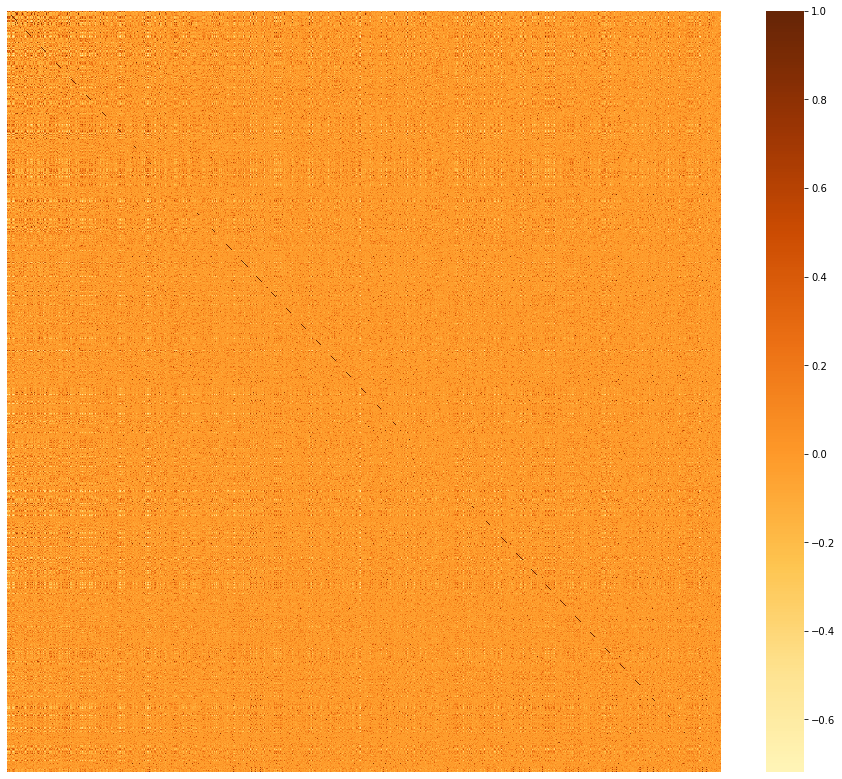

In [ ]:
plt.figure(figsize=(16,14))
#df_small = df.iloc[:, :50]
#c= df_small.corr()
corr = unfilt.iloc[:3000,:].T.corr()
midpoint = (corr.values.max() - corr.values.min()) /2 + corr.values.min()
#sns.heatmap(c,cmap='coolwarm',annot=True, center=midpoint )
sns.heatmap(corr,cmap="YlOrBr", center=0, yticklabels=False , xticklabels=False)

print("Average correlation between cells: ", midpoint)
print("Minimum correlation between cells: ", corr.values.min(), "\n")

But again we can clearly see how there's not a well defined structure among the genes.


---

Given what we've seen in the table `unfilt` we suspect that our dataset will be probably very sparsed, so we want to quantify that sparsity in some way. The first and more intutive one is to calculate the average sparsity and to plot the table in some way



In [ ]:
#Avarage density of zeros in the data

print(f"The average sparsity of the table is: {(unfilt == 0).sum().sum() / (unfilt.shape[0] * unfilt.shape[1]) * 100}%")

The average sparsity of the table is: 63.62213333333333%


This is a pretty high value! our dataset is definitely sparsed.

In the following plot we color with blue the points in the table that are different from zero. This can give us an idea of how this high sparsity is distributed across the dataset

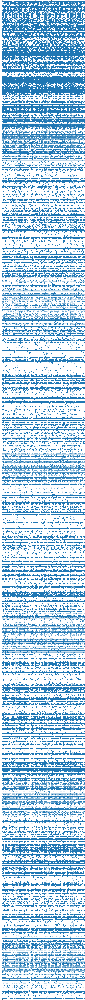

In [ ]:
plt.figure(figsize=(25, 600))
plt.spy(unfilt.iloc[:, :], markersize=5)

If we compare this graph to the ones obtained on the unfiltered data, we see how we cannot find entire white vertical lines, this is becasue pronblematic cells have been filtered out.

Again, we can see much more homogeneity in the sparsity

The great limitation of this plot is that we don't have a differentiation among values of the expression (but we will have a more complete picture with an heatmap leater), to have an idea of that we use the function `describe()` on our dataset and we plot an histogram of the expression for some randomly choosen cells

In [ ]:
unfilt.describe()

,output.STAR.2_B3_Norm_S57_Aligned.sortedByCoord.out.bam,output.STAR.2_B4_Norm_S58_Aligned.sortedByCoord.out.bam,output.STAR.2_B5_Norm_S59_Aligned.sortedByCoord.out.bam,output.STAR.2_B6_Norm_S60_Aligned.sortedByCoord.out.bam,output.STAR.2_B7_Hypo_S79_Aligned.sortedByCoord.out.bam,output.STAR.2_B9_Hypo_S81_Aligned.sortedByCoord.out.bam,output.STAR.2_C10_Hypo_S130_Aligned.sortedByCoord.out.bam,output.STAR.2_C11_Hypo_S131_Aligned.sortedByCoord.out.bam,output.STAR.2_C1_Norm_S103_Aligned.sortedByCoord.out.bam,output.STAR.2_C2_Norm_S104_Aligned.sortedByCoord.out.bam,...,output.STAR.4_H10_Hypo_S382_Aligned.sortedByCoord.out.bam,output.STAR.4_H14_Hypo_S383_Aligned.sortedByCoord.out.bam,output.STAR.4_H1_Norm_S355_Aligned.sortedByCoord.out.bam,output.STAR.4_H3_Norm_S357_Aligned.sortedByCoord.out.bam,output.STAR.4_H4_Norm_S358_Aligned.sortedByCoord.out.bam,output.STAR.4_H5_Norm_S359_Aligned.sortedByCoord.out.bam,output.STAR.4_H6_Norm_S360_Aligned.sortedByCoord.out.bam,output.STAR.4_H7_Hypo_S379_Aligned.sortedByCoord.out.bam,output.STAR.4_H8_Hypo_S380_Aligned.sortedByCoord.out.bam,output.STAR.4_H9_Hypo_S381_Aligned.sortedByCoord.out.bam
count,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,...,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000
mean,74.140333,90.907000,99.089000,88.137000,110.395667,148.849000,126.422667,142.229667,91.781000,91.426333,...,144.008333,133.846000,98.699333,84.070333,101.416333,96.636667,92.344333,154.387333,125.340000,132.017667
std,345.005307,409.560228,442.980702,425.804372,822.178446,1710.088769,1351.567001,1515.496440,388.660906,376.793214,...,1349.125183,1242.320764,417.410827,406.100983,513.988262,499.224863,680.698856,1169.686762,1066.926126,1422.143351
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,24.000000,37.000000,33.000000,34.000000,38.250000,24.000000,13.000000,22.000000,37.000000,44.000000,...,33.000000,38.000000,52.250000,25.000000,33.000000,44.000000,17.000000,19.000000,21.000000,20.250000
max,8222.000000,10167.000000,11446.000000,10312.000000,30586.000000,65037.000000,52680.000000,60789.000000,9394.000000,9077.000000,...,56392.000000,50404.000000,11352.000000,8713.000000,17006.000000,16625.000000,29663.000000,34565.000000,34175.000000,57814.000000


Text(0, 0.5, 'Frequency')

<Figure size 1440x1224 with 0 Axes>

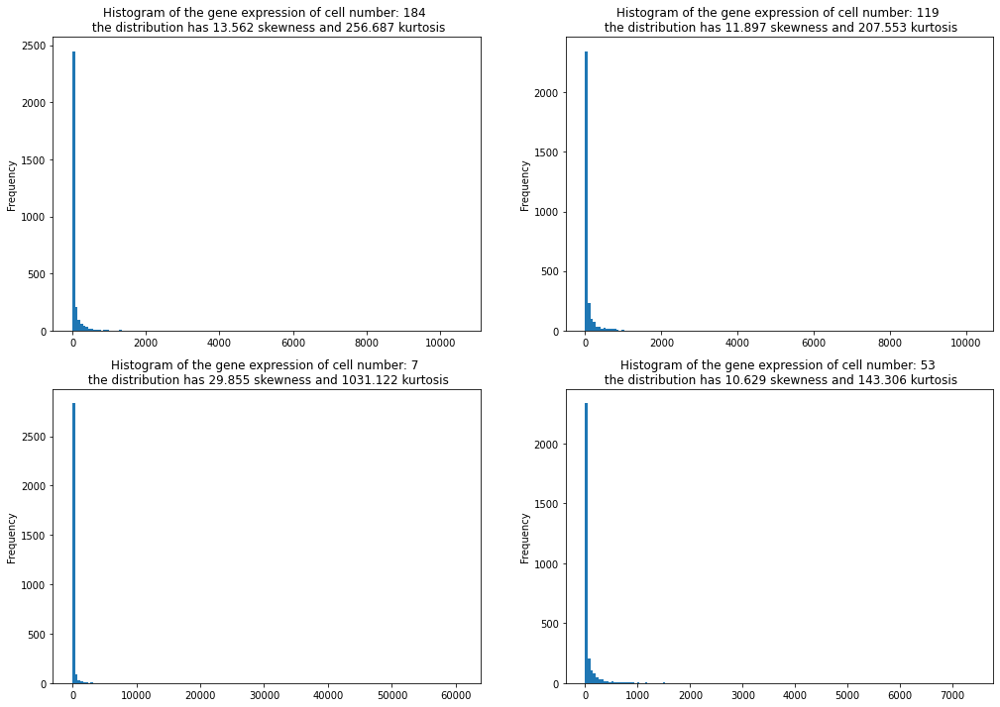

In [ ]:
from scipy.stats import kurtosis, skew

plt.figure(figsize=(20, 17))

first_cell = random.randrange(unfilt.shape[1])
second_cell = random.randrange(unfilt.shape[1])
third_cell = random.randrange(unfilt.shape[1])
fourth_cell = random.randrange(unfilt.shape[1])

plt.figure(figsize=(17, 12))

plt.subplot(2, 2, 1)
plt.hist(unfilt.iloc[:,first_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {first_cell} \n the distribution has {round(skew(unfilt.iloc[:,first_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,first_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 2)
plt.hist(unfilt.iloc[:,second_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {second_cell} \n the distribution has {round(skew(unfilt.iloc[:,second_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,second_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 3)
plt.hist(unfilt.iloc[:,third_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {third_cell} \n the distribution has {round(skew(unfilt.iloc[:,third_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,third_cell]), 3)} kurtosis")
plt.ylabel("Frequency")

plt.subplot(2, 2, 4)
plt.hist(unfilt.iloc[:,fourth_cell], bins=150)
plt.title(f"Histogram of the gene expression of cell number: {fourth_cell} \n the distribution has {round(skew(unfilt.iloc[:,fourth_cell]), 3)} skewness and {round(kurtosis(unfilt.iloc[:,fourth_cell]), 3)} kurtosis")
plt.ylabel("Frequency")



The result is showing is that even if the data are filtered and normalized, the distribution of counts among the cells is the same. 

---

Now that we assessed that there are a lot of zeros in our dataset, we want to see for some genes how is the distributions on non-zero values, to compare it to the one we had in the case of unfiltered and unnormalized data.

Text(0, 0.5, 'Frequency (possibly scaled)')

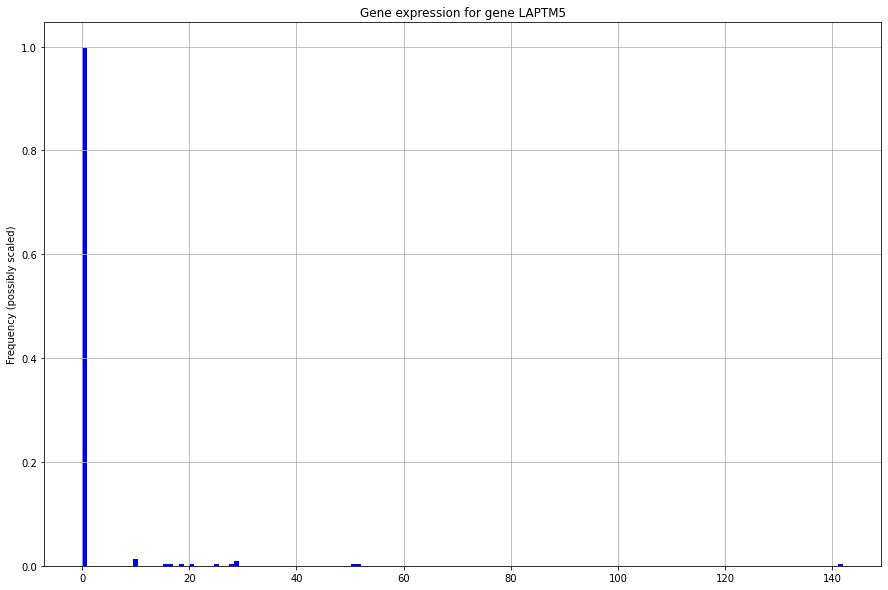

In [ ]:
rdn_gene = random.randrange(unfilt.shape[0])

plt.figure(figsize=(15, 10))
unfilt.iloc[rdn_gene, :].plot.hist(grid=True,
                                      density = True, 
                                      bins=150,
                                      color='blue')

plt.title(f"Gene expression for gene {unfilt.index[rdn_gene]}")
plt.ylabel("Frequency (possibly scaled)")

But we see that the distribution is similar to the one in the unfiltered case

The distribution seems therefore to follow a Poisson/Negative binomial distribution.

--- 
Given what stated above, we further investigate the ralation between mean and variance of the gene expression among cells to see if we would prefer adopting a Negative Binomial ditribution:

Text(0, 0.5, 'Variance')

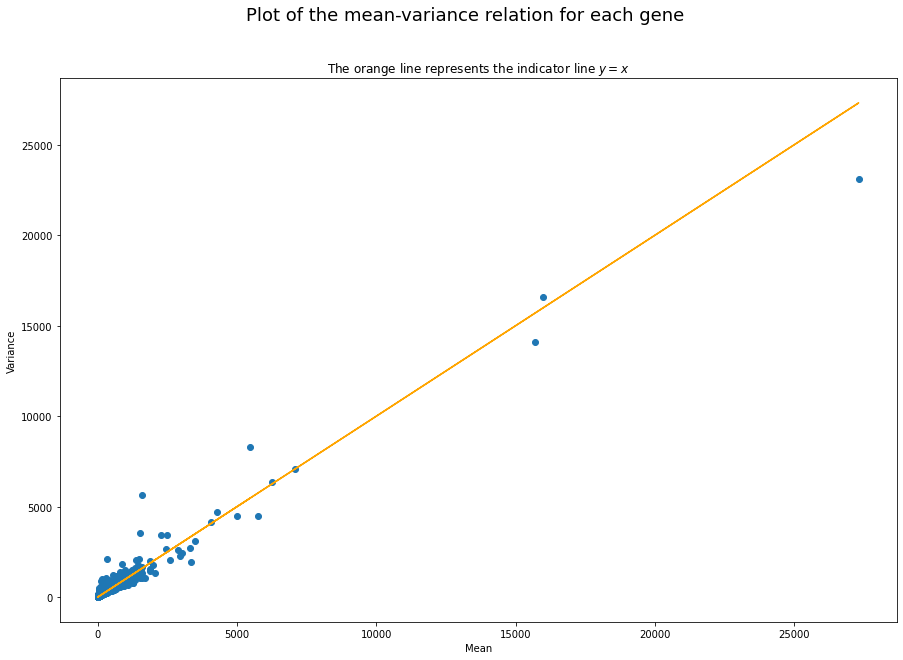

In [ ]:
##################### THIS PLOT COULD TAKE SOME TIME ########################
mean_vector = unfilt.T.describe().iloc[1,:]
var_vector = unfilt.T.describe().iloc[2,:]

plt.figure(figsize=(15, 10))
plt.scatter(mean_vector, var_vector)
plt.plot(mean_vector, mean_vector, color = "orange")
plt.title("The orange line represents the indicator line $y=x$", fontsize = 12)
plt.suptitle("Plot of the mean-variance relation for each gene", fontsize = 18)
plt.xlabel("Mean")
plt.ylabel("Variance")



Here we observe that the mean-variace relation is mantained! The filtering just eliminated some outlier cells!

Loading the meta data and the filtered and normalised dataset of HCC1806 SmartSeq.

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_Filtered_Normalised_3000_Data_train.txt', delimiter = " ", index_col = 0)
print("data frame dimensions :", np.shape(df))
df.head()

data frame dimensions : (3000, 14682)


,AAAAAACCCGGC_Normoxia,AAAACCGGATGC_Normoxia,AAAACGAGCTAG_Normoxia,AAAACTTCCCCG_Normoxia,AAAAGCCTACCC_Normoxia,AAACACAAATCT_Normoxia,AAACCAAGCCCA_Normoxia,AAACCATGCACT_Normoxia,AAACCTCCGGCT_Normoxia,AAACGCCGGTCC_Normoxia,...,TTTTCTGATGGT_Hypoxia,TTTTGATTCAGA_Hypoxia,TTTTGCAACTGA_Hypoxia,TTTTGCCGGGCC_Hypoxia,TTTTGTTAGCCT_Hypoxia,TTTTTACCAATC_Hypoxia,TTTTTCCGTGCA_Hypoxia,TTTTTGCCTGGG_Hypoxia,TTTTTGTAACAG_Hypoxia,TTTTTTTGAATC_Hypoxia
H1-5,2,2,5,1,0,0,0,0,1,0,...,0,1,0,2,1,0,0,0,3,1
MALAT1,3,3,2,3,12,3,1,2,0,0,...,3,1,1,1,4,0,4,1,3,6
MT-RNR2,0,0,0,0,0,0,0,0,0,1,...,1,2,2,2,0,0,1,0,1,0
ARVCF,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BCYRN1,0,1,1,0,0,1,1,2,0,3,...,1,1,0,1,1,0,0,1,0,0


In [ ]:
# t_meta = meta.T
# print(t_meta.shape)
# hypo_ind = (meta["Condition"] == "Hypo")
# hypo_ind = hypo_ind.to_numpy()
# norm_ind = (~(hypo_ind))
# norm_ind.sum()
# hypo_ind

### Dimensionality Reduction

> Throughout this section, we will be applying a Principal Components Analysis for the purpose of analyzing data and dimensionality reduction, as well as other dimensionality reduction techniques and discuss their outcomes.

We start by converting our Pandas DataFrame into a NumPy array.

In [ ]:
data = df.to_numpy()

Then, we extract the indices of hypoxic and normoxic cells and build two lists out of them

In [ ]:
l_hypoxia = get_condition_list(df, "Hypo")
l_normoxia = get_condition_list(df, "Norm")
print(len(l_normoxia))
l_hypoxia[:10], l_normoxia[:10]

5783


([5783, 5784, 5785, 5786, 5787, 5788, 5789, 5790, 5791, 5792],
 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

#### PCA

As we import the PCA function from the SKLearn library, we proceed to apply it to our dataset, requesting a 95% variance expression on the reduced outcome.

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pca = PCA(n_components = 0.95)
data_red = pca.fit_transform(data.T)
pca.n_components_

844

Again, as we might have expected, we observe that we need a high number of components in order to express 95% of the variance, that is 844 components.

In [ ]:
data_red.shape

(14682, 844)

In [ ]:
pca.explained_variance_ratio_[:3]

array([0.08423243, 0.06316067, 0.03883139])

We now plot the results, starting from a 2D scatter plot on the two main principal components.

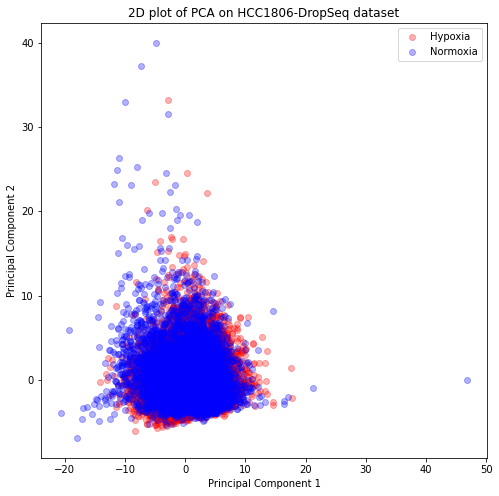

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_title('2D plot of PCA on HCC1806-DropSeq dataset')

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], c="b",alpha = 0.3, label="Normoxia")
ax.legend()
plt.show()

Next, we can again build a scatter plot, 3D this time, as we take into account the third principal component as well.

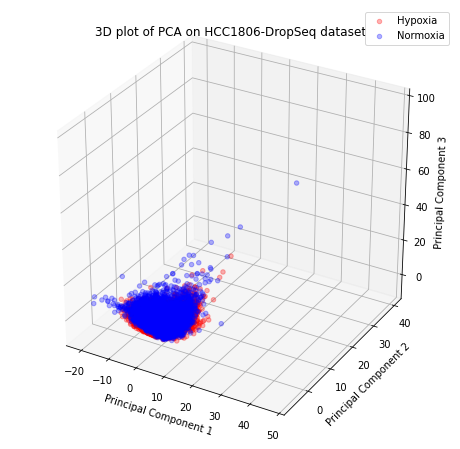

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D plot of PCA on HCC1806-DropSeq dataset')

ax.scatter(data_red[l_hypoxia,0],data_red[l_hypoxia,1], data_red[l_hypoxia,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[l_normoxia,0],data_red[l_normoxia,1], data_red[l_normoxia,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

##### Interactive 3D version
> Might take a few minutes to run

Notice. The following implementation is quite time-consuming when executed on large-sized datasets (since a simpler static version of the 3D plot has been implemented above, we provide the code cell below commented).

In [ ]:
plot_df = pd.DataFrame(data_red[:, 0:3])
plot_df.columns = ["PC1","PC2","PC3"]

aux_lst = []
for name in df.columns.values:
  if 'Hypo' in name:
    aux_lst.append(1)
  elif 'Norm' in name:
    aux_lst.append(0)

plot_df["Color"] = aux_lst
plot_df

,x,y,z,Color
0,-26874.672396,766.013957,-880.248212,0
1,-26354.743000,5039.849020,-5372.826809,0
2,-29351.253485,2414.726753,-3076.254097,0
3,-24813.833293,-75.979072,-3934.877133,0
4,4454.732179,-1836.273354,-1595.912696,1
...,...,...,...,...
245,-18394.340467,-5274.416642,649.525614,0
246,-10023.164045,-14507.616731,-1941.969647,0
247,603.697715,11492.308191,43230.690452,1
248,17016.931253,8398.335833,4439.884803,1


In [ ]:
# !pip install jupyter-dash

import plotly.graph_objects as go
import plotly.express as px
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

fig = px.scatter_3d(
    data_frame = plot_df,
    x = "PC1",
    y = "PC2",
    z = "PC3",
    color = "Color",
    title = "Interactive PCA plot with supervised labels",
)

# build jupyter dash app 
app = JupyterDash(__name__)
# add html components and figure to app
app.layout = html.Div([dcc.Graph(figure=fig)])
# run app inline
app.run_server(mode='inline')

<IPython.core.display.Javascript object>

#### t-SNE


We first import TSNE from the SKLearn library

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

Now, PCA is carried out on the dataframe, and all the data is mapped into a 50-dimensional space.
PCA is performed as a sort of pre-processing stage because t-SNE does not work properly on datasets having too many features (in this case the initial dataset have 3000 features), so we need to reduce the dimensionality to about 50 (a number of features with which t-SNE produces good results).

In [ ]:
pca50 = PCA(n_components=50)
data_fifty = pca50.fit_transform(data.T)
data_fifty.shape

(14682, 50)

In [ ]:
pca50.explained_variance_ratio_[0:4]

array([0.08423243, 0.06316067, 0.03883139, 0.02866254])

We now apply t-SNE on the output of PCA (i.e. the data_fifty reduced dataset).

In [ ]:
embedded = TSNE(n_components=2, learning_rate='auto', init='random').fit_transform(data_fifty)

In [ ]:
embedded.shape

(14682, 2)

We now plot the results.

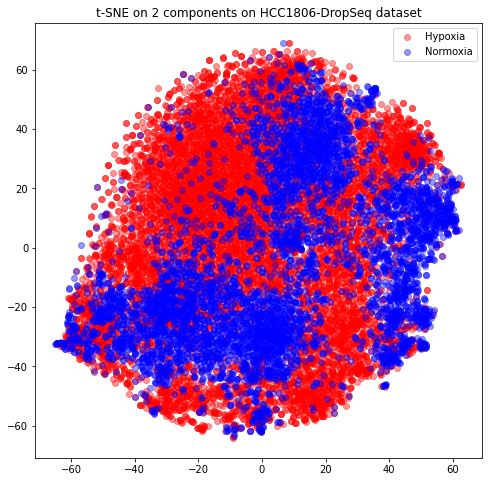

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.scatter(embedded[l_hypoxia,0], embedded[l_hypoxia,1], c="r",alpha = 0.4, label="Hypoxia")
ax.scatter(embedded[l_normoxia,0], embedded[l_normoxia,1], c="b",alpha = 0.4, label="Normoxia")
ax.set_title('t-SNE on 2 components on HCC1806-DropSeq dataset')
ax.legend()

plt.show()

Considering the outcome on the previous dataset, we can assume a similar result also this time. More specifically, the 50-component PCA is a even lower selection compared to the 95%-variance-expressing reduction considering 844 principal components.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


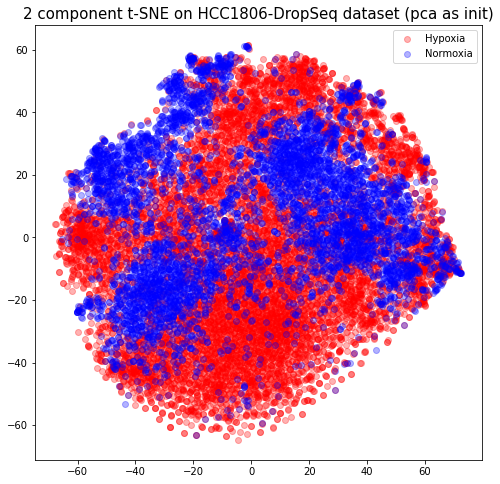

In [ ]:
# This also takes quite a long time to run
embedded2 = TSNE(n_components=2, learning_rate='auto', init='pca').fit_transform(data_fifty)

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.set_title('2 component t-SNE on HCC1806-DropSeq dataset (pca as init)', fontsize = 15)

ax.scatter(embedded2[l_hypoxia,0], embedded2[l_hypoxia,1], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(embedded2[l_normoxia,0], embedded2[l_normoxia,1], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

Indeed, the given output does not share any significant similarities with the plot of the PCA function.

#### UMAP

Let's first install the umap library

In [ ]:
# !pip install umap-learn

     |████████████████████████████████| 88 kB 3.0 MB/s 
     |████████████████████████████████| 1.1 MB 40.7 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=ce75bd95b80eaa7196e8381fc04923b2f808201bc2b92e7c2a20cc713b4ff08c
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.7-py3-none-any.whl size=54286 sha256=f7e687ffcf649d46a44e5827938b3ddca0a60de035d4c051298bef1995aec004
  Stored in directory: /root/.cache/pip/wheels/7f/2a/f8/7bd5dcec71bd5c669f6f574db3113513696b98f3f9b51f496c
Successfully built umap-learn pynndescent


In [ ]:
from umap import UMAP

In [ ]:
reducer = UMAP()

embedding_data = reducer.fit_transform(data.T)
embedding_data.shape

(14682, 2)

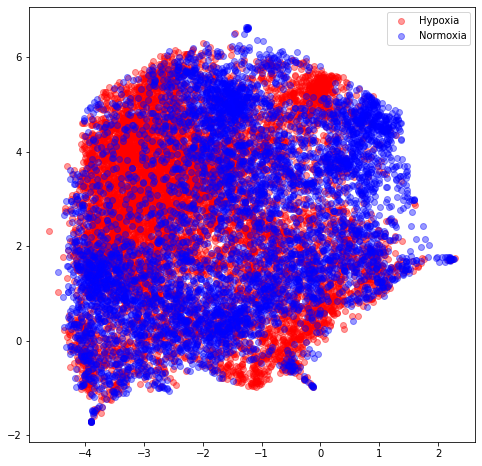

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)

ax.scatter(embedding_data[l_hypoxia, 1], embedding_data[l_hypoxia,0], c="r",alpha = 0.4, label="Hypoxia")
ax.scatter(embedding_data[l_normoxia, 1], embedding_data[l_normoxia,0], c="b",alpha = 0.4, label="Normoxia")
ax.legend()
plt.show()

### Clustering methods on Reduced dataset
> For a matter of computational convenience, we consider the reduced dataset expressing 95% of the variance.

As we may have noticed in the dimensionality reduction section above, the plot visualizing the PCA method shows that the data has a less clear as in the lower-size datasets, while t-SNE still gives us a reasonably clearer visualization. Thus, we will use this latter visualization to plot the comparisons.

#### K-means

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans = KMeans(n_clusters=2, random_state=42)
pred_clus = kmeans.fit_predict(data_red)

In [ ]:
hypo = (pred_clus == 1)
norm = (pred_clus == 0)

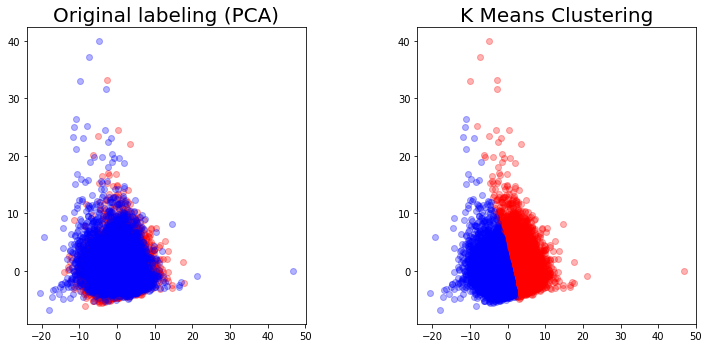

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax.scatter(embedded[l_hypoxia,0],embedded[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(embedded[l_normoxia,0],embedded[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(embedded[hypo,0],embedded[hypo,1], c="r",alpha = 0.3)
ax1.scatter(embedded[norm,0],embedded[norm,1], c="b",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

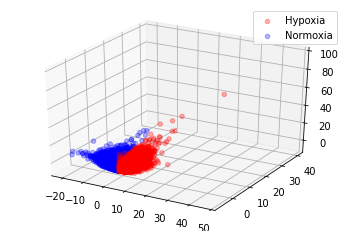

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo,0],data_red[hypo,1], data_red[hypo,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm,0],data_red[norm,1], data_red[norm,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

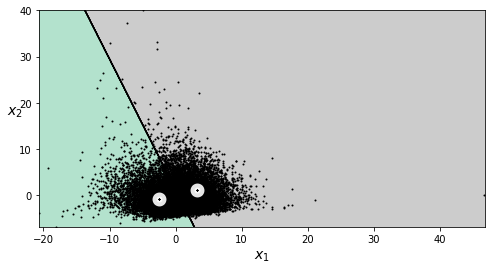

In [ ]:
kmeans.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 4))
plot_decision_boundaries(kmeans, data_red[:, 0:2])
plt.show()

From the plots above, we deduce that also in the case of this large-sized dataset K-means clustering might not produce accurate predictions.

#### Gaussian mixture

In [ ]:
from sklearn.mixture import GaussianMixture

gm = GaussianMixture(n_components=2, random_state=42,
                     covariance_type = "diag")

In [ ]:
pred_mix = gm.fit_predict(data_red)

In [ ]:
hypo_mix = (pred_mix == 1)
norm_mix = (pred_mix == 0)

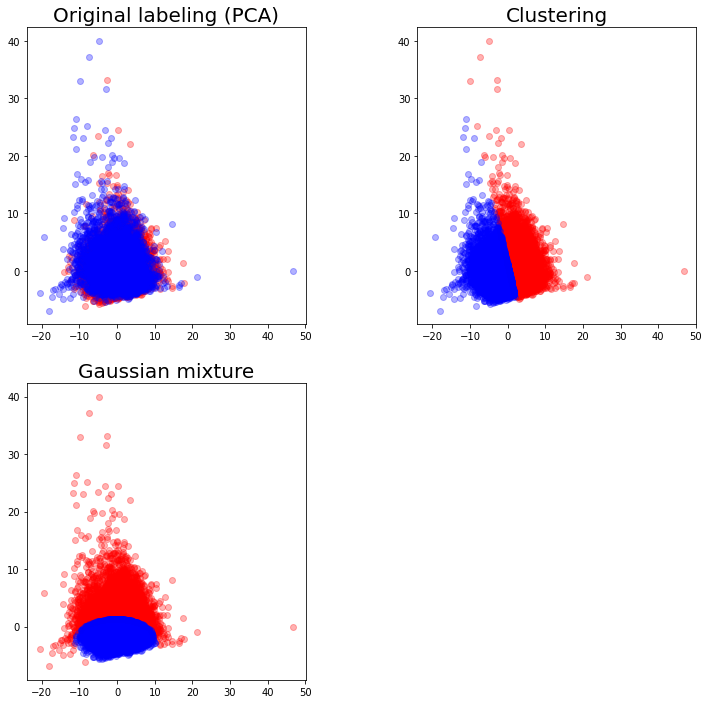

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax2 = fig.add_subplot(2,2,3)
ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax.scatter(embedded[l_hypoxia,0],embedded[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(embedded[l_normoxia,0],embedded[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(embedded[hypo,0],embedded[hypo,1], c="r",alpha = 0.3)
ax1.scatter(embedded[norm,0],embedded[norm,1], c="b",alpha = 0.3)

ax2.scatter(embedded[hypo_mix,0],embedded[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(embedded[norm_mix,0],embedded[norm_mix,1], c="b",alpha = 0.3)


plt.subplots_adjust(wspace=0.4)

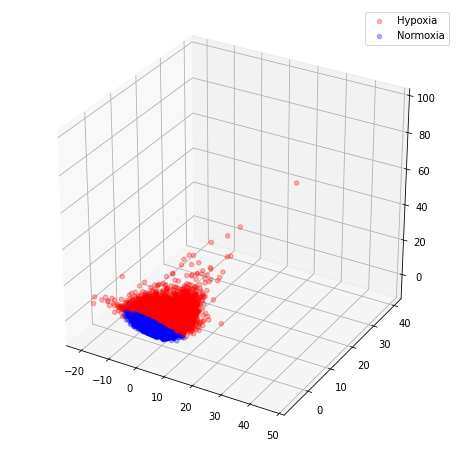

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo_mix,0],data_red[hypo_mix,1], data_red[hypo_mix,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm_mix,0],data_red[norm_mix,1], data_red[norm_mix,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

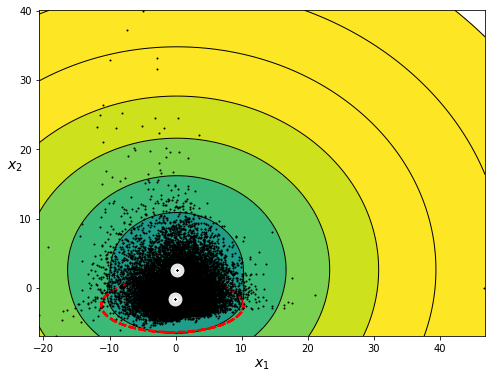

In [ ]:
gm.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 6))
plot_gaussian_mixture(gm, data_red[:, 0:2])
plt.show()

What we said previously for K-means clustering seems to hold with Gaussian Mixture as well. Even though these plots do not represent the hole space of the dataset, it is evident that this method will not yield accurate predictions.

#### Bayesian Gaussian Mixture


Here we try to implement a different yet similar method to Gaussian Mixture. 

The Bayesian Gaussian Mixture is a method which allows you to not know the exact number of clusters in your data, in a sense it is better because by using a prior it understands how many clusters there should be.

In [ ]:
from sklearn.mixture import BayesianGaussianMixture

In [ ]:
bgm = BayesianGaussianMixture(n_components = 2, random_state = 42)
pred_bgm = bgm.fit_predict(data_red)

In [ ]:
hypo_bgm = (pred_bgm == 1)
norm_bgm = (pred_bgm == 0)

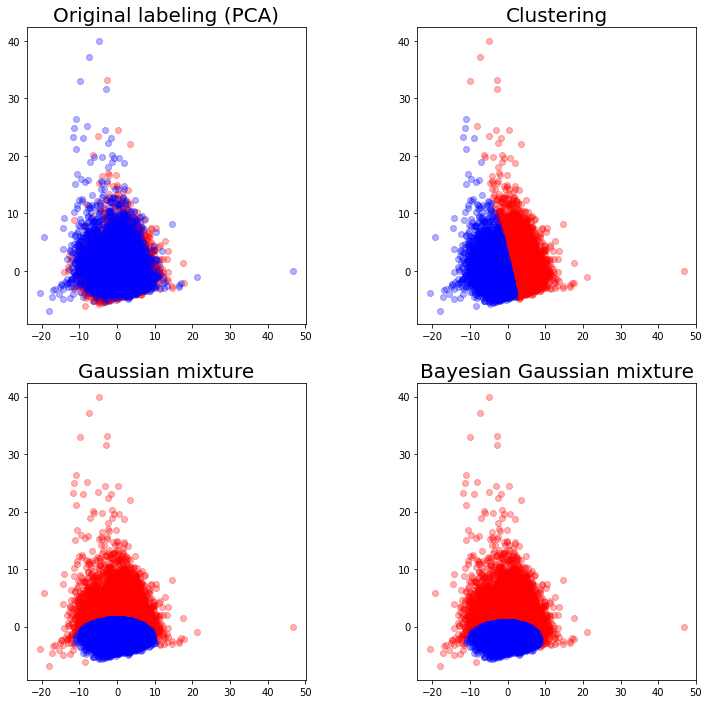

In [ ]:
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(2,2,1)
ax1 = fig.add_subplot(2,2,2)
ax2 = fig.add_subplot(2,2,3)
ax3 = fig.add_subplot(2,2,4)

ax.set_title('Original labeling (PCA)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax3.set_title('Bayesian Gaussian mixture', fontsize = 20)

ax.scatter(embedded[l_hypoxia,0],embedded[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(embedded[l_normoxia,0],embedded[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(embedded[hypo,0],embedded[hypo,1], c="r",alpha = 0.3)
ax1.scatter(embedded[norm,0],embedded[norm,1], c="b",alpha = 0.3)

ax2.scatter(embedded[hypo_mix,0],embedded[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(embedded[norm_mix,0],embedded[norm_mix,1], c="b",alpha = 0.3)

ax3.scatter(embedded[hypo_bgm,0],embedded[hypo_bgm,1], c="r",alpha = 0.3)
ax3.scatter(embedded[norm_bgm,0],embedded[norm_bgm,1], c="b",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

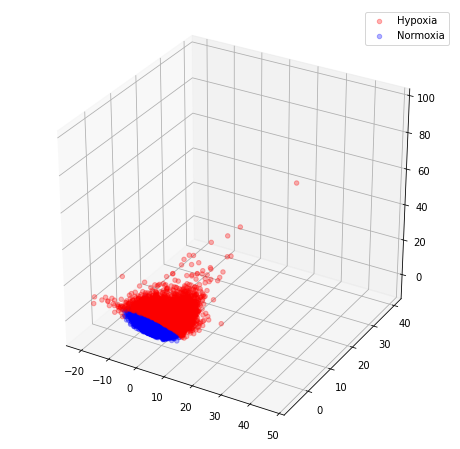

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

ax.scatter(data_red[hypo_bgm,0],data_red[hypo_bgm,1], data_red[hypo_bgm,2], c="r",alpha = 0.3, label="Hypoxia")
ax.scatter(data_red[norm_bgm,0],data_red[norm_bgm,1], data_red[norm_bgm,2], c="b",alpha = 0.3, label="Normoxia")
ax.legend()

plt.show()

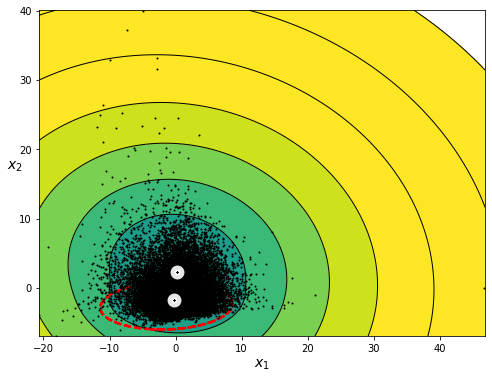

In [ ]:
bgm.fit_predict(data_red[:, 0:2])

plt.figure(figsize=(8, 6))
plot_gaussian_mixture(bgm, data_red[:, 0:2])
plt.show()

Bayesian Gaussian Mixture seems to share a lot of similarities with the plots derived from GM. We could expect very close prediction accuracies between the two methods.

#### Agglomerative Clustering

We are also interested on the behavior and performance of hierarchical clustering methods. 
In agglomerative algorithms, each item starts in its own cluster, then, objects are recursively clustered by similarity, i.e. the distances between groups, two items at a time. Eventually, all items will be grouped in one cluster.
We choose to implement Agglomerative Clustering, as it is the most commonly used technique of this kind.

In [ ]:
from sklearn.cluster import AgglomerativeClustering

In [ ]:
aggl = AgglomerativeClustering(n_clusters=2, linkage='ward')

In [ ]:
pred_aggl = aggl.fit_predict(data_red)

In [ ]:
hypo_aggl = (pred_aggl == 1)
norm_aggl = (pred_aggl == 0)

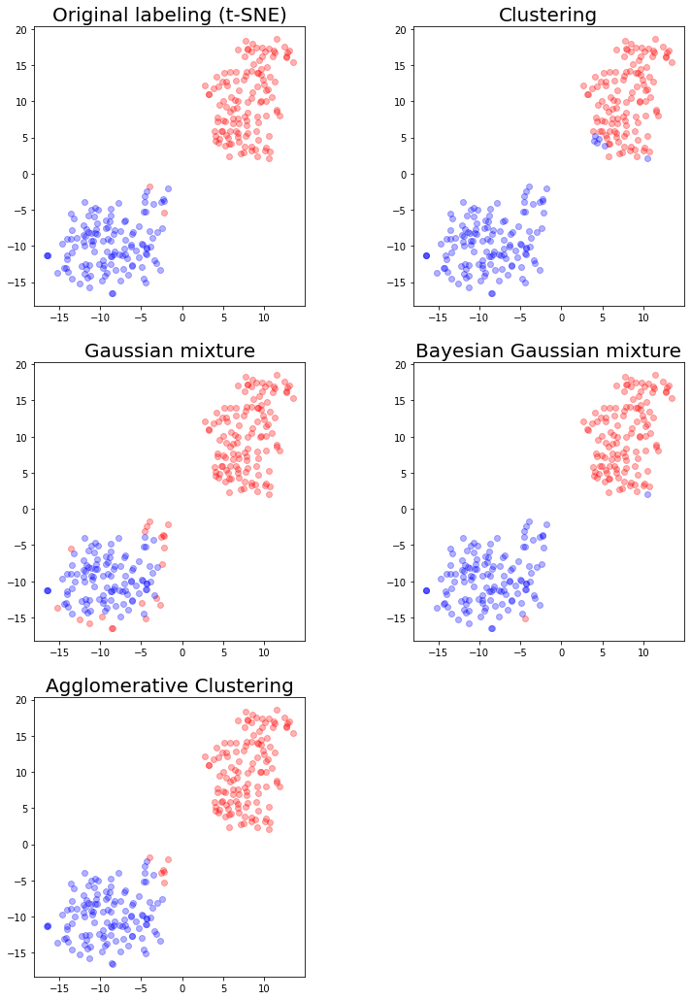

In [ ]:
fig = plt.figure(figsize = (12,18))
ax = fig.add_subplot(3,2,1)
ax1 = fig.add_subplot(3,2,2)
ax2 = fig.add_subplot(3,2,3)
ax3 = fig.add_subplot(3,2,4)
ax4 = fig.add_subplot(3,2,5)

ax.set_title('Original labeling (t-SNE)', fontsize = 20)

ax1.set_title('K-Means Clustering', fontsize = 20)

ax2.set_title('Gaussian mixture', fontsize = 20)

ax3.set_title('Bayesian Gaussian mixture', fontsize = 20)

ax4.set_title('Agglomerative Clustering', fontsize = 20)

ax.scatter(embedded[l_hypoxia,0],embedded[l_hypoxia,1], c="r",alpha = 0.3)
ax.scatter(embedded[l_normoxia,0],embedded[l_normoxia,1], c="b",alpha = 0.3)

ax1.scatter(embedded[hypo,0],embedded[hypo,1], c="r",alpha = 0.3)
ax1.scatter(embedded[norm,0],embedded[norm,1], c="b",alpha = 0.3)

ax2.scatter(embedded[hypo_mix,0],embedded[hypo_mix,1], c="r",alpha = 0.3)
ax2.scatter(embedded[norm_mix,0],embedded[norm_mix,1], c="b",alpha = 0.3)

ax3.scatter(embedded[hypo_bgm,0],embedded[hypo_bgm,1], c="r",alpha = 0.3)
ax3.scatter(embedded[norm_bgm,0],embedded[norm_bgm,1], c="b",alpha = 0.3)

ax4.scatter(embedded[hypo_aggl,0],embedded[hypo_aggl,1], c="b",alpha = 0.3)
ax4.scatter(embedded[norm_aggl,0],embedded[norm_aggl,1], c="r",alpha = 0.3)

plt.subplots_adjust(wspace=0.4)

This clustering method can be easily visualized in 2D plots known as dendograms, in which the clusters at each step of the algorithm can be clearly displayed. With the following cell, we will try to implement dendograms for each linkage method available for AgglomerativeClustering.

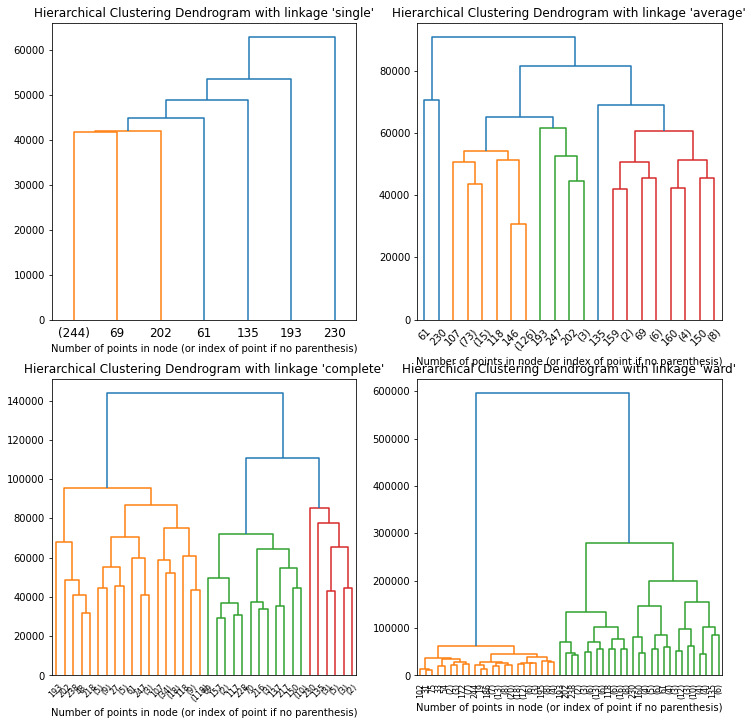

In [ ]:
# setting distance_threshold=0 ensures we compute the full tree.
l_linkage = ['single', 'average', 'complete', 'ward']

fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12,12))

for n, linkage in enumerate(l_linkage):
    model = AgglomerativeClustering(distance_threshold=0, n_clusters=None, linkage=linkage)
    model = model.fit(data.T)

    ax = plt.subplot(2, 2, n + 1)
    # plot the top five levels of the dendrogram
    plot_dendrogram(model, truncate_mode="level", p=5)
    ax.set_title("Hierarchical Clustering Dendrogram with linkage " + "'" + linkage + "'")
    ax.set_xlabel("Number of points in node (or index of point if no parenthesis)")

plt.show()

The assumption we make is the same as the ones we made above, that is hierarchical clustering methods are not the most suitable for this type of datasets.

#### Evaluating Clustering methods 

We will now look at how the various clusterings perform in understanding whether a cell is an Hypoxia one or not.

We will do it over the normal data, i.e. 'df' transposed, that is data.T

In [ ]:
y = []
for i in range(len(l_hypoxia) + len(l_normoxia)):
  if i in l_hypoxia:
    y.append(1)
  elif i in l_normoxia:
    y.append(0)

##### K Means Clustering

In [ ]:
y_pred_clus = kmeans.fit_predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_clus==y))
print("fraction of correct predictions", np.sum(y_pred_clus==y) / len(y_pred_clus))

correct predictions:  8626
fraction of correct predictions 0.5875221359487808


##### Gaussian Mixture

In [ ]:
gm.fit(data.T)
y_pred_mix = gm.predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_mix==y))
print("fraction of correct predictions", np.sum(y_pred_mix==y) / len(y_pred_mix))

correct predictions:  6305
fraction of correct predictions 0.429437406347909


##### Bayesian Gaussian Mixture

In [ ]:
bgm.fit(data.T)
y_pred_bgm = bgm.predict(data.T)

In [ ]:
print("correct predictions: ", np.sum(y_pred_bgm==y))
print("fraction of correct predictions", np.sum(y_pred_bgm==y) / len(y_pred_bgm))

correct predictions:  5853
fraction of correct predictions 0.3986514098896608


By observing these results, we can conclude that, once more, all clustering methods implemented above perform rather poorly on this larger dataset. More specifically, GM and BGM indeed have a comparable degree of accuracy (both seriously insufficient), while, K-Means gets the highest prediction accuracy among the three methods.

###Classifiers

#### Preprocessing: PCA reduction for hyperparameters tuning

As before, we will perform a PCA reduction in order to get a lower dimensional dataset on which to run Grid Search (as it is very time-consuming) and we'll obtain the best-performing hperparameters of the model on the reduced dataset. After that, we will run the model on the original dataset, with the same hyperparameters.
In this section we will also use the function train_test_split() to create a training and a test set on which to fit and predict all the classifiers for this section (i.e., DropSeq HCC).

In [ ]:
from sklearn.decomposition import PCA

#HCC_drop_T stands for HCC DropSeq transposed
HCC_drop_T = df.T
X = HCC_drop_T.to_numpy()
pca = PCA(n_components=100)
X_red = pca.fit_transform(X)

In [ ]:
X_red.shape

(14682, 100)

In [ ]:
sum(pca.explained_variance_ratio_)

0.686441536998241

In [ ]:
condition = []
for i in list(HCC_drop_T.index):
  if "Normoxia" in i:
    condition.append(0)
  if "Hypoxia" in i:
    condition.append(1)
HCC_drop_T["Condition"] = condition

y = np.array(condition)

X_train_red, X_test_red, y_train_red, y_test_red = train_test_split(X_red, y, test_size=0.33, random_state = 42)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state = 42)

In [ ]:
(X_train_red.shape, X_test_red.shape, X_train.shape, X_test.shape)

((9836, 100), (4846, 100), (9836, 3000), (4846, 3000))

#### Random Forest

In [ ]:
from sklearn.model_selection import GridSearchCV
from  sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(criterion = "gini", random_state=42)

p_grid = {'n_estimators': [200, 400]}
          
gs = GridSearchCV(rfc, param_grid = p_grid).fit(X_train_red, y_train_red)
gs.best_params_

{'n_estimators': 200}

In [ ]:
rfc = RandomForestClassifier(n_estimators = gs.best_params_["n_estimators"], 
                             min_samples_leaf = 1, 
                             min_samples_split = 2,
                             criterion="gini", random_state = 42)

rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)
accuracy_score(y_pred, y_test)

0.9314898885678911

##### Analysing relationship between Principal Components and accuracy

In [ ]:
df_train_HCC = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/DropSeq/HCC1806_Filtered_Normalised_3000_Data_train.txt", sep=" ")

In [ ]:
namesH = df_train_HCC.columns.values
df_train_HCC_t = df_train_HCC.T
df_train_HCC_t["Classification"] = [i for i in range(len(namesH))]


for i in range(len(namesH)):
    if "Hypo" in namesH[i]:
        df_train_HCC_t["Classification"][i] = 1
    else:
        df_train_HCC_t["Classification"][i] = 0

l = list(df_train_HCC_t["Classification"])

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from  sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score

acc_list = []
dim_list = [i for i in range(1, 20)]
for i in range(1, 20):

  #PCA
  X = df_train_HCC.to_numpy()
  X_t = np.transpose(X)
  pca = PCA(n_components = i)
  Xred = pca.fit_transform(X_t)
  df_red = pd.DataFrame(Xred)
  
  #Creating the classification framework 
  df_red["Classification"] = l

  
  X = df_red.iloc[:,:-1]
  y = df_red["Classification"]
  
  
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state = 42)
  
  #Fitting the random forest
  rfc = RandomForestClassifier(n_estimators = 400, 
                               min_samples_leaf = 1, 
                               min_samples_split = 2,
                               criterion="gini", random_state = 42)

  rfc.fit(X_train, y_train)
  y_pred = rfc.predict(X_test)
  acc_list.append(accuracy_score(y_pred, y_test))

<BarContainer object of 19 artists>

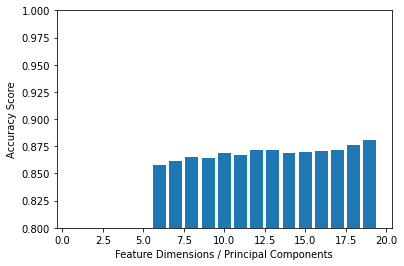

In [ ]:
#plotting the accuracy scores

plt.xlabel("Feature Dimensions / Principal Components")
plt.ylabel("Accuracy Score")
plt.ylim([0.80, 1])

plt.bar(dim_list, acc_list)

#### Gradient Boosting

In [ ]:
(X_train_red.shape, X_test_red.shape, X_train.shape, X_test.shape)

((9836, 100), (4846, 100), (9836, 3000), (4846, 3000))

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

gb_clf = GradientBoostingClassifier(random_state = 42)

p_grid = {'max_features' : [10, 25], 
          'max_leaf_nodes' : [16],
          'n_estimators' : [150, 400]}

gs = GridSearchCV(gb_clf, param_grid = p_grid).fit(X_train_red, y_train_red)
gs.best_params_

{'max_features': 25, 'max_leaf_nodes': 16, 'n_estimators': 400}

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

gb_clf = GradientBoostingClassifier(learning_rate = 0.1,
                                    max_features = gs.best_params_['max_features'],
                                    max_leaf_nodes = gs.best_params_['max_leaf_nodes'],
                                    n_estimators = gs.best_params_['n_estimators'])

gb_clf.fit(X_train, y_train)
y_pred = gb_clf.predict(X_test)
accuracy_score(y_pred, y_test)

0.9570780024762691

#### SVM

In [ ]:
(X_train_red.shape, X_test_red.shape, X_train.shape, X_test.shape)

((14489, 34), (7137, 34), (14489, 3000), (7137, 3000))

In [ ]:
from sklearn.svm import SVC

svc = SVC()
parameters = {'kernel':('linear', 'rbf'), 'C':[1, 10]}

clf = GridSearchCV(svc, parameters).fit(X_train_red, y_train_red)
print(clf.best_params_)
clf.best_params

In [ ]:
svc = SVC(C=clf.best_params_["C"],
          kernel=clf.best_params_["kernel"])

svc.fit(X_train, y_train)
y_pred = svc.predict(X_test)
accuracy_score(y_pred, y_test)

0.9812246041754239

#### Neural Network

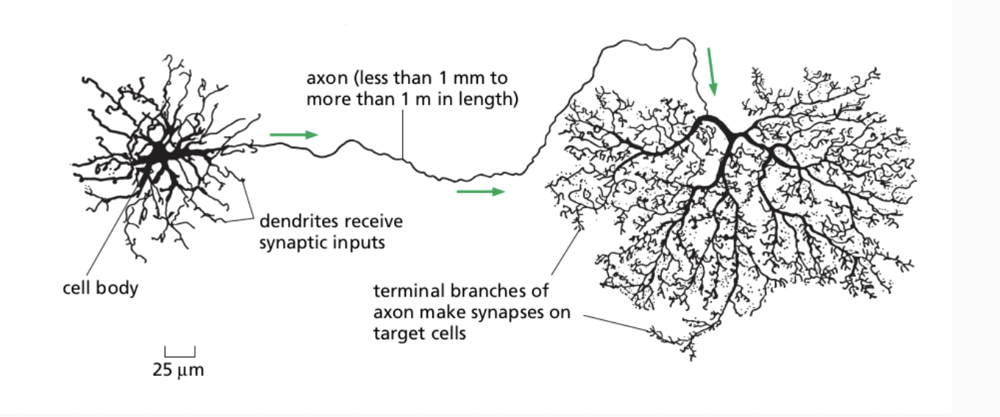How does a Neural Network works actually? 



The Neural Network is built upon the simplest model we have of the neuron: the perceptron. 

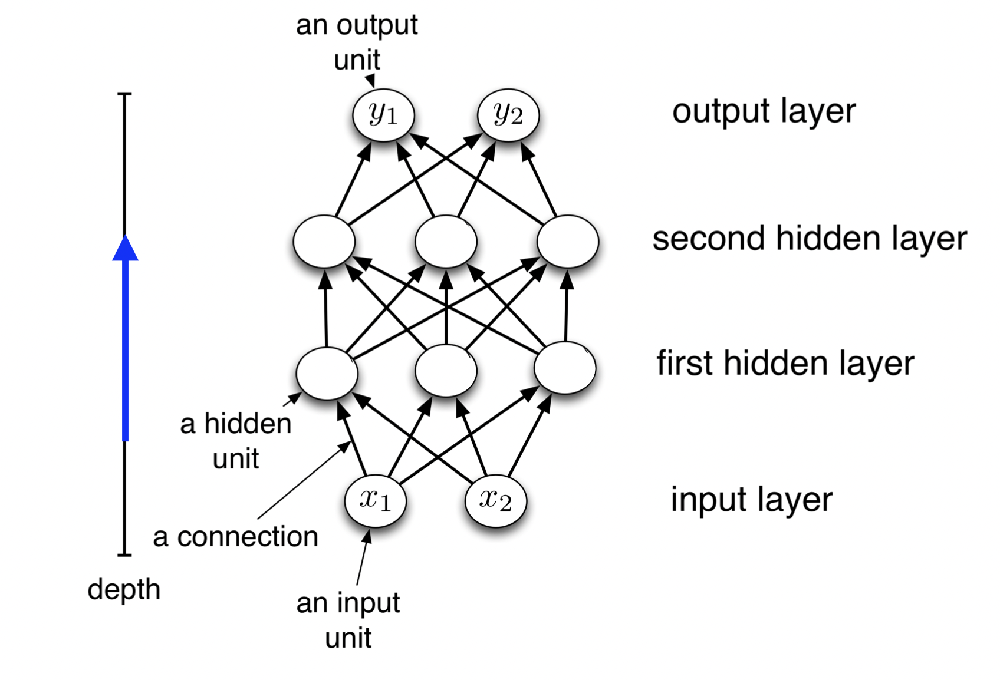

Each neuron presents its personal activation function that determines the output, but in practice you use in all the neurons from the same layer the same activation function. The most common and used one is the ReLu

We have basically four steps we have to perform 4 steps. 

1. Obtain your training data $({{x_i,y_i}})$
2. Choose your decision function and your loss function   $  \mathcal{L}(\hat{y}, y_i)$ \\
3. Define your goal $y^\ast = arg\min \sum_{i} \mathcal{L}(f_\theta(x_i), y_i) $
4. Train with SGD taking small steps in the direction of opposite gradient $\theta^{t+1} = \theta^t -\eta*\nabla(\mathcal{L}(\hat{y}, y_i)$

In [ ]:
df_train_HCC = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_Filtered_Normalised_3000_Data_train.txt", sep=" ")

In [ ]:
namesH = df_train_HCC.columns.values

In [ ]:
df_train_HCC_t = df_train_HCC.T
df_train_HCC_t["Classification"] = [i for i in range(len(namesH))]

for i in range(len(namesH)):
    if "Hypo" in namesH[i]:
        df_train_HCC_t["Classification"][i] = 1
    else:
        df_train_HCC_t["Classification"][i] = 0

In [ ]:
from sklearn.model_selection import train_test_split

X = df_train_HCC_t.iloc[:,:-1]
y = df_train_HCC_t["Classification"]


X_train, X_test, Y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 22)

In [ ]:
x_valid, x_train = X_train[:1700], X_train[1700:]
y_valid, y_train = Y_train[:1700], Y_train[1700:]

In [ ]:
model = Sequential()

In [ ]:

model.add(Dense(units=64, input_shape= (3000,)))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 1))

In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer=keras.optimizers.SGD(learning_rate=0.00001, momentum = 0.2),
              metrics=['accuracy'])

In [ ]:
hist=model.fit(x = x_train, y = y_train, epochs=10, validation_data = (x_valid,y_valid))

Epoch 1/10
269/269 [==============================] - 3s 10ms/step - loss: 0.0038 - accuracy: 0.9998 - val_loss: 0.1715 - val_accuracy: 0.9594
Epoch 2/10
269/269 [==============================] - 2s 9ms/step - loss: 0.0038 - accuracy: 0.9998 - val_loss: 0.1715 - val_accuracy: 0.9594
Epoch 3/10
269/269 [==============================] - 2s 8ms/step - loss: 0.0038 - accuracy: 0.9998 - val_loss: 0.1715 - val_accuracy: 0.9594
Epoch 4/10
269/269 [==============================] - 2s 8ms/step - loss: 0.0038 - accuracy: 0.9998 - val_loss: 0.1715 - val_accuracy: 0.9594
Epoch 5/10
269/269 [==============================] - 2s 8ms/step - loss: 0.0038 - accuracy: 0.9998 - val_loss: 0.1715 - val_accuracy: 0.9594
Epoch 6/10
269/269 [==============================] - 2s 9ms/step - loss: 0.0038 - accuracy: 0.9998 - val_loss: 0.1715 - val_accuracy: 0.9594
Epoch 7/10
269/269 [==============================] - 2s 9ms/step - loss: 0.0037 - accuracy: 0.9998 - val_loss: 0.1715 - val_accuracy: 0.9594
Epoch

In [ ]:
model.evaluate(X_test, y_test)

138/138 [==============================] - 1s 9ms/step - loss: 0.1640 - accuracy: 0.9580


[0.16395537555217743, 0.9580022692680359]

We obtained a 95,8% accuracy for HCC1806 in DropSeq

#### Let's tune the parameters for our neural network on HCC1806

In [ ]:
import tensorflow as tf
import keras
from keras import layers
from keras import models
from keras import utils
from keras.layers import Dense
from keras.models import Sequential
from keras.layers import Flatten
from keras.layers import Dropout
from keras.layers import Activation
from keras.regularizers import l2


from keras.callbacks import LearningRateScheduler
from keras.callbacks import History

from keras import losses
from sklearn.utils import shuffle



print(tf.keras.__version__)

2.8.0


Import the dataset 

In [ ]:
df_train_HCC = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/AILAB/HCC1806_Filtered_Normalised_3000_Data_train.txt", sep=" ")

In [ ]:
namesH = df_train_HCC.columns.values

In [ ]:
df_train_HCC_t = df_train_HCC.T
df_train_HCC_t["Classification"] = [i for i in range(len(namesH))]

for i in range(len(namesH)):
    if "Hypo" in namesH[i]:
        df_train_HCC_t["Classification"][i] = 1
    else:
        df_train_HCC_t["Classification"][i] = 0

In [ ]:
from sklearn.model_selection import train_test_split

X = df_train_HCC_t.iloc[:,:-1]
y = df_train_HCC_t["Classification"]


X_train, X_test, Y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42)

In [ ]:
x_valid, x_train = X_train[:1000], X_train[1000:]
y_valid, y_train = Y_train[:1000], Y_train[1000:]

In [ ]:
model = Sequential()
model.add(Dense(units=512, activation= "relu", input_shape= (3000,)))
model.add(Dense(units= 256, activation= "relu"))
model.add(Dense(units= 128, activation= "relu"))  
model.add(Dense(1, kernel_initializer='normal', activation='sigmoid'))  
	# Compile model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
  

In [ ]:

from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
import numpy
 
# Function to create model, required for KerasClassifier
def create_model():
	# create model
  model = Sequential()
  model.add(Dense(units=512, activation= "relu", input_shape= (3000,)))
  model.add(Dense(units= 256, activation= "relu"))
  model.add(Dense(units= 256, activation= "relu"))
  model.add(Dense(units= 256, activation= "relu"))
  model.add(Dense(units= 256, activation= "relu"))
  model.add(Dense(units= 128, activation= "relu"))  
  model.add(Dense(units= 128, activation= "relu"))
  model.add(Dense(1))  
	# Compile model
  model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
  return model
 
# fix random seed for reproducibility
seed = 7
numpy.random.seed(seed)
# load pima indians dataset

model = KerasClassifier(build_fn=create_model, epochs=8, batch_size=1000, verbose=1)
# evaluate using 10-fold cross validation
kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=seed)
results = cross_val_predict(model, X, y, cv=kfold)
print(results.mean())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.


Epoch 1/8
14/14 [==============================] - 3s 165ms/step - loss: 1.7769 - accuracy: 0.5780
Epoch 2/8
14/14 [==============================] - 2s 165ms/step - loss: 0.4211 - accuracy: 0.8239
Epoch 3/8
14/14 [==============================] - 2s 164ms/step - loss: 0.2004 - accuracy: 0.9491
Epoch 4/8
14/14 [==============================] - 2s 164ms/step - loss: 0.1021 - accuracy: 0.9761
Epoch 5/8
14/14 [==============================] - 2s 164ms/step - loss: 0.0818 - accuracy: 0.9818
Epoch 6/8
14/14 [==============================] - 2s 165ms/step - loss: 0.0538 - accuracy: 0.9903
Epoch 7/8
14/14 [==============================] - 2s 167ms/step - loss: 0.0384 - accuracy: 0.9957
Epoch 8/8
14/14 [==============================] - 2s 167ms/step - loss: 0.0338 - accuracy: 0.9976
Epoch 1/8
14/14 [==============================] - 3s 163ms/step - loss: 1.6117 - accuracy: 0.5464
Epoch 2/8
14/14 [==============================] - 2s 167ms/step - loss: 0.3596 - accuracy: 0.8659
Epoch 3/8


We perform a similar model as before, but now here we check how it generalizes with Stratified K-fold. The results are pretty satisfying

In [ ]:
model.fit(X_train, Y_train, epochs = 10)

Epoch 1/10
11/11 [==============================] - 3s 167ms/step - loss: 1.5109 - accuracy: 0.5836
Epoch 2/10
11/11 [==============================] - 2s 173ms/step - loss: 0.4243 - accuracy: 0.8263
Epoch 3/10
11/11 [==============================] - 2s 170ms/step - loss: 0.1637 - accuracy: 0.9538
Epoch 4/10
11/11 [==============================] - 2s 165ms/step - loss: 0.1220 - accuracy: 0.9760
Epoch 5/10
11/11 [==============================] - 2s 163ms/step - loss: 0.0670 - accuracy: 0.9911
Epoch 6/10
11/11 [==============================] - 2s 166ms/step - loss: 0.0492 - accuracy: 0.9954
Epoch 7/10
11/11 [==============================] - 2s 169ms/step - loss: 0.0400 - accuracy: 0.9971
Epoch 8/10
11/11 [==============================] - 2s 173ms/step - loss: 0.0357 - accuracy: 0.9976
Epoch 9/10
11/11 [==============================] - 2s 166ms/step - loss: 0.0349 - accuracy: 0.9977
Epoch 10/10
11/11 [==============================] - 2s 164ms/step - loss: 0.0345 - accuracy: 0.9978

In [ ]:
lol = model.predict(X_test)

In [ ]:
sklearn.metrics.accuracy_score(y_test, lol)

0.9539160045402951

Also here we obtained an approximate accuracy of 95%

We try now also a different approach: we define a customize learning rate for our optimizer

In [ ]:
epochs = 30
learning_rate = 0.1 # initial learning rate
decay_rate = 0.1
momentum = 0.8

In [ ]:
model = Sequential()

In [ ]:

model.add(Dense(units=64, input_shape= (3000,)))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 256, activation= 'relu'))
model.add(Dense(units= 1))

In [ ]:
sgd = tf.keras.optimizers.SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


In [ ]:
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer= sgd,
              metrics=['accuracy']) 

In [ ]:
# define the learning rate change 
def exp_decay(epoch):
    lrate = learning_rate * np.exp(-decay_rate*epoch)
    return lrate

In [ ]:
loss_history = tf.keras.callbacks.History()
lr_rate = tf.keras.callbacks.LearningRateScheduler(exp_decay)
callbacks_list = [loss_history, lr_rate]

In [ ]:
hist=model.fit(x = x_train, y = y_train, epochs= epochs,callbacks = callbacks_list, batch_size = 1000,
               verbose = 1, validation_data = (x_valid,y_valid))

Epoch 1/30
10/10 [==============================] - 1s 80ms/step - loss: 0.1267 - accuracy: 0.9487 - val_loss: 0.1289 - val_accuracy: 0.9520 - lr: 0.1000
Epoch 2/30
10/10 [==============================] - 1s 74ms/step - loss: 0.1252 - accuracy: 0.9485 - val_loss: 0.1270 - val_accuracy: 0.9510 - lr: 0.0905
Epoch 3/30
10/10 [==============================] - 1s 74ms/step - loss: 0.1239 - accuracy: 0.9508 - val_loss: 0.1280 - val_accuracy: 0.9540 - lr: 0.0819
Epoch 4/30
10/10 [==============================] - 1s 73ms/step - loss: 0.1225 - accuracy: 0.9519 - val_loss: 0.1235 - val_accuracy: 0.9540 - lr: 0.0741
Epoch 5/30
10/10 [==============================] - 1s 75ms/step - loss: 0.1208 - accuracy: 0.9502 - val_loss: 0.1254 - val_accuracy: 0.9520 - lr: 0.0670
Epoch 6/30
10/10 [==============================] - 1s 73ms/step - loss: 0.1198 - accuracy: 0.9512 - val_loss: 0.1254 - val_accuracy: 0.9510 - lr: 0.0607
Epoch 7/30
10/10 [==============================] - 1s 73ms/step - loss: 0.1

In [ ]:
model.evaluate(X_test, y_test)

138/138 [==============================] - 1s 4ms/step - loss: 0.1325 - accuracy: 0.9421


[0.13247399032115936, 0.9421112537384033]

Beside this was done for improving our performance, we actually got a little less of accuracy

Instead, we know try to optimize a discrete number of parameters with GridSearch

In [ ]:
import numpy
from sklearn.model_selection import GridSearchCV
from keras.wrappers.scikit_learn import KerasClassifier

In [ ]:
def create_model_2(optimizer, init='glorot_uniform'):
     # define model
  model = Sequential()
  model.add(Dense(units=64, input_shape= (3000,)))
  model.add(Dense(units= 256,kernel_initializer=init, activation= 'relu'))
  model.add(Dense(units= 256, kernel_initializer=init, activation= 'relu'))
  model.add(Dense(units= 256,kernel_initializer=init, activation= 'relu'))
  model.add(Dense(units= 256, kernel_initializer=init,activation= 'relu'))
  model.add(Dense(units= 256, kernel_initializer=init,activation= 'relu'))
  model.add(Dense(units= 1))  
    # compile model
  model.compile(loss =tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer= optimizer,
              metrics=['accuracy'])
  return model

In [ ]:
%%time
# fix random seed for reproducibility (this might work or might not work 
# depending on each library's implenentation)
seed = 7
numpy.random.seed(seed)

# create the sklearn model for the network
model_init_batch_epoch_CV = KerasClassifier(build_fn=create_model_2, verbose=1)

# we choose the initializers that came at the top in our previous cross-validation!!
epochs = [10,20]
batches = [1000,1100,1200,1300,1400]
optimizer = ["SGD", 'AdaGrad', 'Adam']

# grid search for initializer, batch size and number of epochs
param_grid = dict(epochs = epochs, optimizer=optimizer, batch_size=batches)
grid = GridSearchCV(estimator=model_init_batch_epoch_CV, 
                    param_grid=param_grid,
                    cv=3)
grid_result = grid.fit(x_train, y_train)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  import sys


Epoch 1/10
7/7 [==============================] - 1s 67ms/step - loss: 0.6924 - accuracy: 0.3887
Epoch 2/10
7/7 [==============================] - 0s 67ms/step - loss: 0.6884 - accuracy: 0.3887
Epoch 3/10
7/7 [==============================] - 0s 66ms/step - loss: 0.6847 - accuracy: 0.3887
Epoch 4/10
7/7 [==============================] - 0s 70ms/step - loss: 0.6814 - accuracy: 0.3887
Epoch 5/10
7/7 [==============================] - 0s 69ms/step - loss: 0.6784 - accuracy: 0.3887
Epoch 6/10
7/7 [==============================] - 0s 68ms/step - loss: 0.6757 - accuracy: 0.3887
Epoch 7/10
7/7 [==============================] - 0s 71ms/step - loss: 0.6731 - accuracy: 0.3887
Epoch 8/10
7/7 [==============================] - 1s 72ms/step - loss: 0.6706 - accuracy: 0.3886
Epoch 9/10
7/7 [==============================] - 0s 67ms/step - loss: 0.6684 - accuracy: 0.3886
Epoch 10/10
4/4 [==============================] - 0s 21ms/step - loss: 0.6688 - accuracy: 0.4045
Epoch 1/10
7/7 [=============

In [ ]:
grid.best_params_

{'batch_size': 1300, 'epochs': 10, 'optimizer': 'Adam'}

We see that our best paramters are 1300 batches, 10 epochs and using an Adam optimizer

In [ ]:
'''# print results
print(f'Best Accuracy for {grid_result.best_score_:.4} using {grid_result.best_params_}')
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print(f'mean={mean:.4}, std={stdev:.4} using {param}')
    '''''

In [ ]:
model = Sequential()
model.add(Dense(units=64, input_shape= (3000,)))
model.add(Dense(units= 256,kernel_initializer='glorot_uniform', activation= 'relu'))
model.add(Dense(units= 256, kernel_initializer='glorot_uniform',activation= 'relu'))
model.add(Dense(units= 1))  
    # compile model
model.compile(loss =tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer= 'Adam',
              metrics=['accuracy'])

In [ ]:

hist=model.fit(x = X_train, y = Y_train, epochs= 10,batch_size=1300, 
                validation_data = (X_test,y_test))

Epoch 1/10
8/8 [==============================] - 4s 236ms/step - loss: 0.5481 - accuracy: 0.7293 - val_loss: 0.3250 - val_accuracy: 0.9017
Epoch 2/10
8/8 [==============================] - 1s 158ms/step - loss: 0.2012 - accuracy: 0.9236 - val_loss: 0.1472 - val_accuracy: 0.9353
Epoch 3/10
8/8 [==============================] - 1s 162ms/step - loss: 0.1036 - accuracy: 0.9598 - val_loss: 0.1272 - val_accuracy: 0.9562
Epoch 4/10
8/8 [==============================] - 1s 166ms/step - loss: 0.0625 - accuracy: 0.9784 - val_loss: 0.1255 - val_accuracy: 0.9535
Epoch 5/10
8/8 [==============================] - 1s 163ms/step - loss: 0.0419 - accuracy: 0.9844 - val_loss: 0.1322 - val_accuracy: 0.9557
Epoch 6/10
8/8 [==============================] - 1s 158ms/step - loss: 0.0280 - accuracy: 0.9925 - val_loss: 0.1436 - val_accuracy: 0.9532
Epoch 7/10
8/8 [==============================] - 1s 140ms/step - loss: 0.0190 - accuracy: 0.9952 - val_loss: 0.1593 - val_accuracy: 0.9519
Epoch 8/10
8/8 [====

In [ ]:
model.evaluate(X_test, y_test)

138/138 [==============================] - 0s 3ms/step - loss: 0.2226 - accuracy: 0.9494


[0.22260290384292603, 0.9493756890296936]

We obtain a good accuracy also here, but always a little bit worse than our original NN

To conclude the project, we would like to summarise the results. By various supervised training models we were able to predict hypoxic/normoxic condition of the cell with following accuracies. SmartSeq MCF7: 100%, SmartSeq HCC1806: 95,55%, DropSeq MCF7: 96,61%, DropSeq HCC1806: 95.37%. The datasets corresponding to Smart sequencing were easier to analyse, in fact, we were able to reach 100% precision on the MCF7 cell line dataset. Surprisingly, this result was achieved just by training the model with Random Forest method. The performance for HCC1806 was a bit lower. By doing cross validation on the HCC1806 DropSeq the performance differed from 92% to 100% due to lower number of samples in comparison to DropSeq. Since the variance of the testing error was higher with SmartSeq we got a little different result, than we expected. 
DropSeq was harder to analyse. First reason is the restriction in computing power  since it would take a lot of time to find the right hyperparameters for the models. Even by trying to reduce the dimensionality with PCA we weren’t able to reduce the time significantly. In the end, we chose to proceed with a hard voting classifier composed of RandomForest, Gradient Boosted Trees, AdaBoost and SVM. We were able to reach relatively high results with it, and in the end we chose it for making the predictions on the test set. We also implemented the Neural Network classifier, which didn’t show a significant advantage compared to the methods listed above. By looking at the for the “feature_importance” in the RandomForest method we were able to find some genes that multiple papers mark as correlating with hypoxia.